In [1]:
from STIS_pipeline_functions import *

/Users/natalieallen/opt/anaconda3/lib/python3.8/site-packages/autograd/numpy/numpy_wrapper.py:20: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  int_types = {_np.int, _np.int8, _np.int16, _np.int32, _np.int64, _np.integer}


In [2]:
# read in data and calibration files - the test directory I have has 
# two different instruments so I just quickly sort those
data_files_430 = sorted(glob.glob("wasp-17/HST/G430L/*/*flt.fits"))
data_files_750 = sorted(glob.glob("wasp-17/HST/G750L/*/*flt.fits"))

In [3]:
# get the data from the files - since I use default settings, it reads out: data, header, jitter, dqs, errors
# currently I remove the last few files from the 750 data because they're flat frames rather than science data
# didn't realize this was a possibility to be included - will update the function to exclude anything that isn't 
# "science" in the get_data function later
data_430 = get_data(data_files_430)
data_750 = get_data(data_files_750)

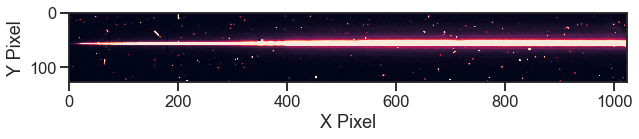

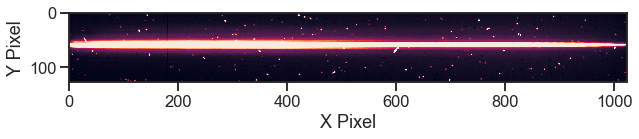

In [13]:
# check on one of the data frames (first part of data) - 430 first and then 750
plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][0])
im.set_clim(0,150)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,10))
im = plt.imshow(data_750[0][0])
im.set_clim(0,150)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [14]:
# initialize a list for and then create traces for each of the data frames
trace_list_430 = []
for i in data_430[0]:
    # trace wants xi, xf, and an initial y guess - these are numbers I just chose from some testing
    # it can be seen above this just corresponds to the strongest flux
    # this function is fast so you can test for yourself if these values don't work!
    trace = trace_spectrum(i, 100,1000,60)
    trace_list_430.append(trace)

trace_list_750 = []
for i in data_750[0]:
    # trace wants xi, xf, and an initial y guess - these are numbers I just chose from some testing
    # it can be seen above this just corresponds to the strongest flux
    # this function is fast so you can test for yourself if these values don't work!
    trace = trace_spectrum(i, 100,1000,60)
    trace_list_750.append(trace)

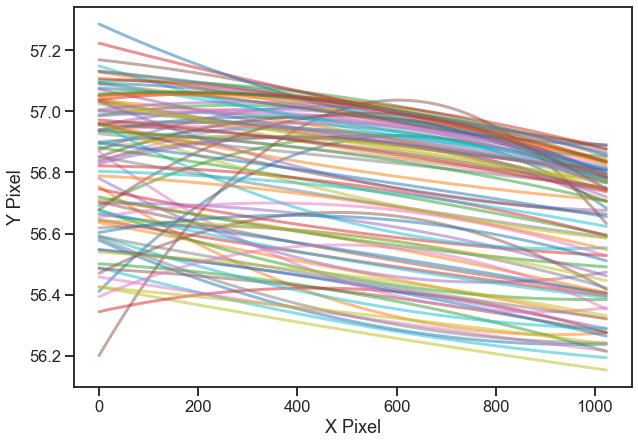

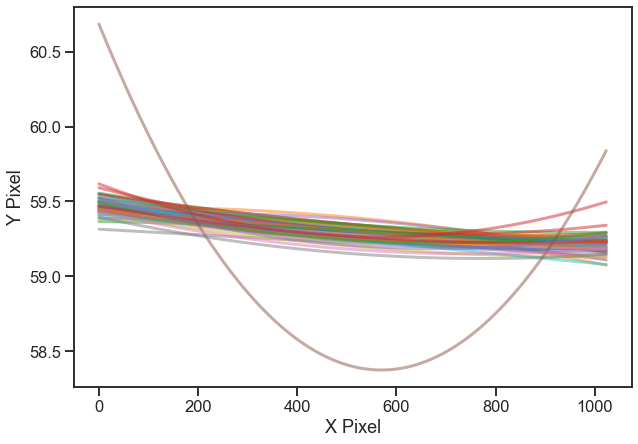

In [15]:
# fit a polynomial to the traces - I just use a second-order chebyshev
# and i fit it over the whole length of the data frame instead of just what was use for the fit
trace_fit_430 = []
plt.figure(figsize = (10,7))
for j in trace_list_430:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    # plotting just to check everything looks okay
    plt.plot(np.arange(len(data_430[0][0][0])),chebyshev.chebval(np.arange(len(data_430[0][0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(data_430[0][0][0])),chebyshev.chebval(np.arange(len(data_430[0][0][0])),coeffs1)]
    trace_fit_430.append(trace)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

# fit a polynomial to the traces - I just use a second-order chebyshev
# and i fit it over the whole length of the data frame instead of just what was use for the fit
trace_fit_750 = []
plt.figure(figsize = (10,7))
for j in trace_list_750:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    # plotting just to check everything looks okay
    plt.plot(np.arange(len(data_750[0][0][0])),chebyshev.chebval(np.arange(len(data_750[0][0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(data_750[0][0][0])),chebyshev.chebval(np.arange(len(data_750[0][0][0])),coeffs1)]
    trace_fit_750.append(trace)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

# there's maybe some outliers here, but this is just an initial trace to feed into the cleaning function
# so we don't worry about it - should subside once the cosmic rays are cleaned

In [16]:
# orbit lengths (the nonzero values of course)
data_430[5]

[0, 8, 0, 10, 0, 10, 0, 10, 0, 10, 0, 8, 0, 10, 0, 10, 0, 10, 0, 10, 0]

In [17]:
# now to clean the data - default is all steps on (dq, difference_correct, hc_correct, spline_correct)
# i'm breaking up the orbits manually here, not sure what the best way to do this automatically is yet
cleaned_1_430 = clean_data(data_430[0][:4], dqs = data_430[3][:4], traces = trace_fit_430[:4])
cleaned_2_430= clean_data(data_430[0][4:8], dqs = data_430[3][4:8], traces = trace_fit_430[3:7])

cleaned_3_430 = clean_data(data_430[0][8:12], dqs = data_430[3][8:12], traces = trace_fit_430[8:12])
cleaned_4_430 = clean_data(data_430[0][12:15], dqs = data_430[3][12:15], traces = trace_fit_430[12:15])
cleaned_5_430 = clean_data(data_430[0][15:18], dqs = data_430[3][15:18], traces = trace_fit_430[15:18])


cleaned_6_430 = clean_data(data_430[0][18:22], dqs = data_430[3][18:22], traces = trace_fit_430[18:22])
cleaned_7_430 = clean_data(data_430[0][22:25], dqs = data_430[3][22:25], traces = trace_fit_430[22:25])
cleaned_8_430 = clean_data(data_430[0][25:28], dqs = data_430[3][25:28], traces = trace_fit_430[25:28])

cleaned_9_430 = clean_data(data_430[0][28:32], dqs = data_430[3][28:32], traces = trace_fit_430[28:32])
cleaned_10_430 = clean_data(data_430[0][32:35], dqs = data_430[3][32:35], traces = trace_fit_430[32:35])
cleaned_11_430 = clean_data(data_430[0][35:38], dqs = data_430[3][35:38], traces = trace_fit_430[35:38])

cleaned_12_430 = clean_data(data_430[0][38:42], dqs = data_430[3][38:42], traces = trace_fit_430[38:42])
cleaned_13_430 = clean_data(data_430[0][42:45], dqs = data_430[3][42:45], traces = trace_fit_430[42:45])
cleaned_14_430 = clean_data(data_430[0][45:48], dqs = data_430[3][45:48], traces = trace_fit_430[45:48])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

In [18]:
cleaned_21_430 = clean_data(data_430[0][48:52], dqs = data_430[3][48:52], traces = trace_fit_430[48:52])
cleaned_22_430= clean_data(data_430[0][52:56], dqs = data_430[3][52:56], traces = trace_fit_430[52:56])

cleaned_23_430 = clean_data(data_430[0][56:60], dqs = data_430[3][56:60], traces = trace_fit_430[56:60])
cleaned_24_430 = clean_data(data_430[0][60:63], dqs = data_430[3][60:63], traces = trace_fit_430[60:63])
cleaned_25_430 = clean_data(data_430[0][63:66], dqs = data_430[3][63:66], traces = trace_fit_430[63:66])

cleaned_26_430 = clean_data(data_430[0][66:70], dqs = data_430[3][66:70], traces = trace_fit_430[66:70])
cleaned_27_430 = clean_data(data_430[0][70:73], dqs = data_430[3][70:73], traces = trace_fit_430[70:73])
cleaned_28_430 = clean_data(data_430[0][73:76], dqs = data_430[3][73:76], traces = trace_fit_430[73:76])

cleaned_29_430 = clean_data(data_430[0][76:80], dqs = data_430[3][76:80], traces = trace_fit_430[76:80])
cleaned_210_430 = clean_data(data_430[0][80:83], dqs = data_430[3][80:83], traces = trace_fit_430[80:83])
cleaned_211_430 = clean_data(data_430[0][83:86], dqs = data_430[3][83:86], traces = trace_fit_430[83:86])

cleaned_212_430 = clean_data(data_430[0][86:90], dqs = data_430[3][86:90], traces = trace_fit_430[86:90])
cleaned_213_430 = clean_data(data_430[0][90:93], dqs = data_430[3][90:93], traces = trace_fit_430[90:93])
cleaned_214_430 = clean_data(data_430[0][93:96], dqs = data_430[3][93:96], traces = trace_fit_430[93:96])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

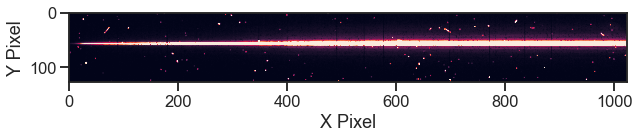

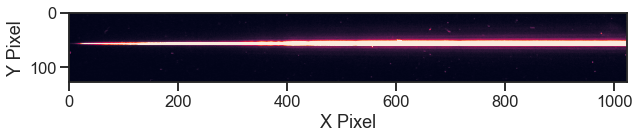

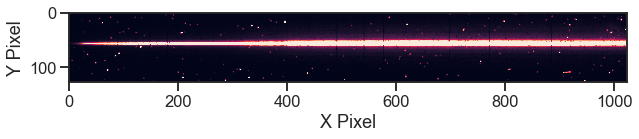

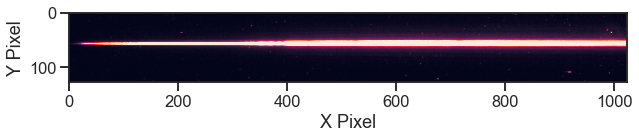

In [20]:
# comparison between the original and the cleaned image
# can easily see the lack of cosmic rays/bad pixels and removal of bad columns
plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][1])
im.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_1_430[1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][-1])
im.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_214_430[-1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [21]:
data_750[5]

[0, 8, 0, 10, 0, 10, 0, 10, 0, 10]

In [22]:
# now to clean the data - default is all steps on (dq, difference_correct, hc_correct, spline_correct)
# i'm breaking up the orbits manually here, not sure what the best way to do this automatically is yet
cleaned_1_750 = clean_data(data_750[0][:4], dqs = data_750[3][:4], traces = trace_fit_750[:4])
cleaned_2_750= clean_data(data_750[0][4:8], dqs = data_750[3][4:8], traces = trace_fit_750[3:7])

cleaned_3_750 = clean_data(data_750[0][8:12], dqs = data_750[3][8:12], traces = trace_fit_750[8:12])
cleaned_4_750 = clean_data(data_750[0][12:15], dqs = data_750[3][12:15], traces = trace_fit_750[12:15])
cleaned_5_750 = clean_data(data_750[0][15:18], dqs = data_750[3][15:18], traces = trace_fit_750[15:18])

cleaned_6_750 = clean_data(data_750[0][18:22], dqs = data_750[3][18:22], traces = trace_fit_750[18:22])
cleaned_7_750 = clean_data(data_750[0][22:25], dqs = data_750[3][22:25], traces = trace_fit_750[22:25])
cleaned_8_750 = clean_data(data_750[0][25:28], dqs = data_750[3][25:28], traces = trace_fit_750[25:28])

cleaned_9_750 = clean_data(data_750[0][28:32], dqs = data_750[3][28:32], traces = trace_fit_750[28:32])
cleaned_10_750 = clean_data(data_750[0][32:35], dqs = data_750[3][32:35], traces = trace_fit_750[32:35])
cleaned_11_750 = clean_data(data_750[0][35:38], dqs = data_750[3][35:38], traces = trace_fit_750[35:38])

cleaned_12_750 = clean_data(data_750[0][38:42], dqs = data_750[3][38:42], traces = trace_fit_750[38:42])
cleaned_13_750 = clean_data(data_750[0][42:45], dqs = data_750[3][42:45], traces = trace_fit_750[42:45])
cleaned_14_750 = clean_data(data_750[0][45:48], dqs = data_750[3][45:48], traces = trace_fit_750[45:48])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

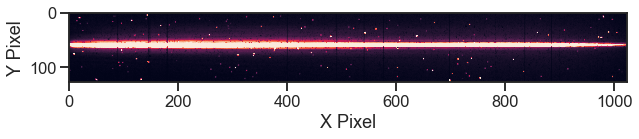

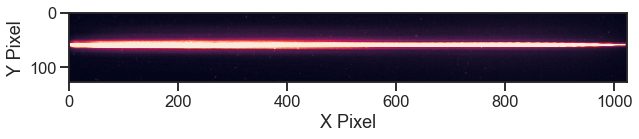

In [23]:
plt.figure(figsize = (10,10))
cim = plt.imshow(data_750[0][1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_1_750[1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [24]:
# just putting all of the cleaned files into one list
transit_750_cleaned = [*cleaned_1_750, *cleaned_2_750, *cleaned_3_750, *cleaned_4_750, *cleaned_5_750, *cleaned_6_750, *cleaned_7_750, *cleaned_8_750, *cleaned_9_750, *cleaned_10_750, *cleaned_11_750, *cleaned_12_750, *cleaned_13_750, *cleaned_14_750]
transit_430_cleaned = [*cleaned_1_430, *cleaned_2_430, *cleaned_3_430, *cleaned_4_430, *cleaned_5_430, *cleaned_6_430, *cleaned_7_430, *cleaned_8_430, *cleaned_9_430, *cleaned_10_430, *cleaned_11_430, *cleaned_12_430, *cleaned_13_430, *cleaned_14_430]
transit_430_2_cleaned = [*cleaned_21_430, *cleaned_22_430, *cleaned_23_430, *cleaned_24_430, *cleaned_25_430, *cleaned_26_430, *cleaned_27_430, *cleaned_28_430, *cleaned_29_430, *cleaned_210_430, *cleaned_211_430, *cleaned_212_430, *cleaned_213_430, *cleaned_214_430]

Frame 0


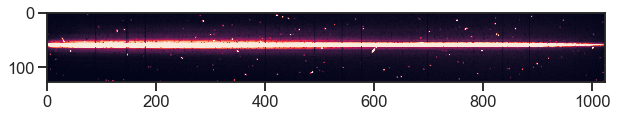

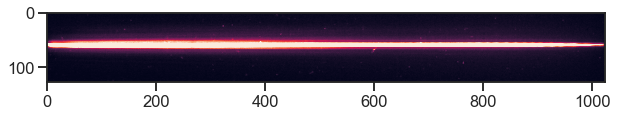

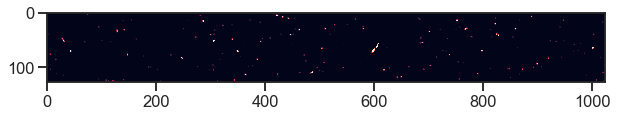

Frame 1


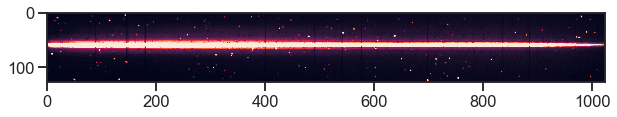

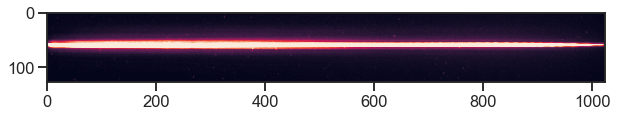

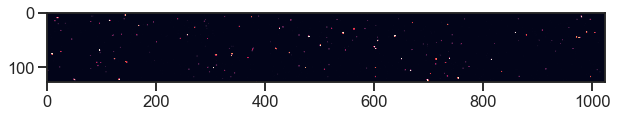

Frame 2


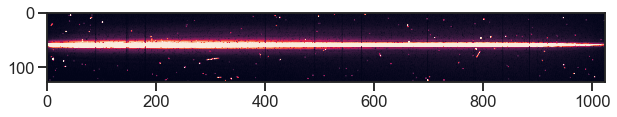

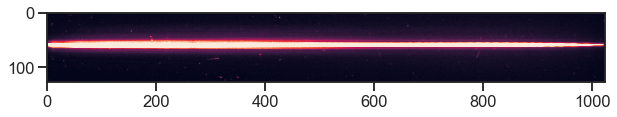

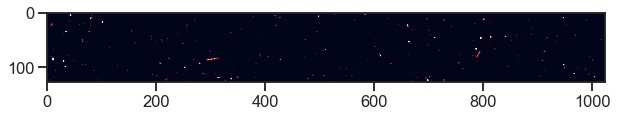

Frame 3


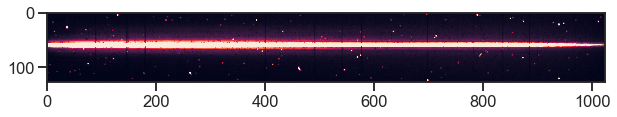

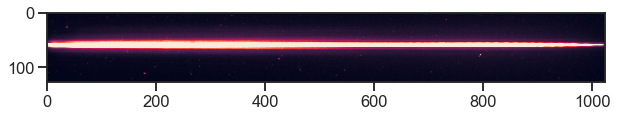

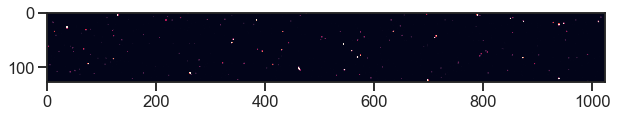

Frame 4


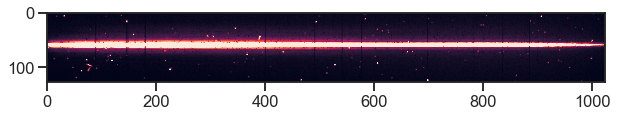

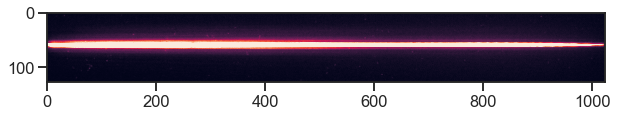

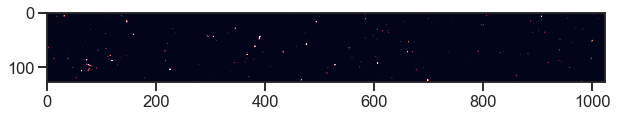

Frame 5


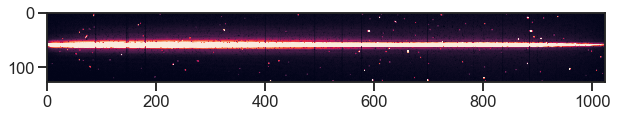

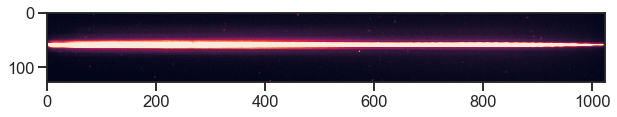

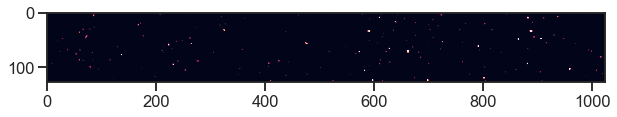

Frame 6


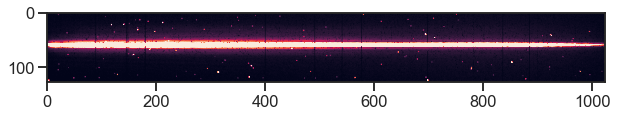

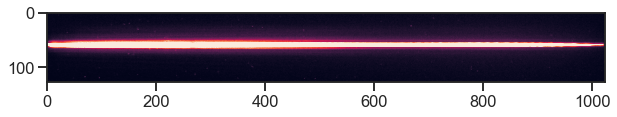

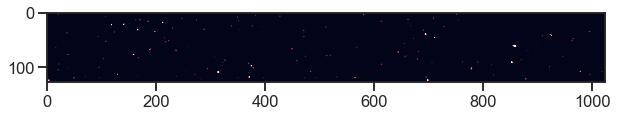

Frame 7


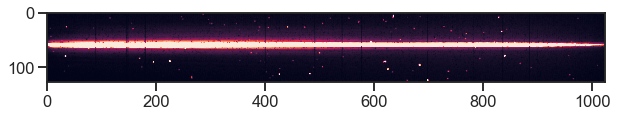

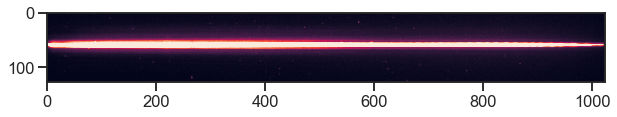

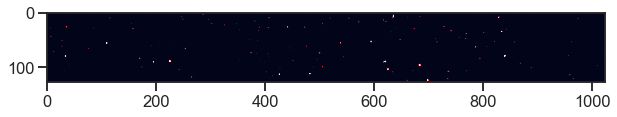

Frame 8


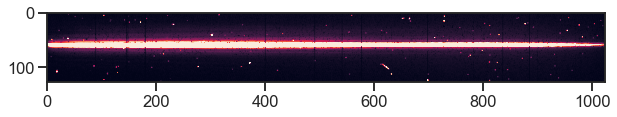

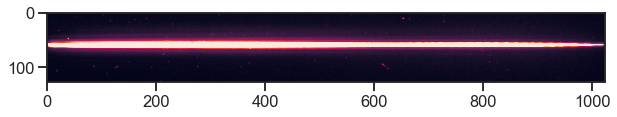

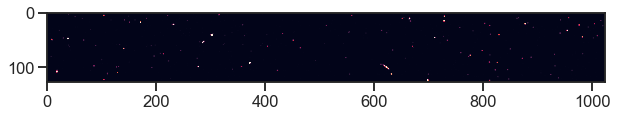

Frame 9


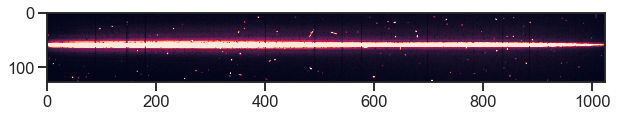

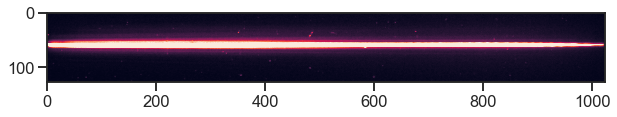

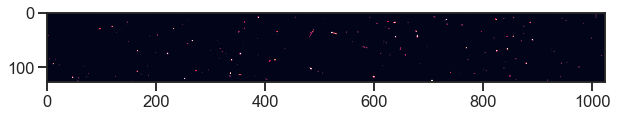

Frame 10


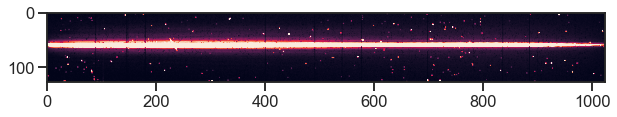

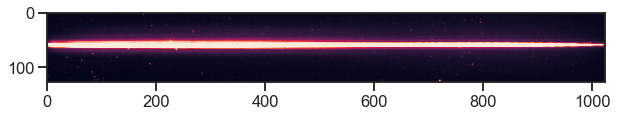

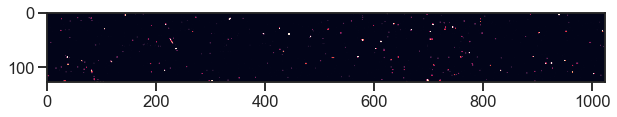

Frame 11


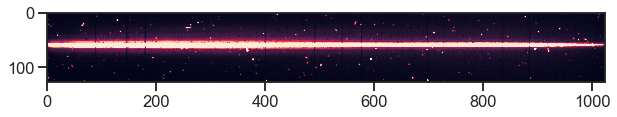

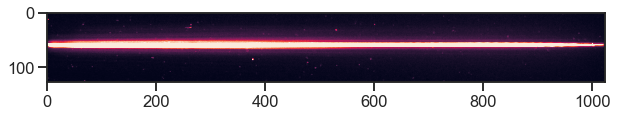

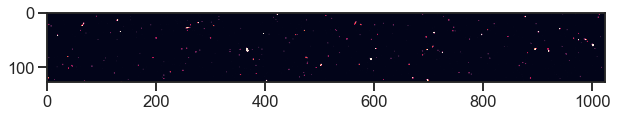

Frame 12


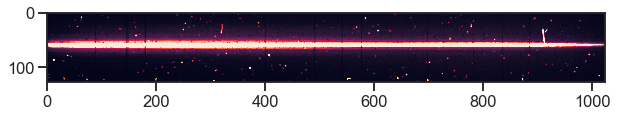

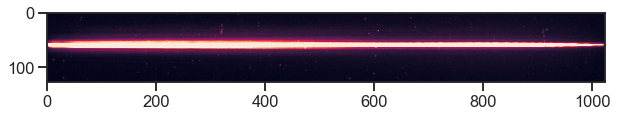

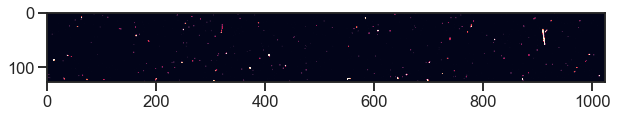

Frame 13


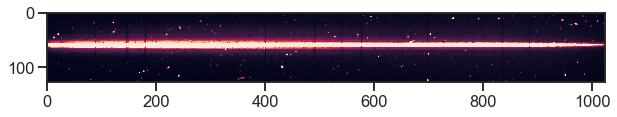

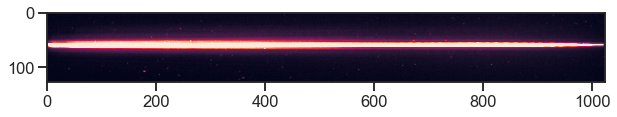

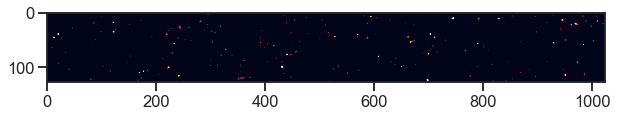

Frame 14


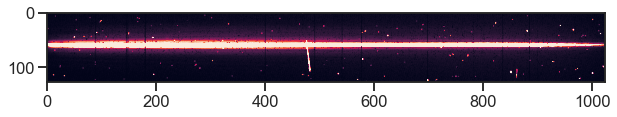

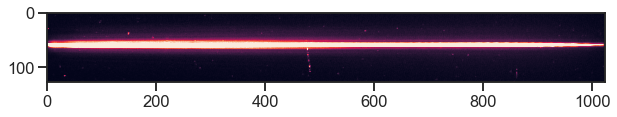

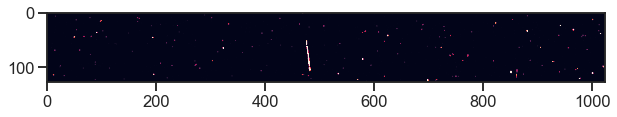

Frame 15


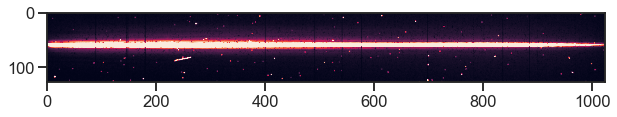

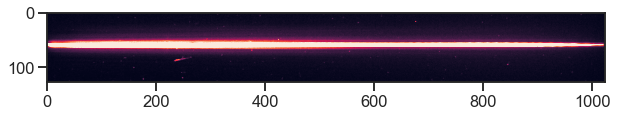

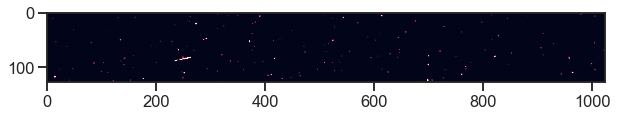

Frame 16


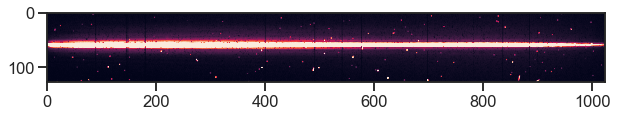

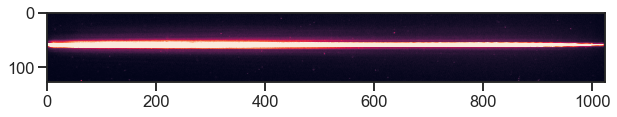

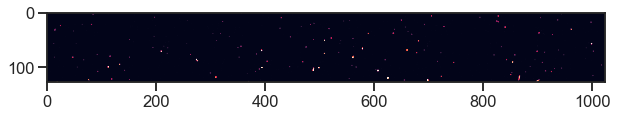

Frame 17


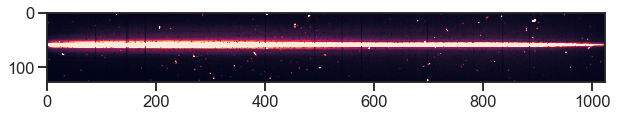

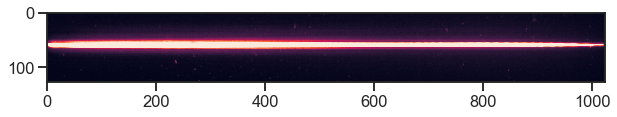

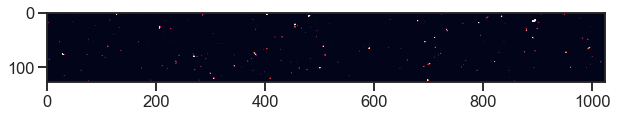

Frame 18


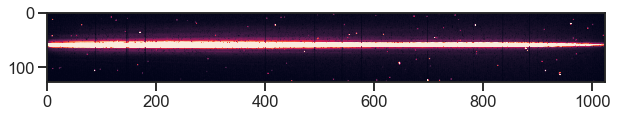

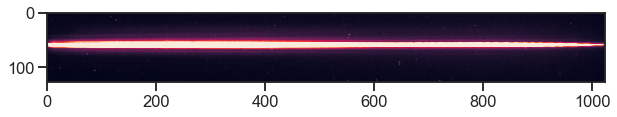

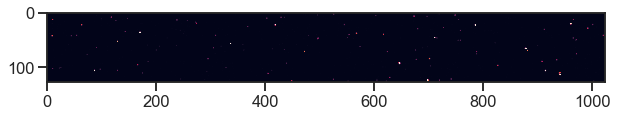

Frame 19


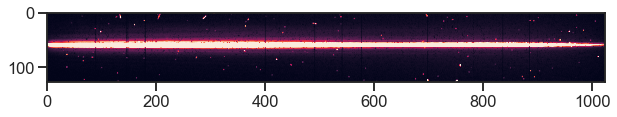

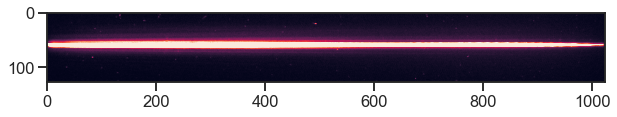

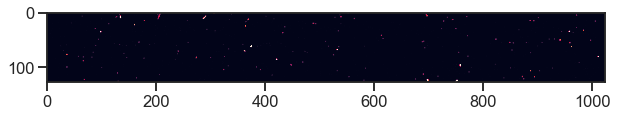

Frame 20


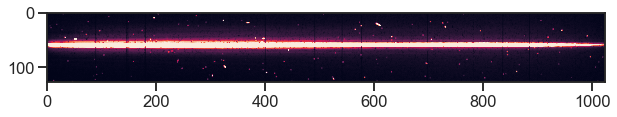

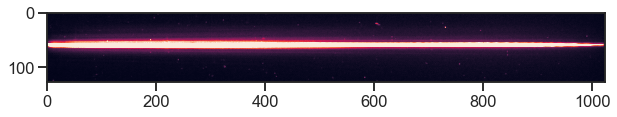

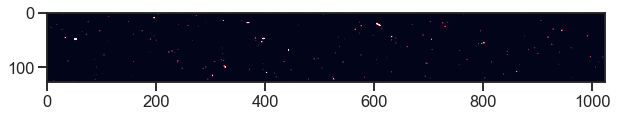

Frame 21


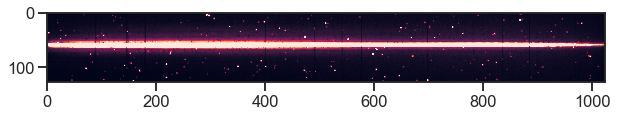

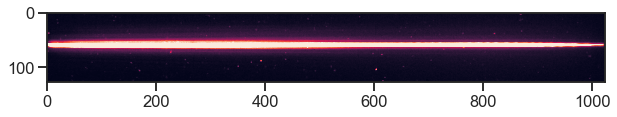

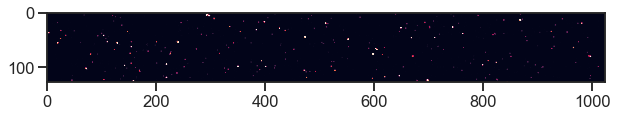

Frame 22


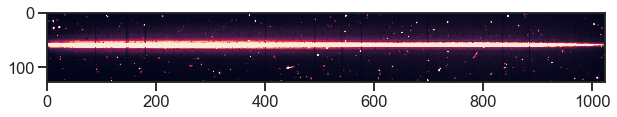

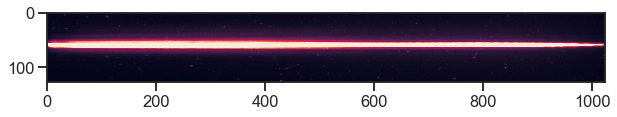

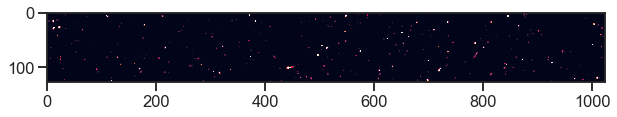

Frame 23


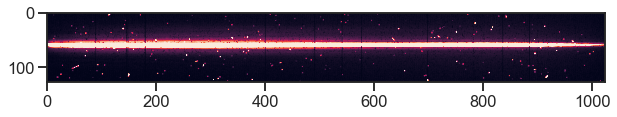

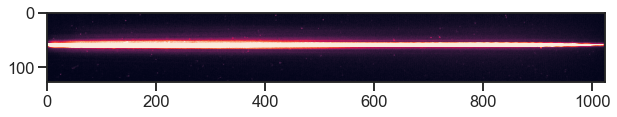

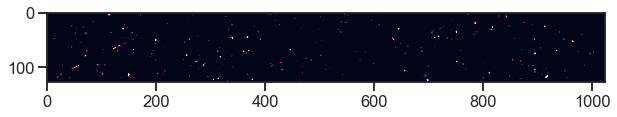

Frame 24


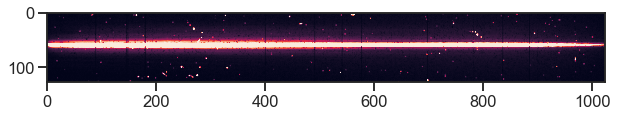

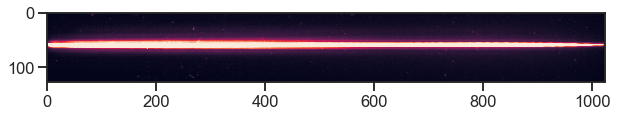

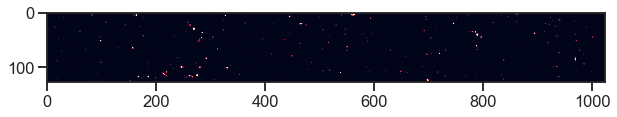

Frame 25


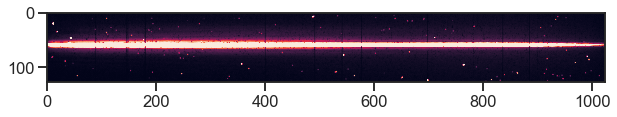

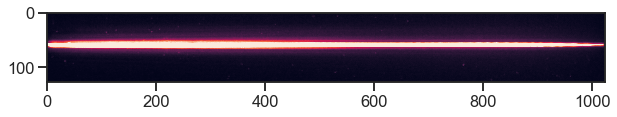

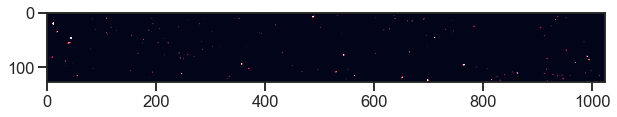

Frame 26


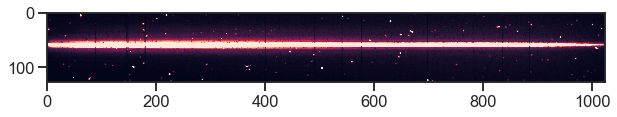

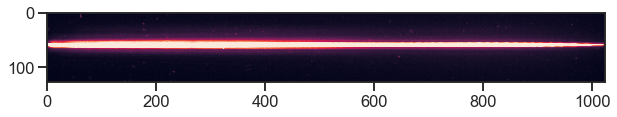

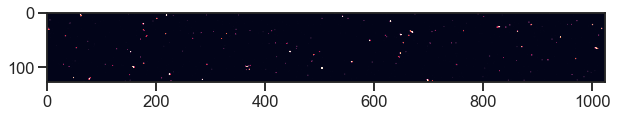

Frame 27


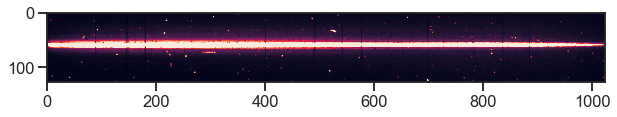

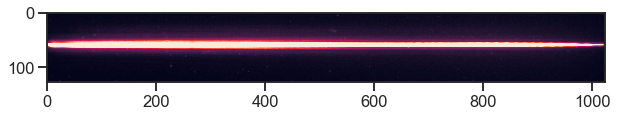

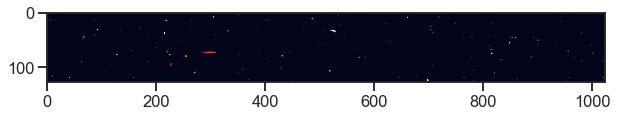

Frame 28


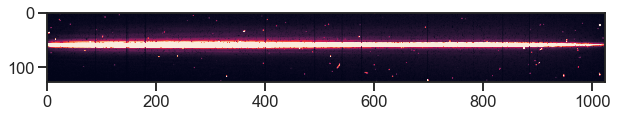

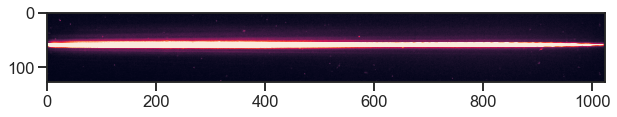

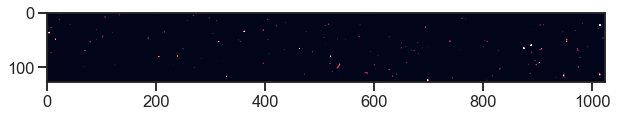

Frame 29


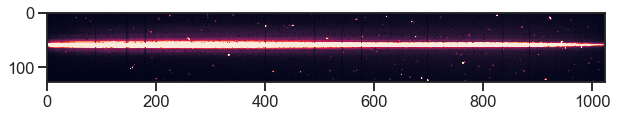

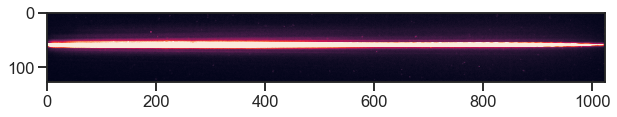

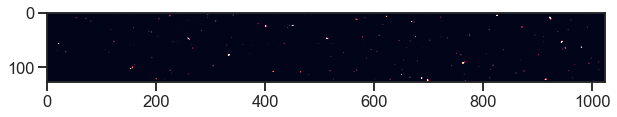

Frame 30


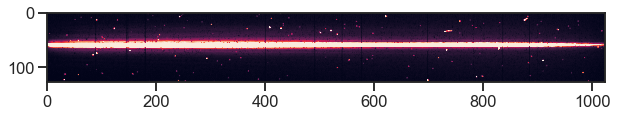

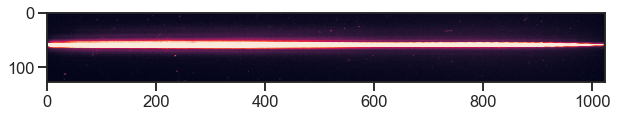

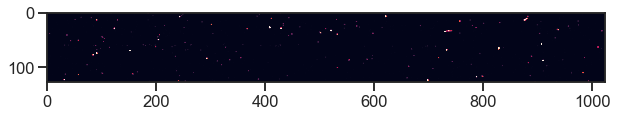

Frame 31


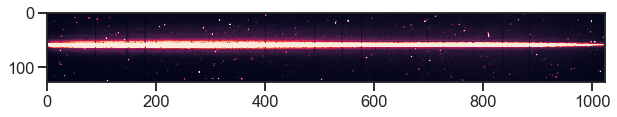

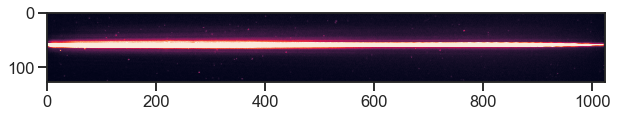

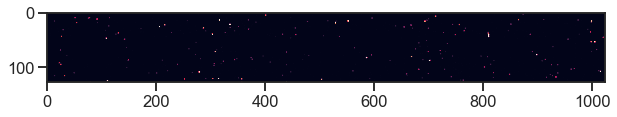

Frame 32


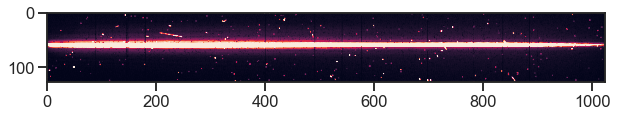

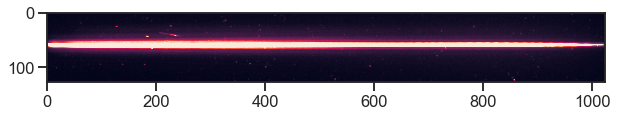

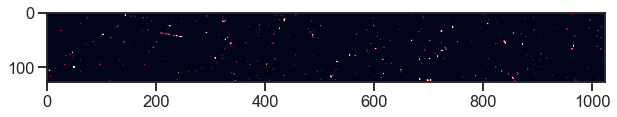

Frame 33


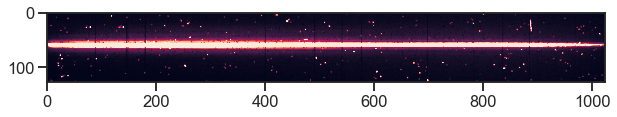

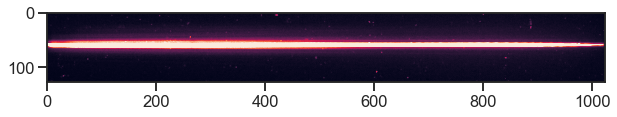

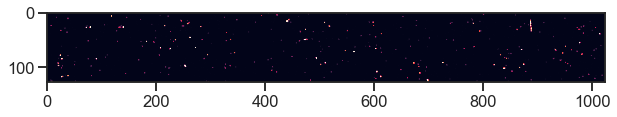

Frame 34


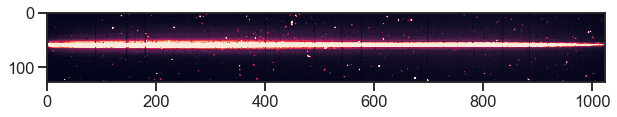

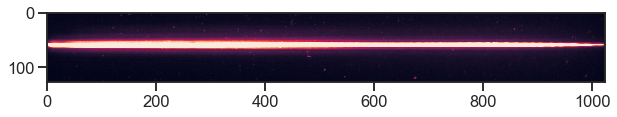

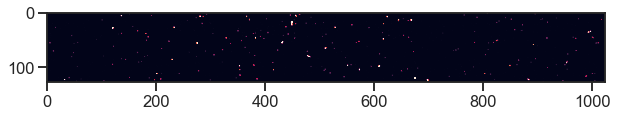

Frame 35


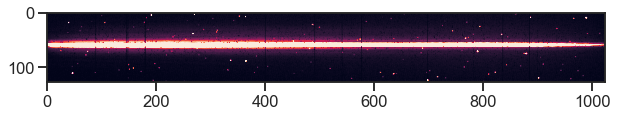

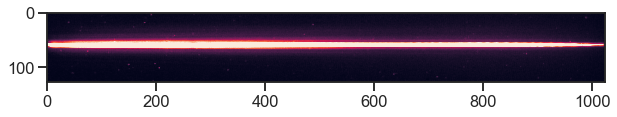

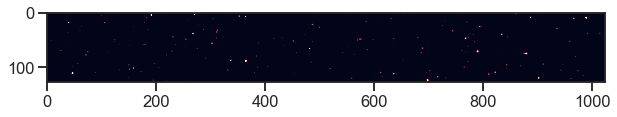

Frame 36


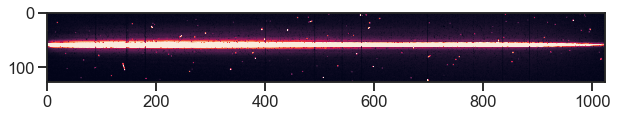

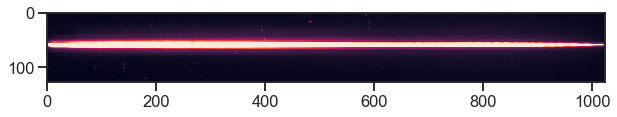

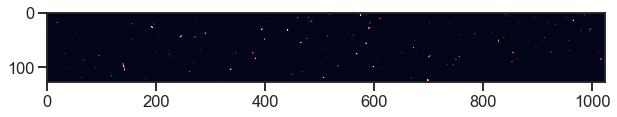

Frame 37


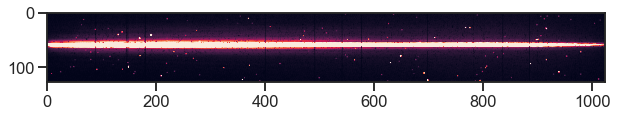

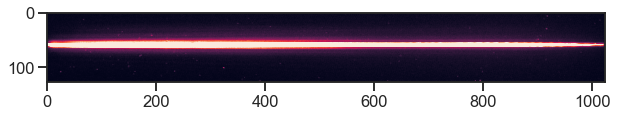

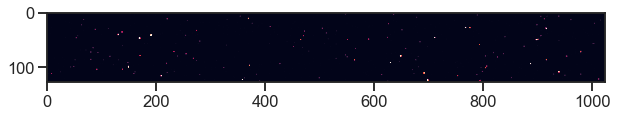

Frame 38


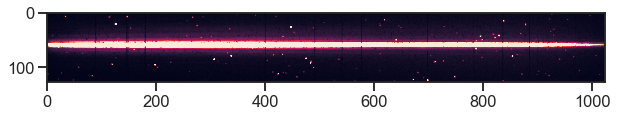

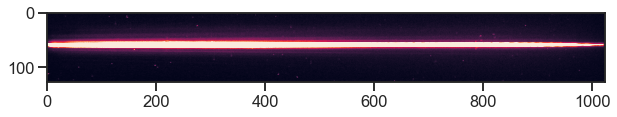

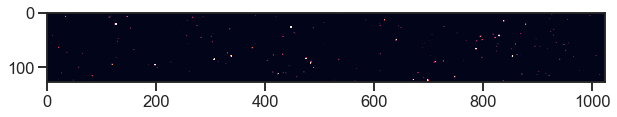

Frame 39


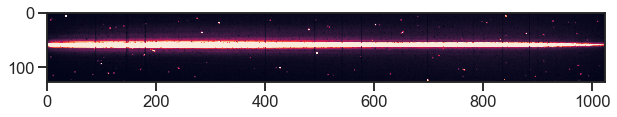

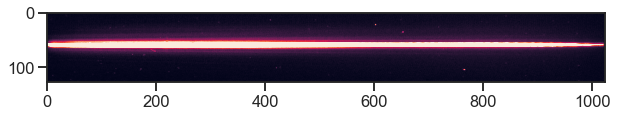

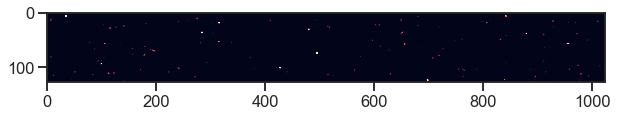

Frame 40


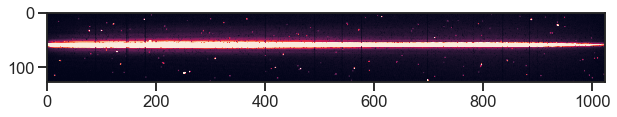

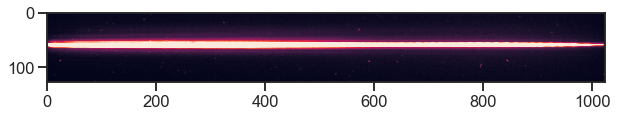

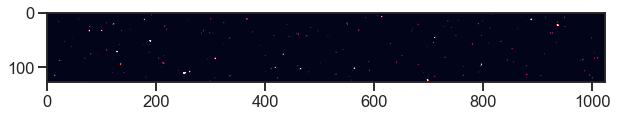

Frame 41


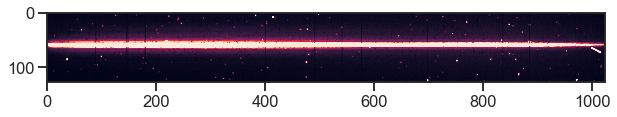

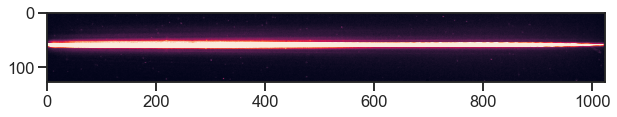

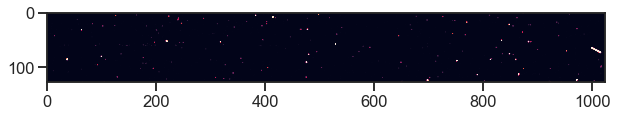

Frame 42


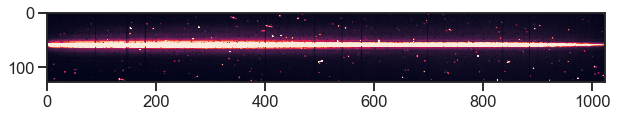

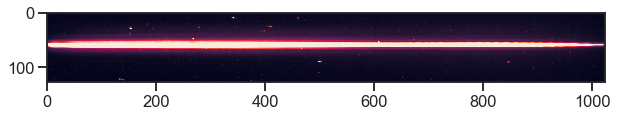

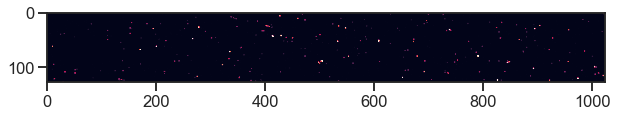

Frame 43


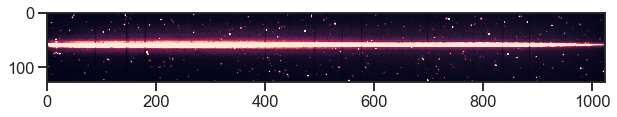

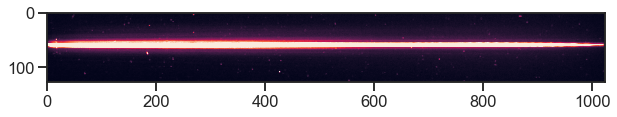

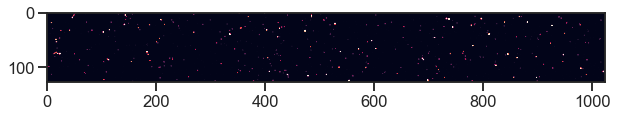

Frame 44


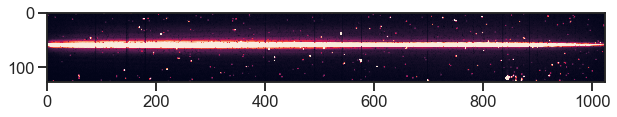

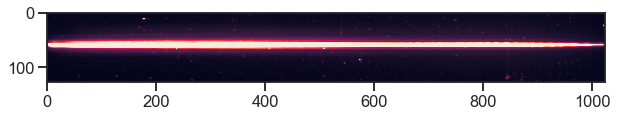

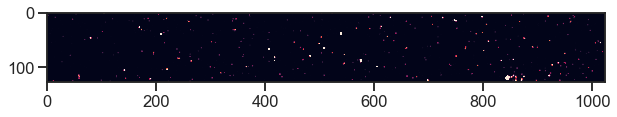

Frame 45


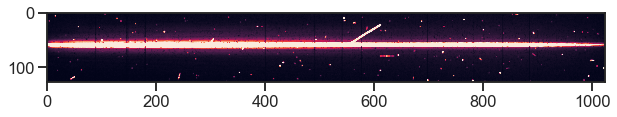

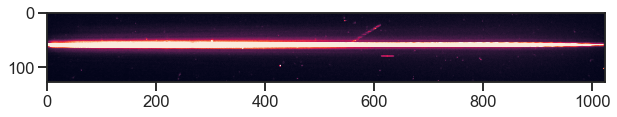

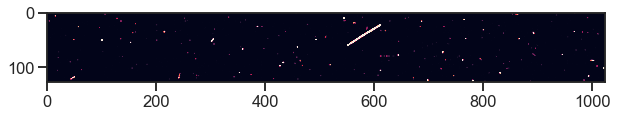

Frame 46


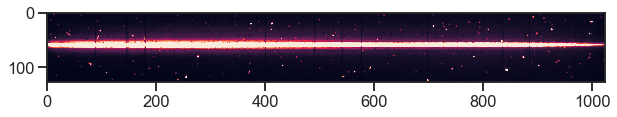

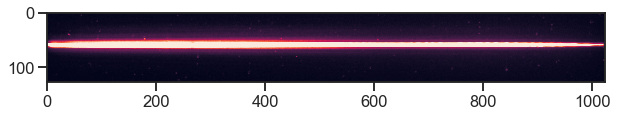

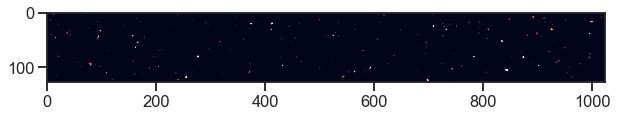

Frame 47


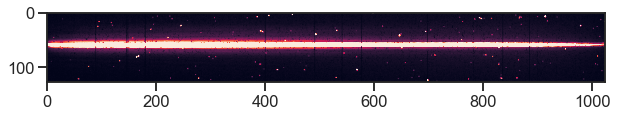

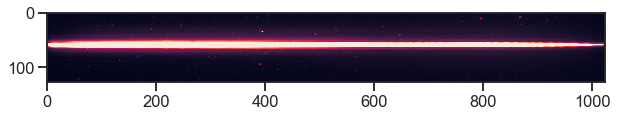

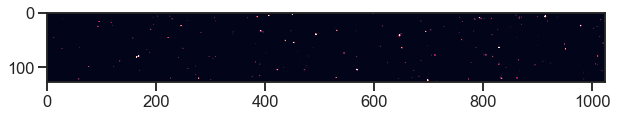

In [25]:
# let's look at the 750 data
for i in range(len(transit_750_cleaned)):
    print("Frame", i)
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_750[0][i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(transit_750_cleaned[i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_750[0][i]-transit_750_cleaned[i])
    im.set_clim(0,200)
    plt.show()
        

Frame 0


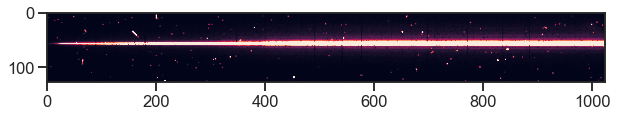

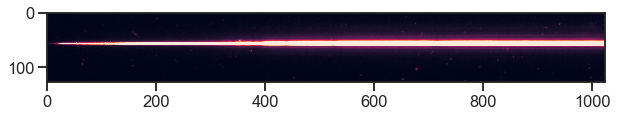

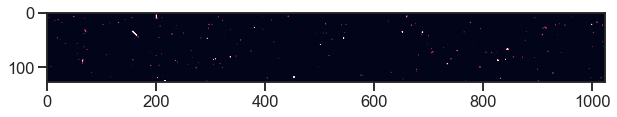

Frame 1


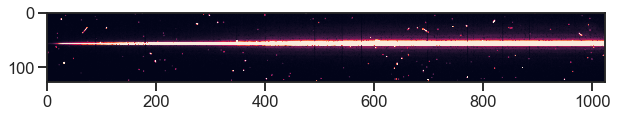

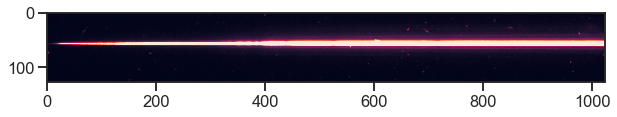

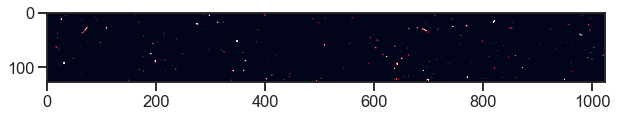

Frame 2


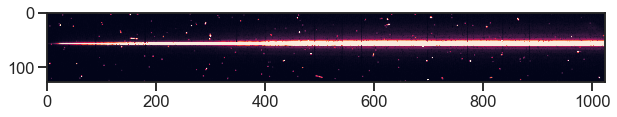

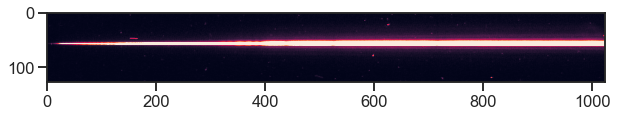

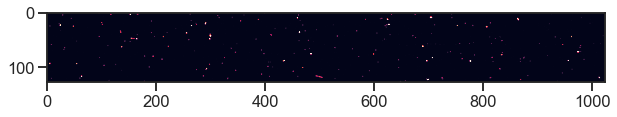

Frame 3


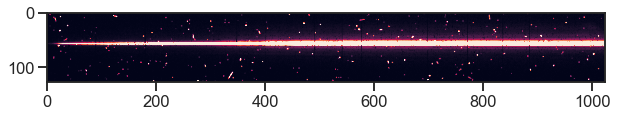

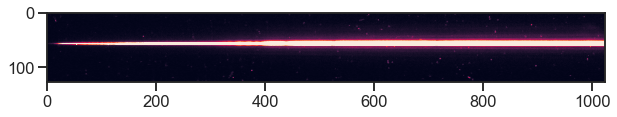

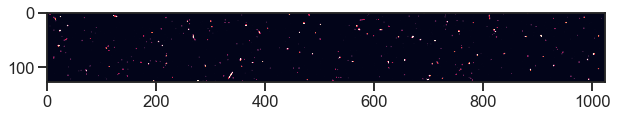

Frame 4


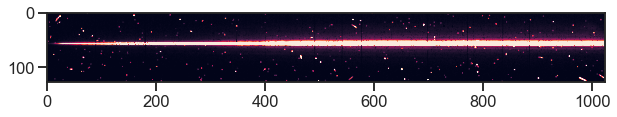

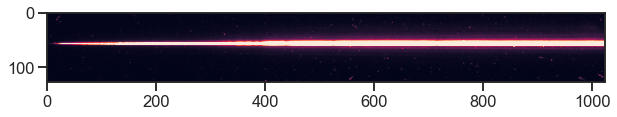

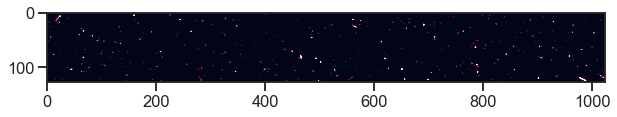

Frame 5


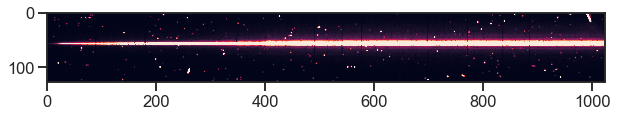

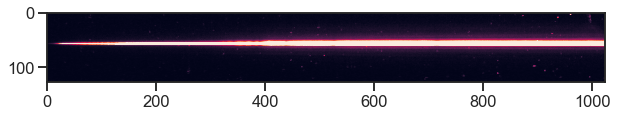

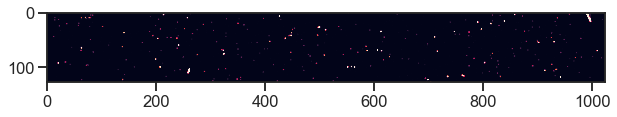

Frame 6


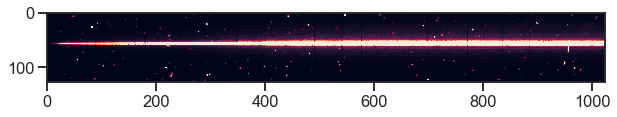

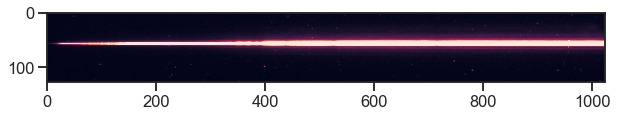

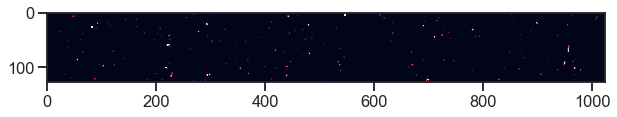

Frame 7


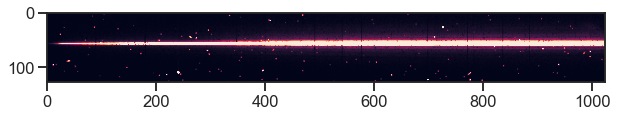

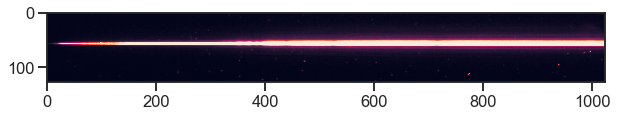

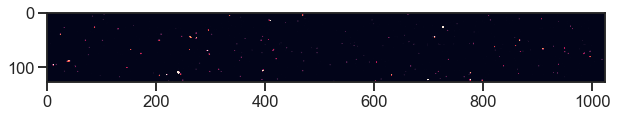

Frame 8


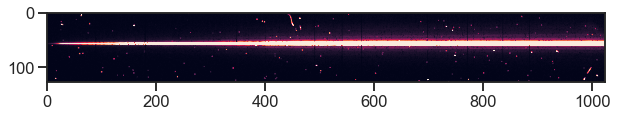

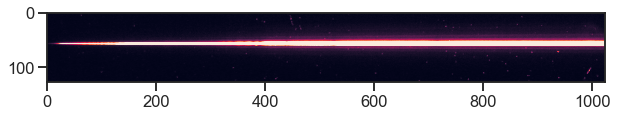

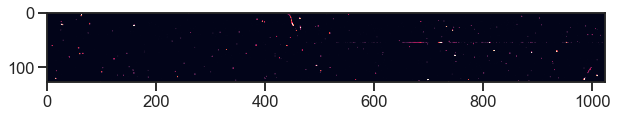

Frame 9


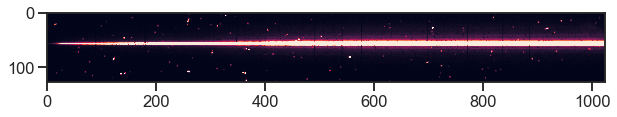

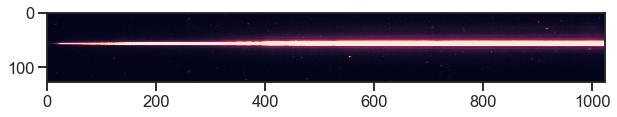

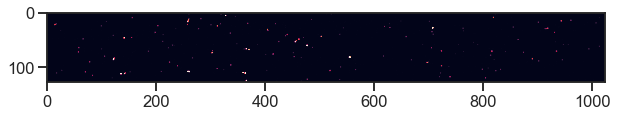

Frame 10


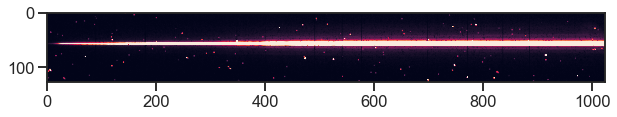

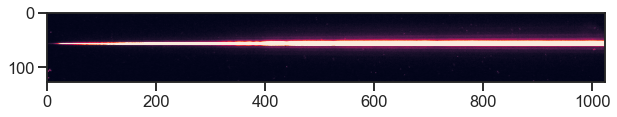

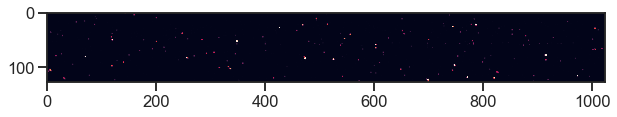

Frame 11


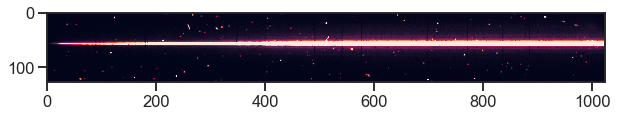

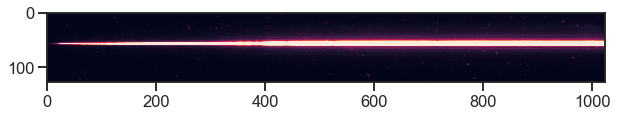

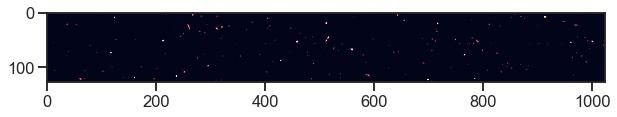

Frame 12


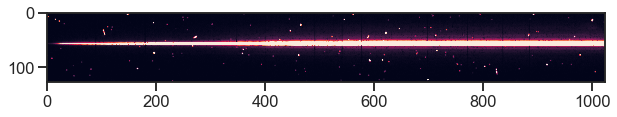

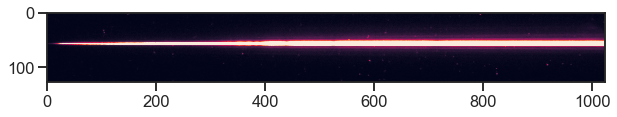

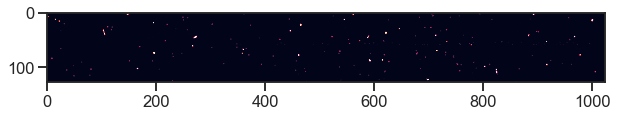

Frame 13


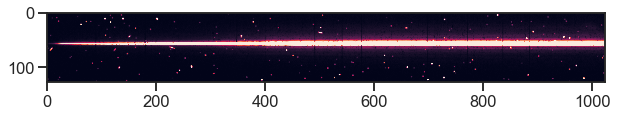

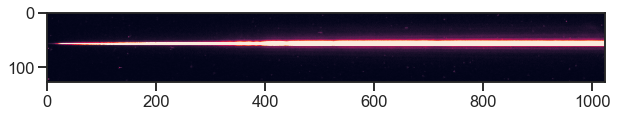

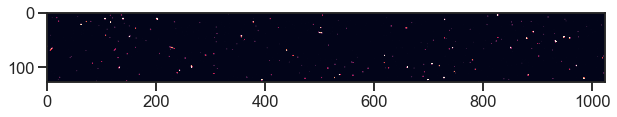

Frame 14


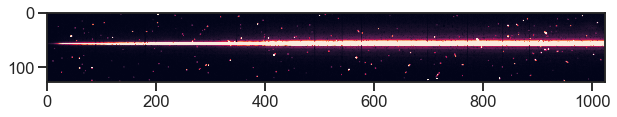

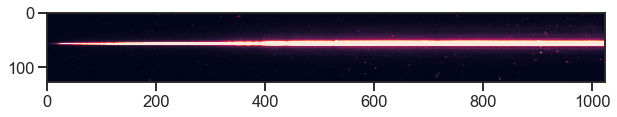

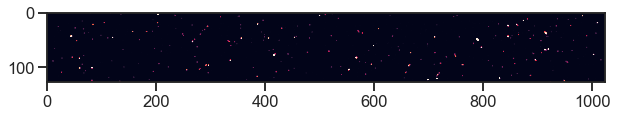

Frame 15


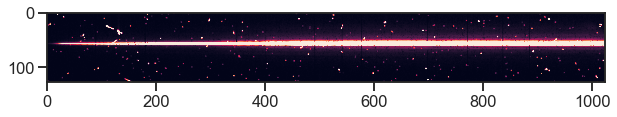

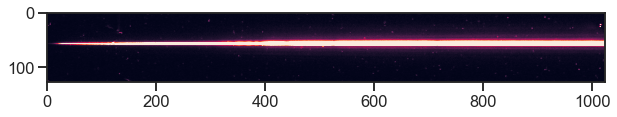

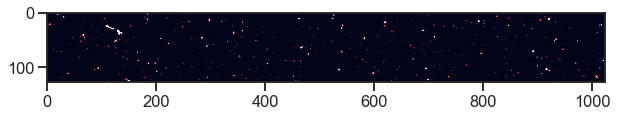

Frame 16


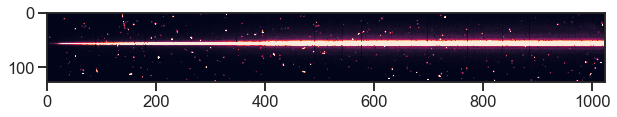

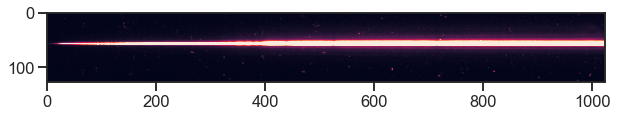

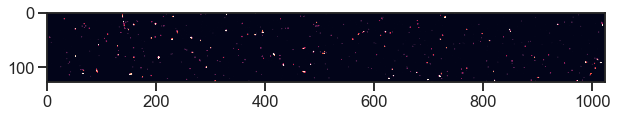

Frame 17


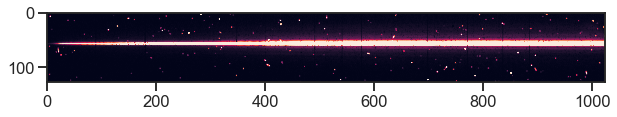

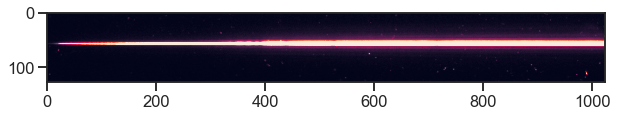

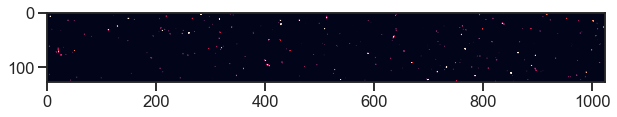

Frame 18


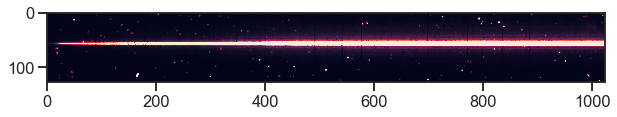

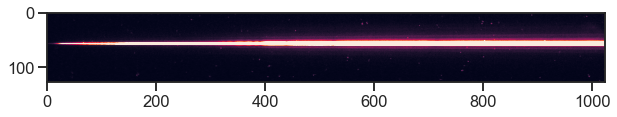

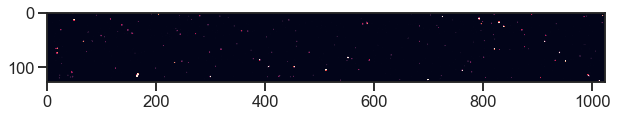

Frame 19


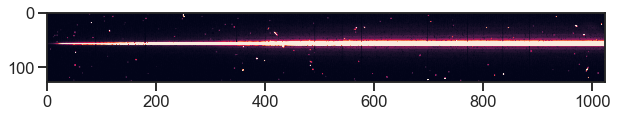

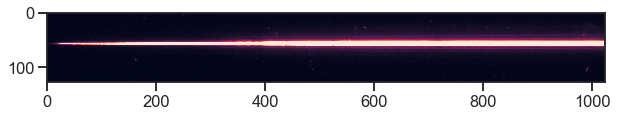

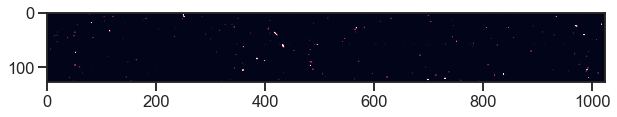

Frame 20


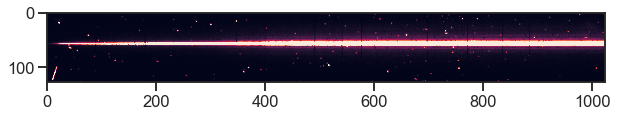

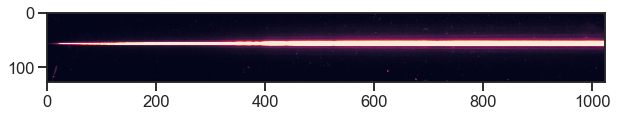

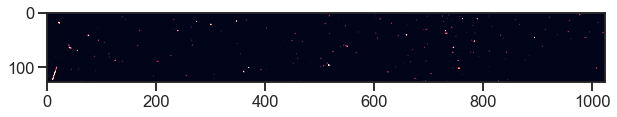

Frame 21


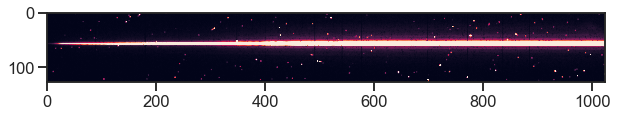

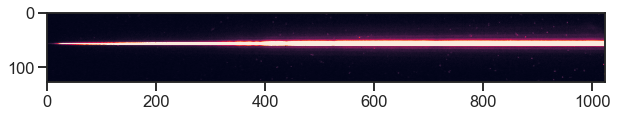

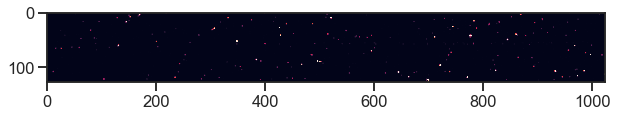

Frame 22


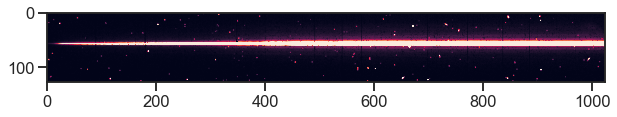

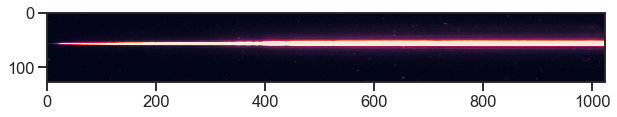

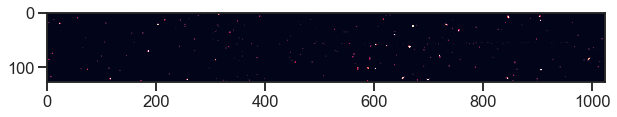

Frame 23


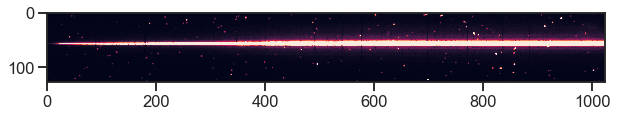

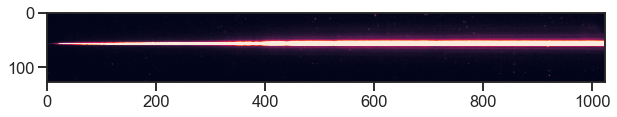

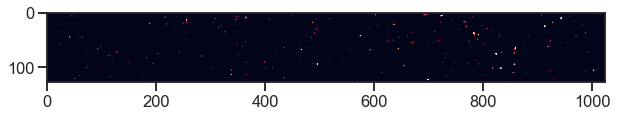

Frame 24


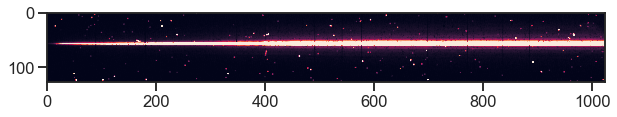

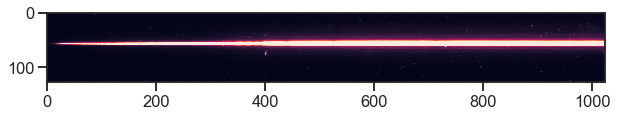

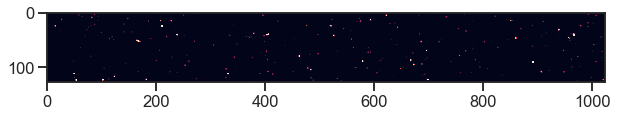

Frame 25


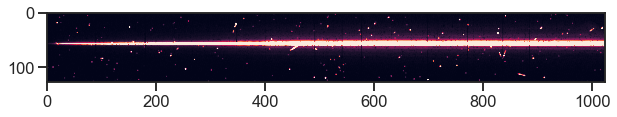

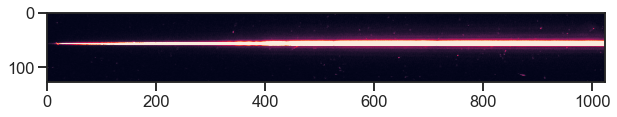

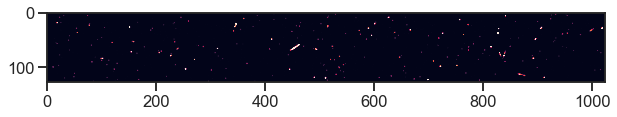

Frame 26


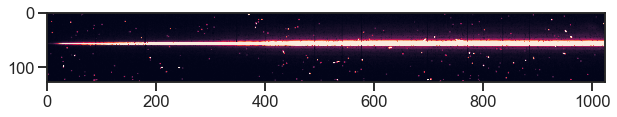

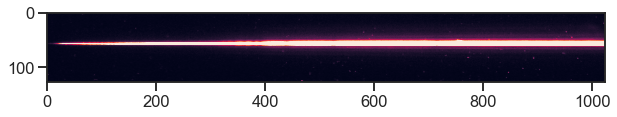

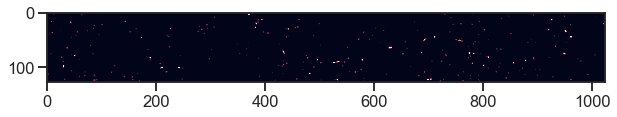

Frame 27


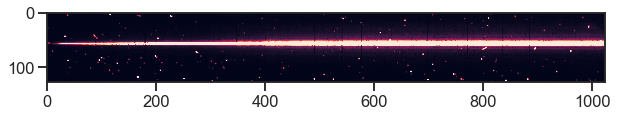

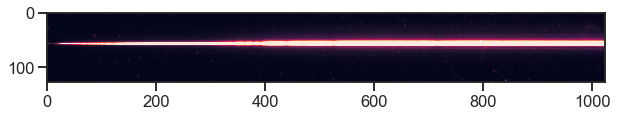

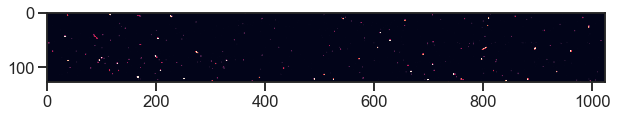

Frame 28


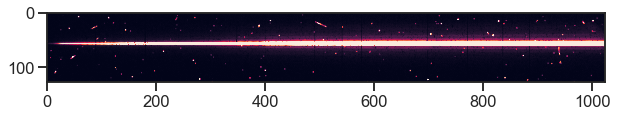

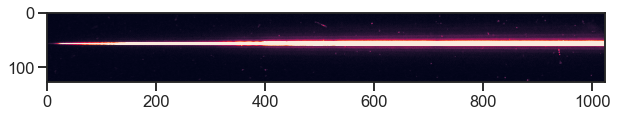

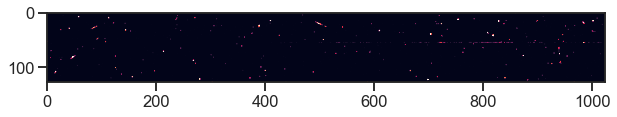

Frame 29


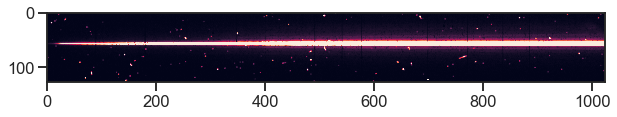

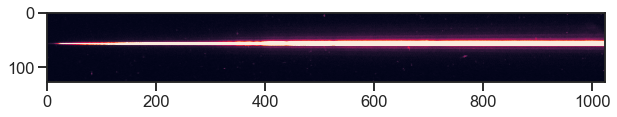

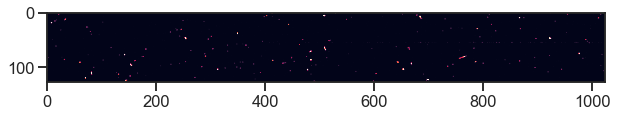

Frame 30


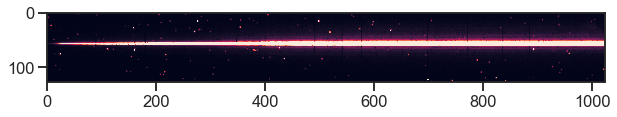

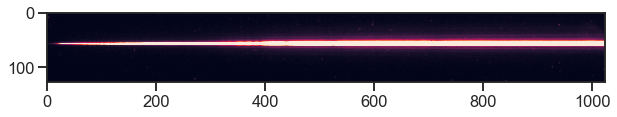

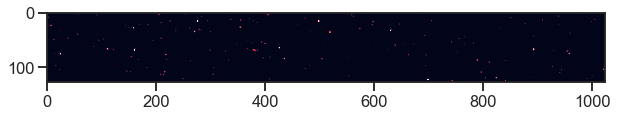

Frame 31


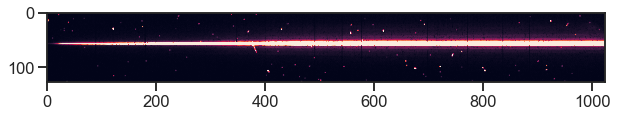

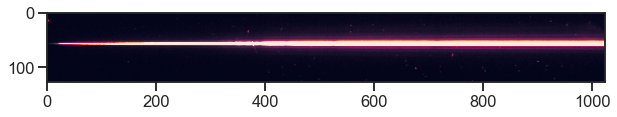

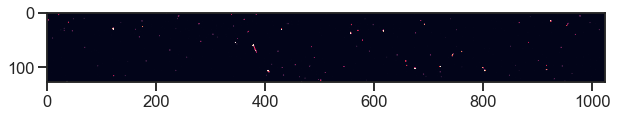

Frame 32


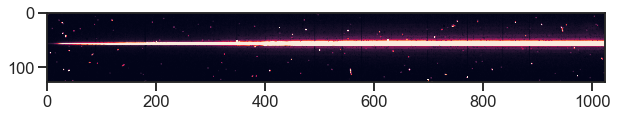

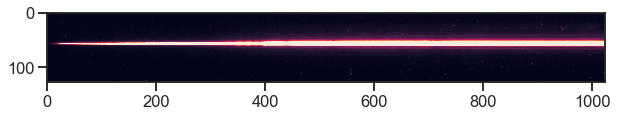

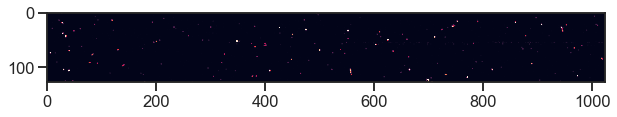

Frame 33


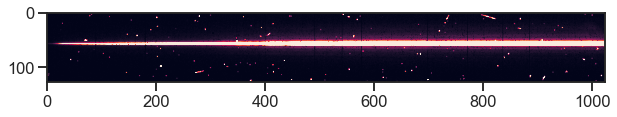

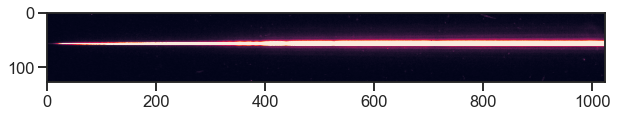

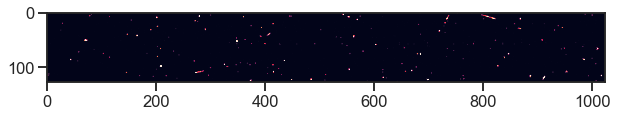

Frame 34


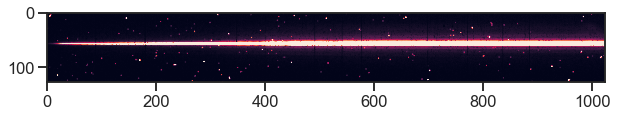

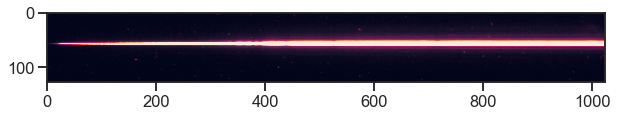

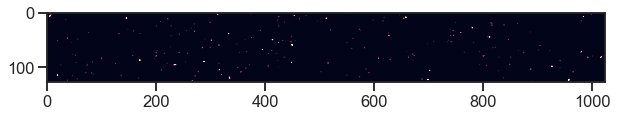

Frame 35


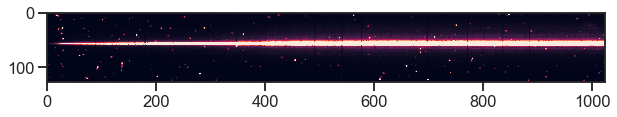

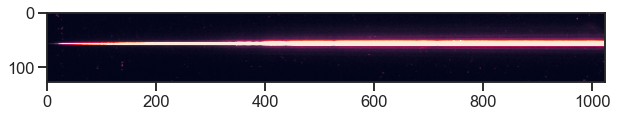

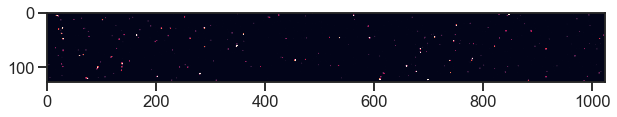

Frame 36


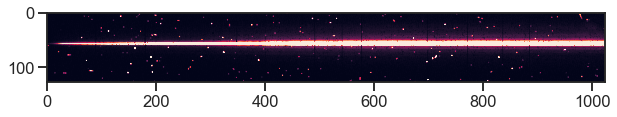

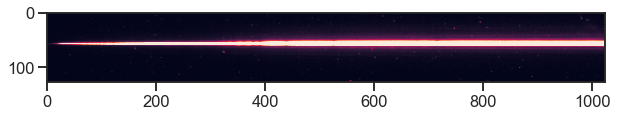

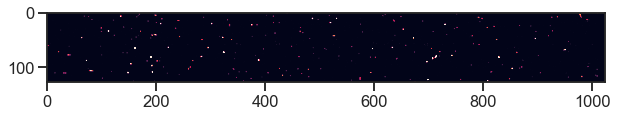

Frame 37


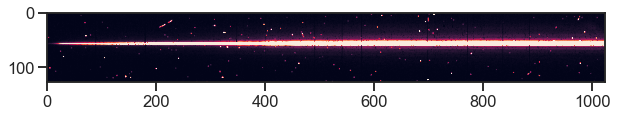

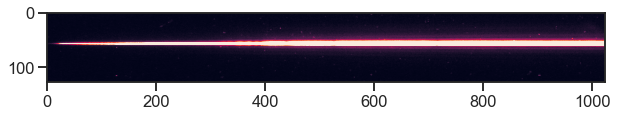

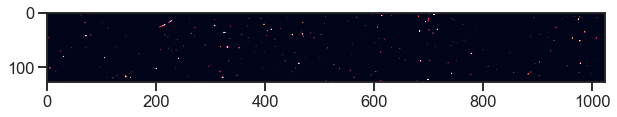

Frame 38


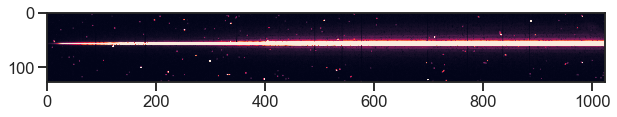

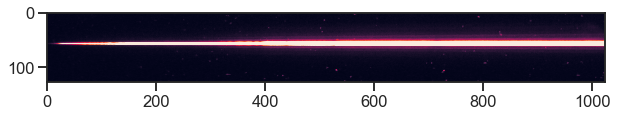

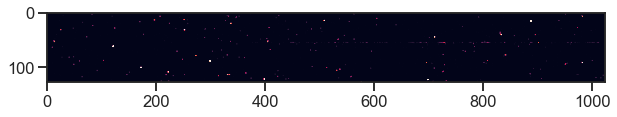

Frame 39


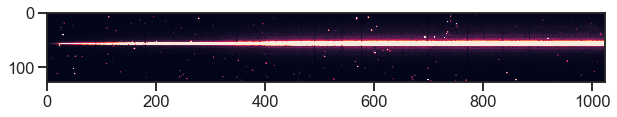

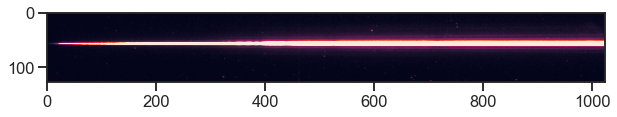

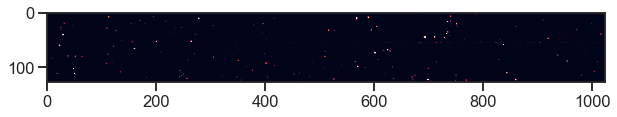

Frame 40


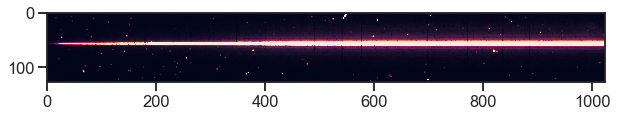

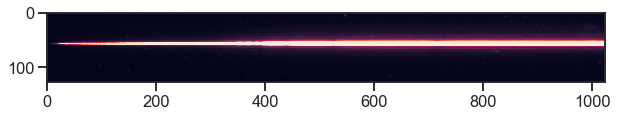

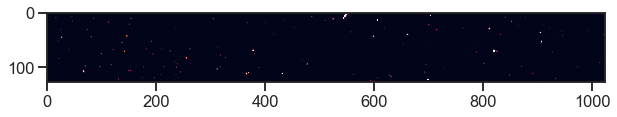

Frame 41


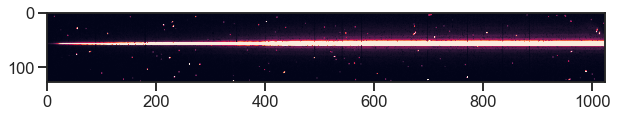

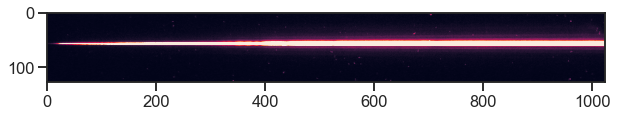

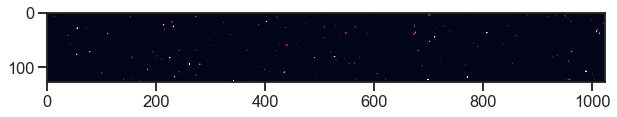

Frame 42


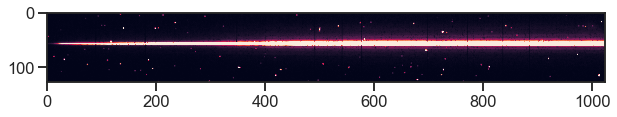

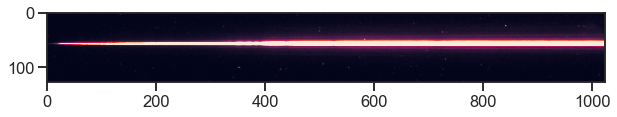

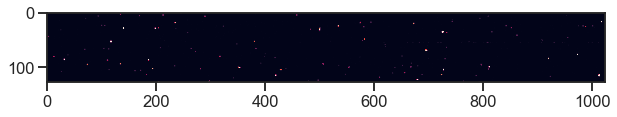

Frame 43


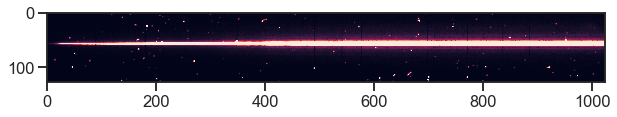

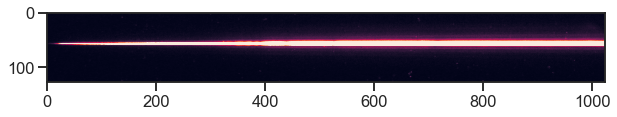

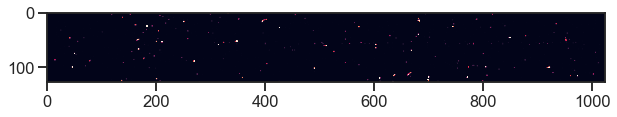

Frame 44


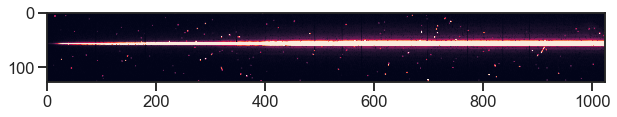

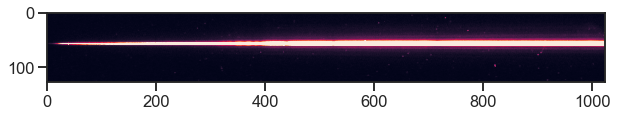

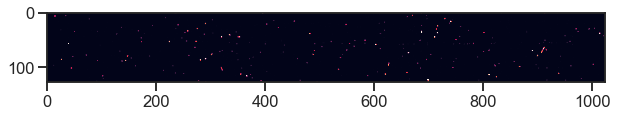

Frame 45


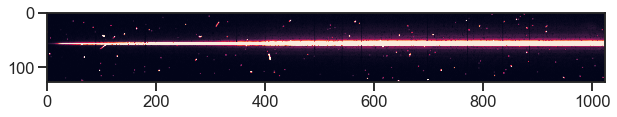

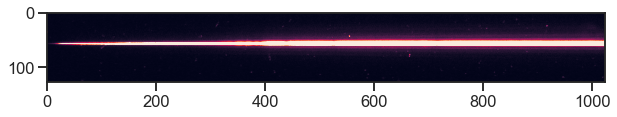

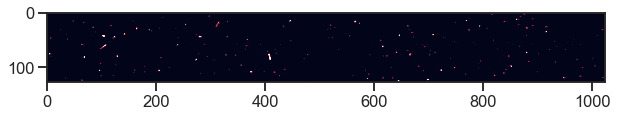

Frame 46


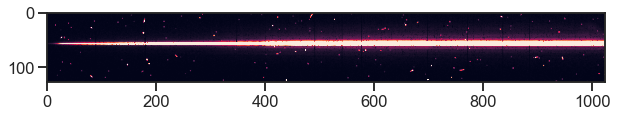

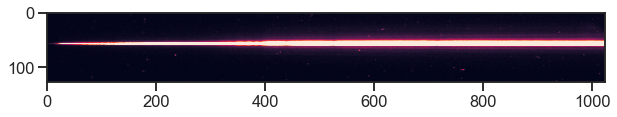

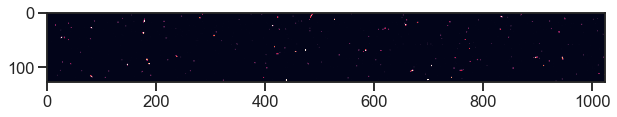

Frame 47


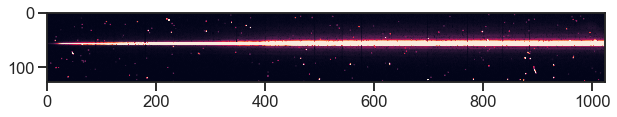

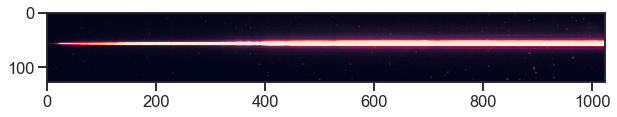

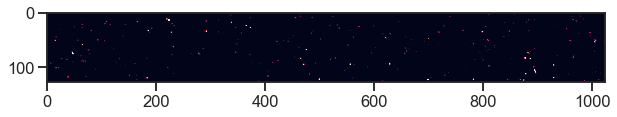

Frame 48


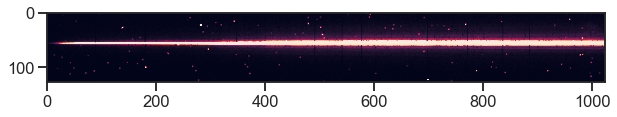

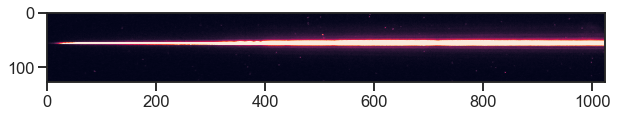

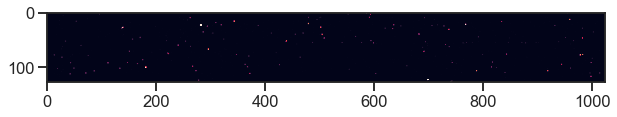

Frame 49


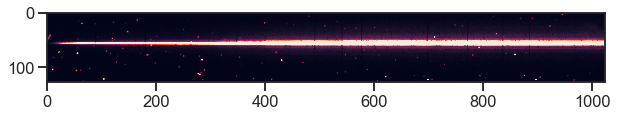

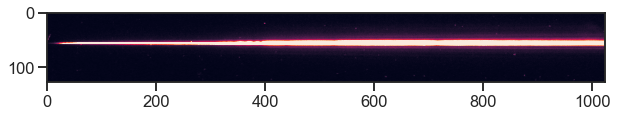

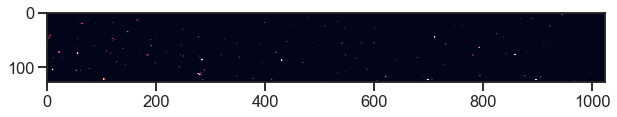

Frame 50


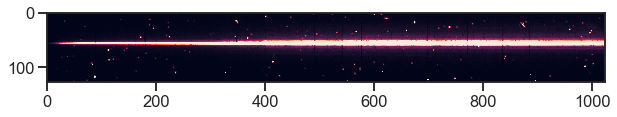

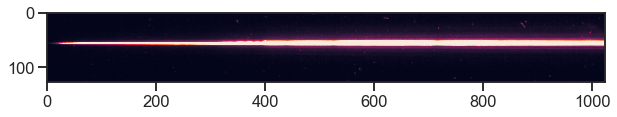

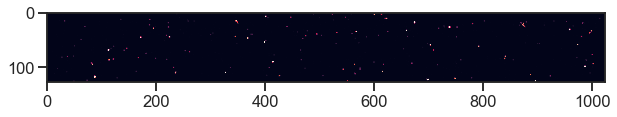

Frame 51


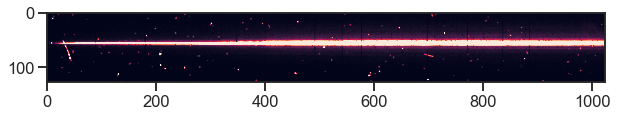

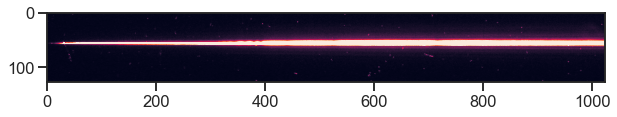

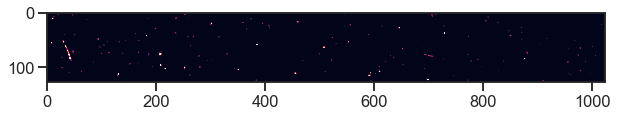

Frame 52


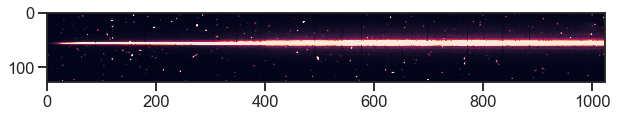

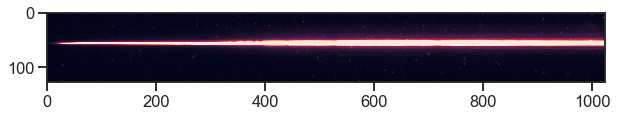

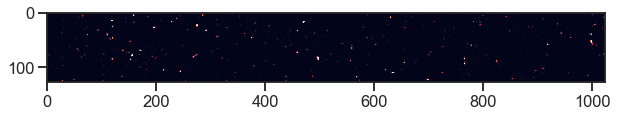

Frame 53


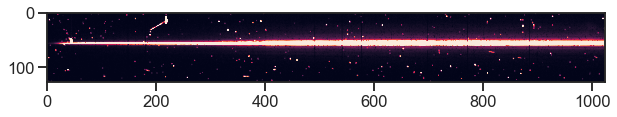

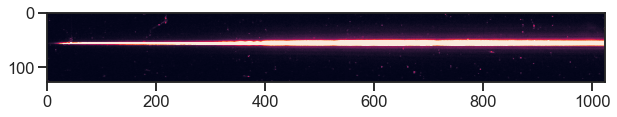

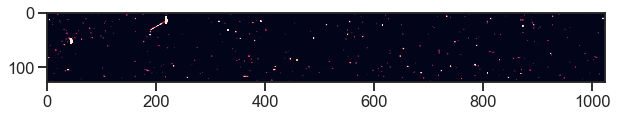

Frame 54


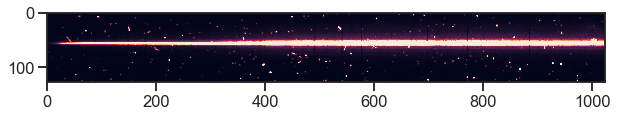

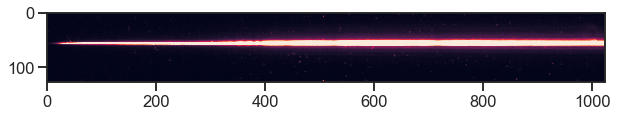

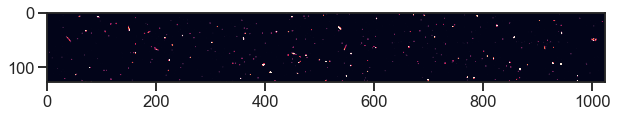

Frame 55


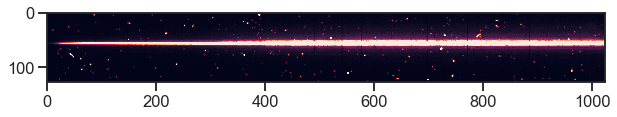

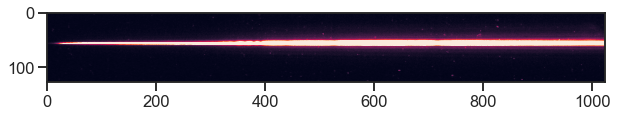

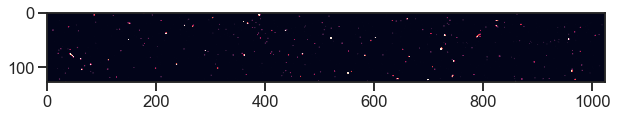

Frame 56


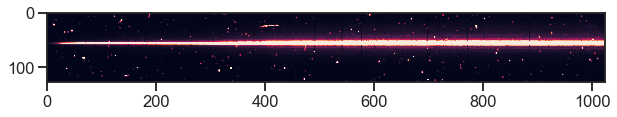

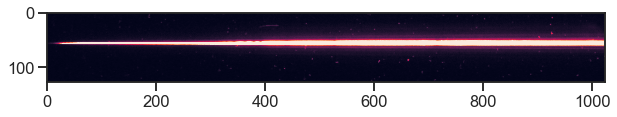

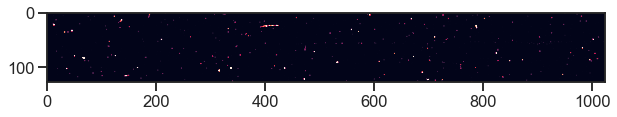

Frame 57


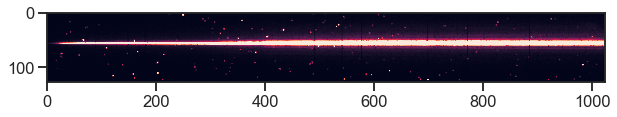

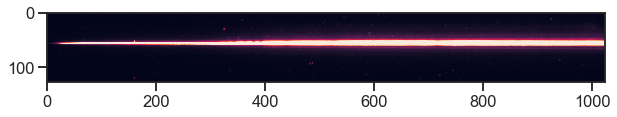

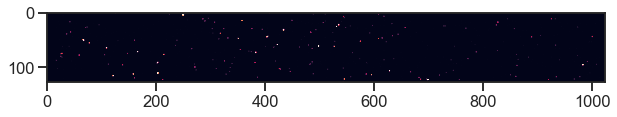

Frame 58


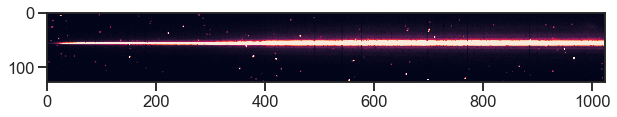

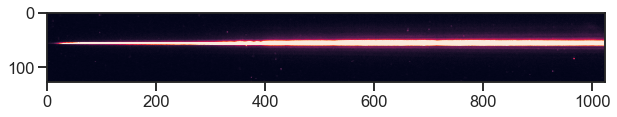

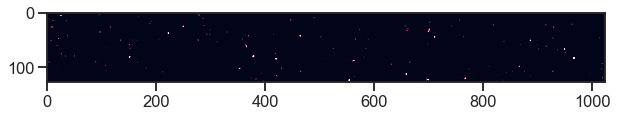

Frame 59


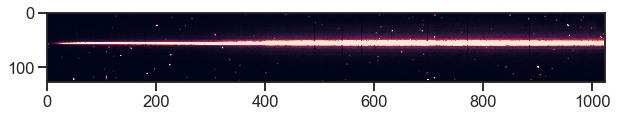

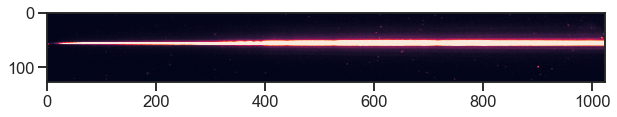

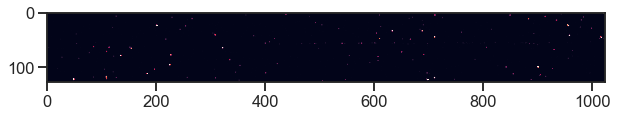

Frame 60


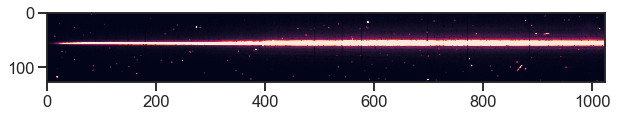

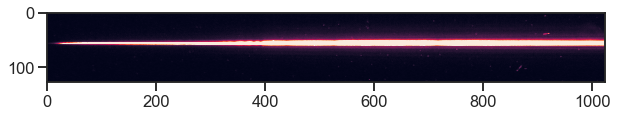

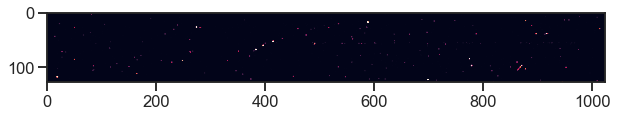

Frame 61


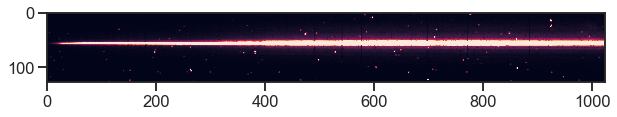

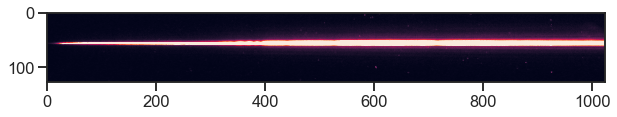

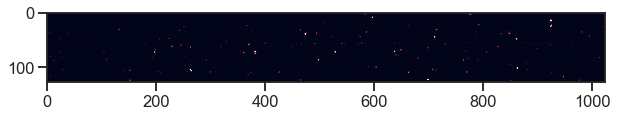

Frame 62


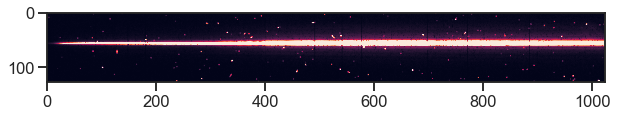

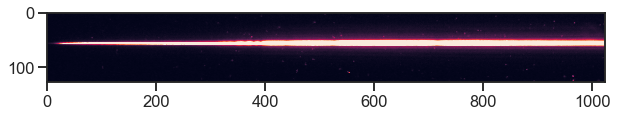

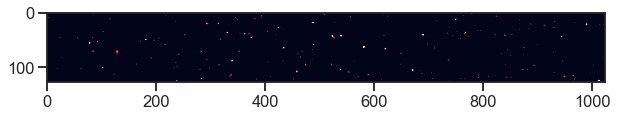

Frame 63


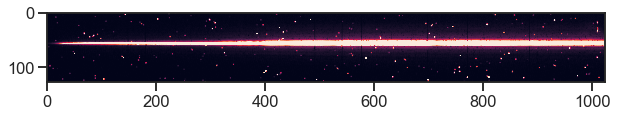

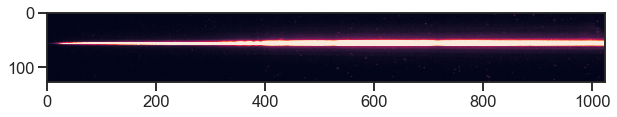

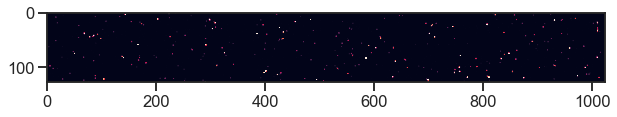

Frame 64


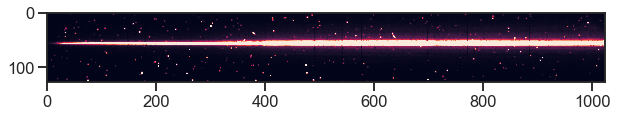

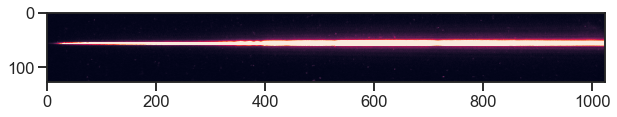

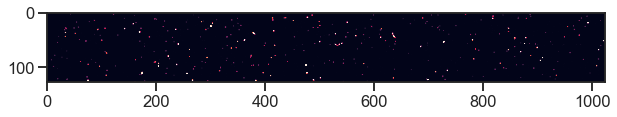

Frame 65


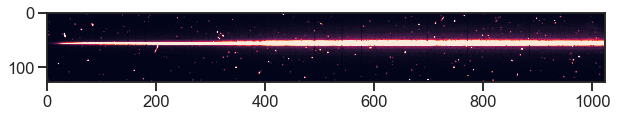

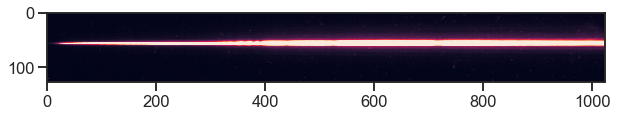

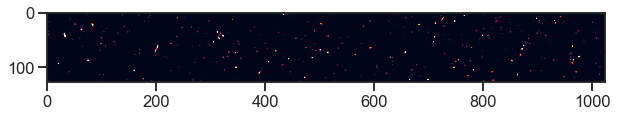

Frame 66


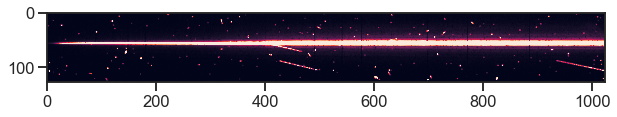

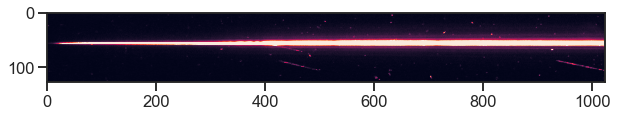

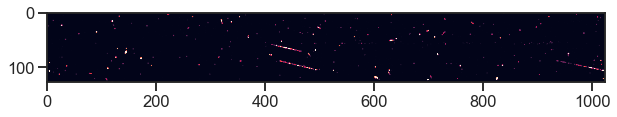

Frame 67


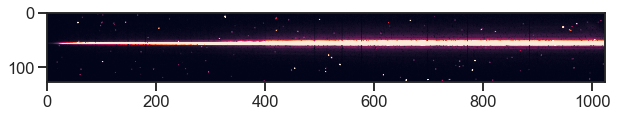

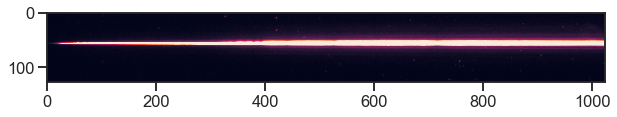

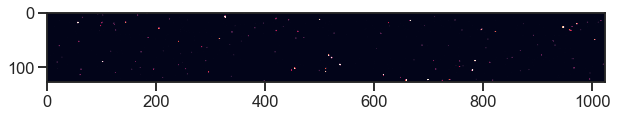

Frame 68


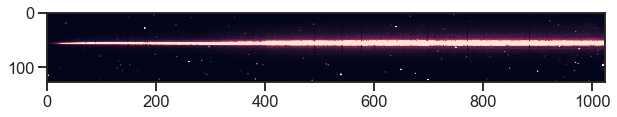

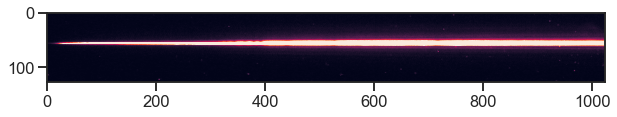

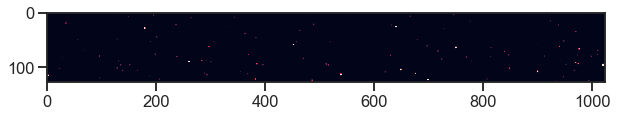

Frame 69


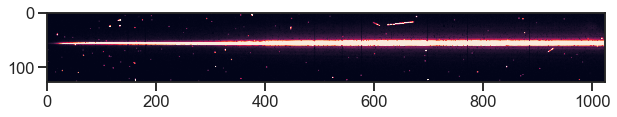

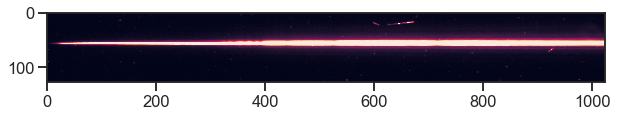

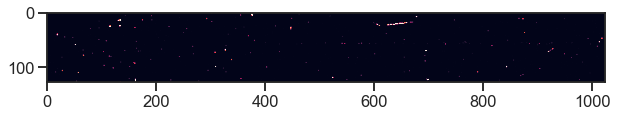

Frame 70


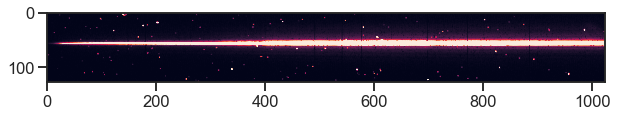

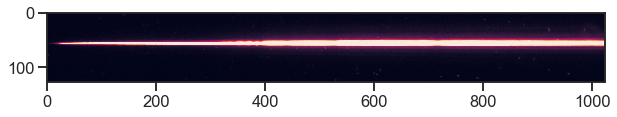

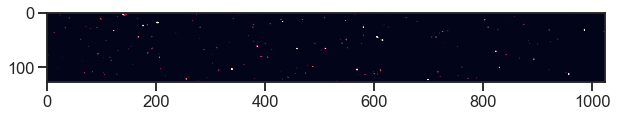

Frame 71


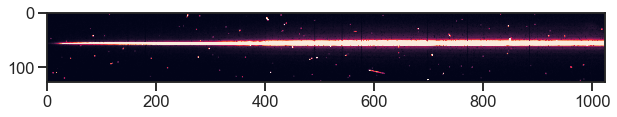

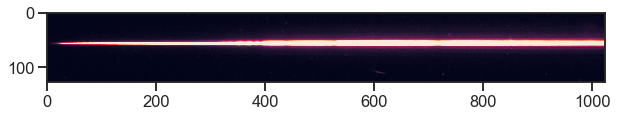

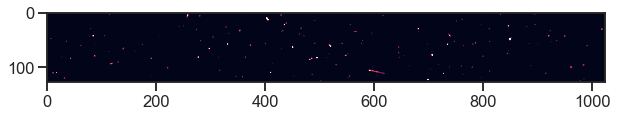

Frame 72


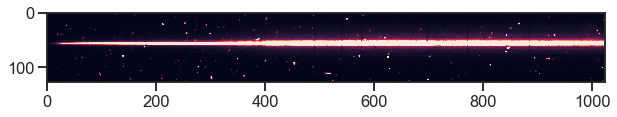

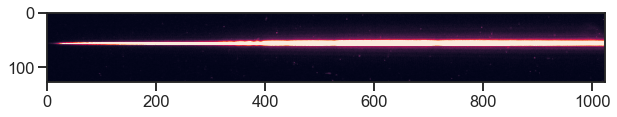

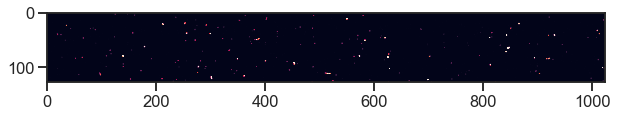

Frame 73


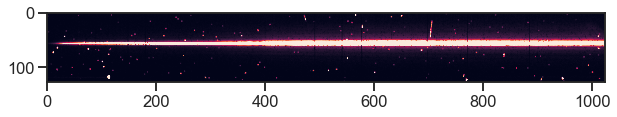

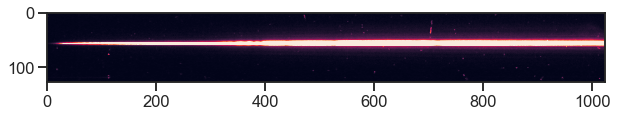

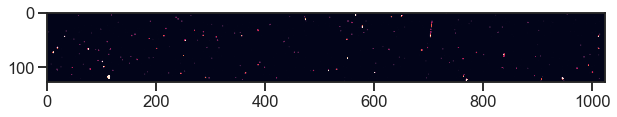

Frame 74


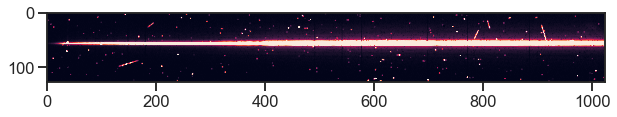

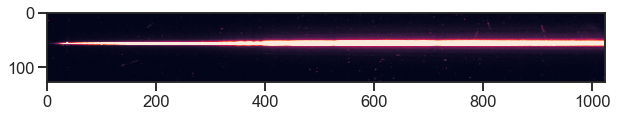

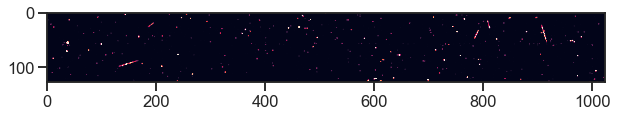

Frame 75


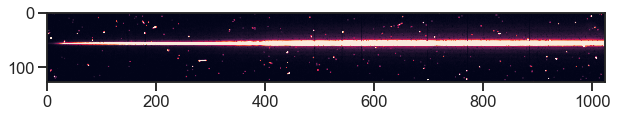

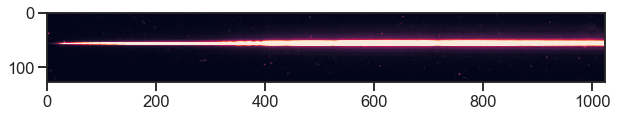

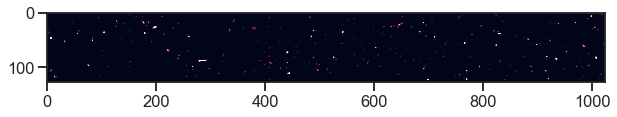

Frame 76


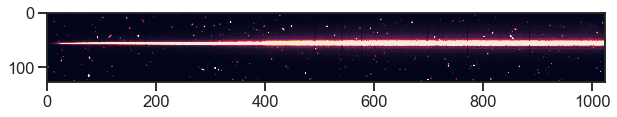

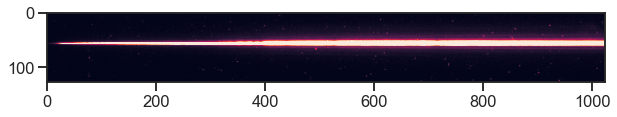

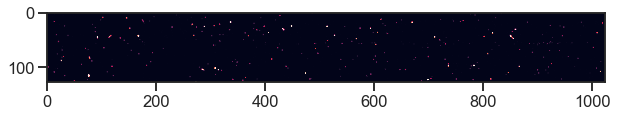

Frame 77


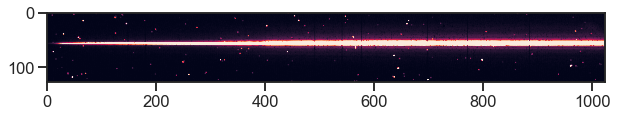

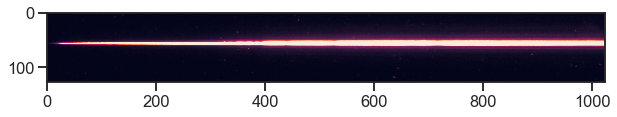

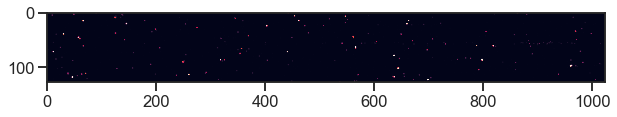

Frame 78


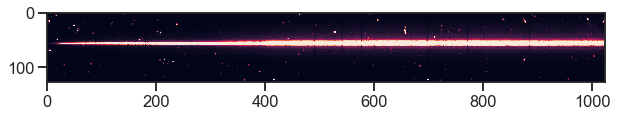

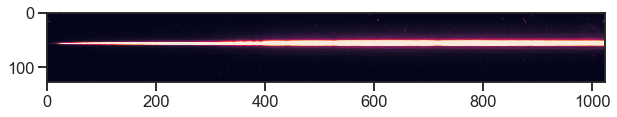

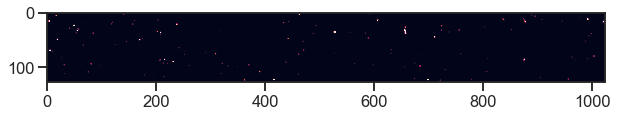

Frame 79


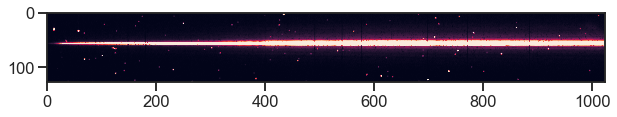

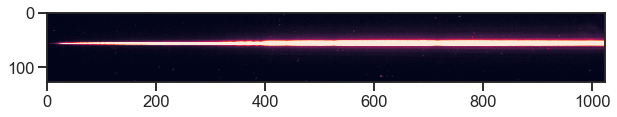

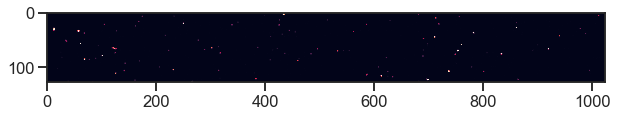

Frame 80


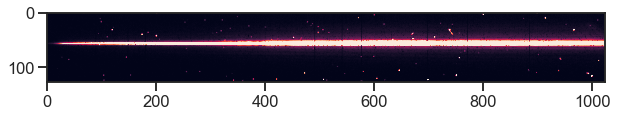

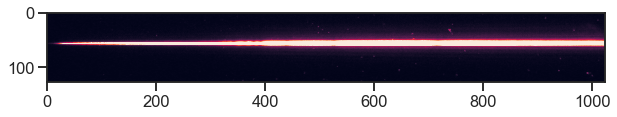

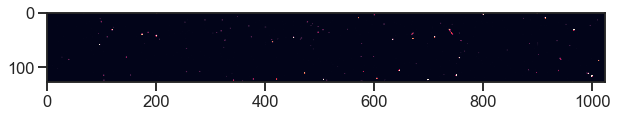

Frame 81


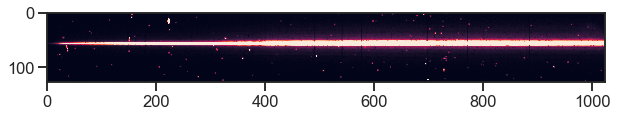

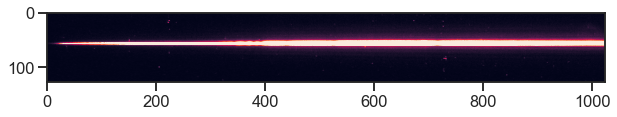

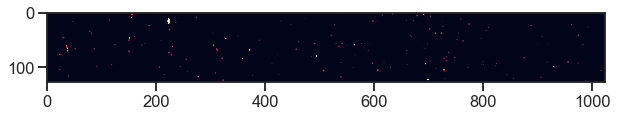

Frame 82


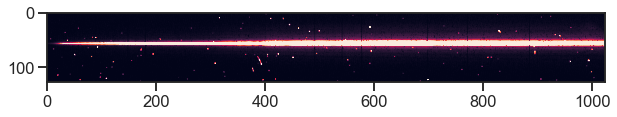

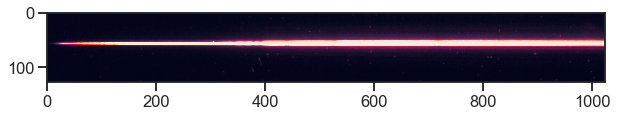

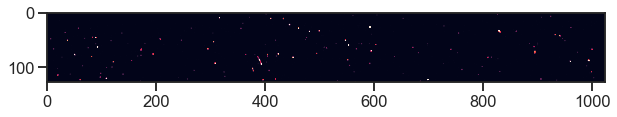

Frame 83


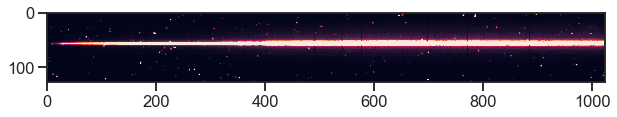

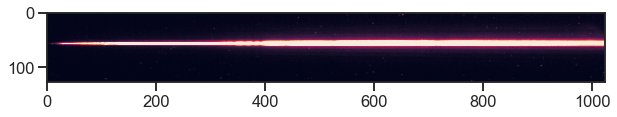

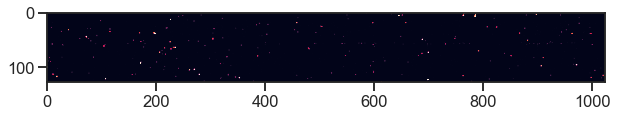

Frame 84


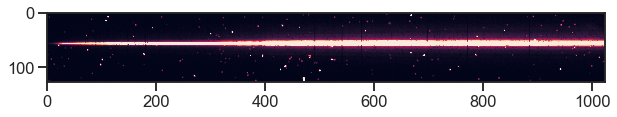

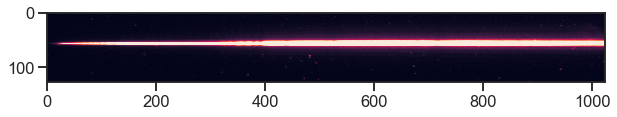

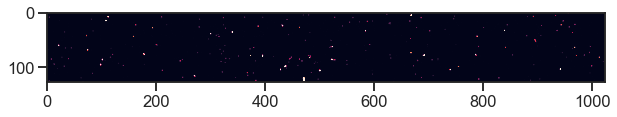

Frame 85


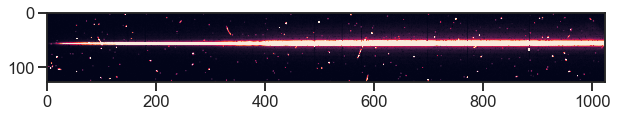

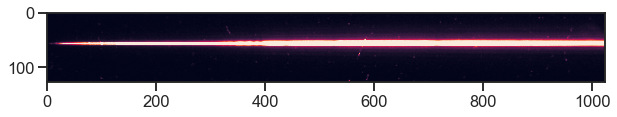

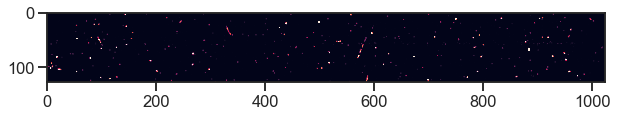

Frame 86


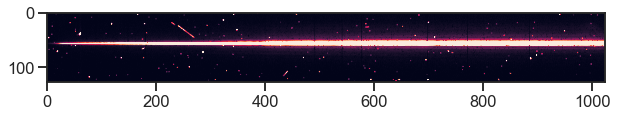

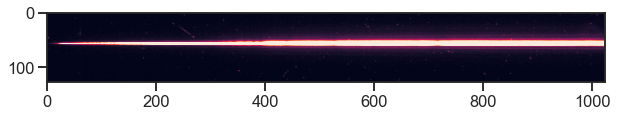

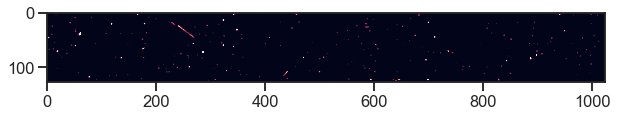

Frame 87


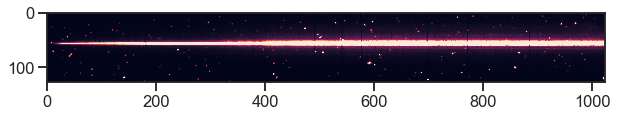

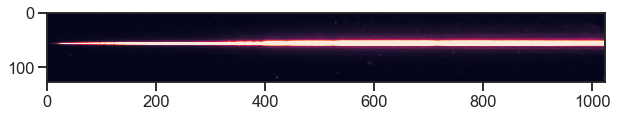

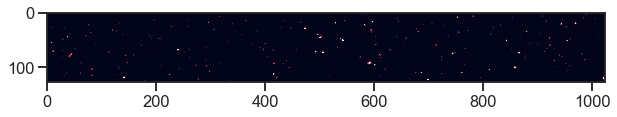

Frame 88


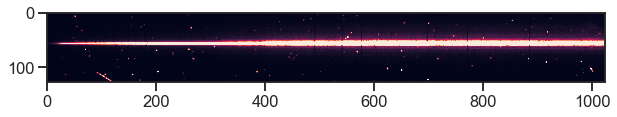

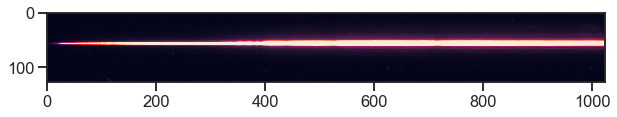

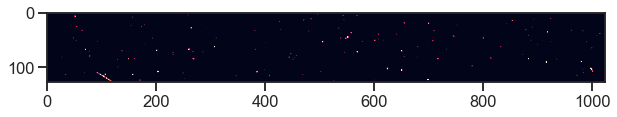

Frame 89


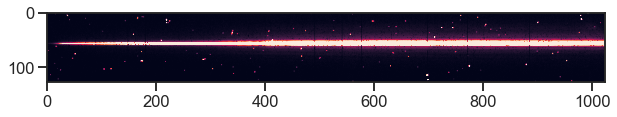

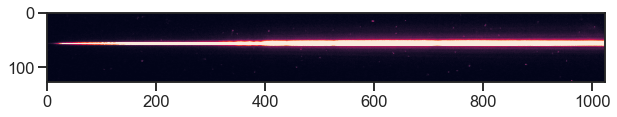

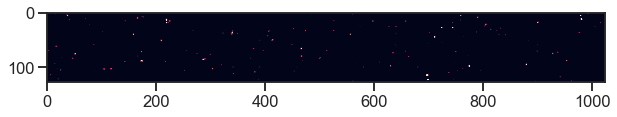

Frame 90


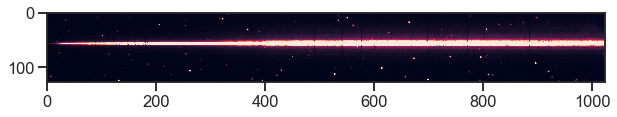

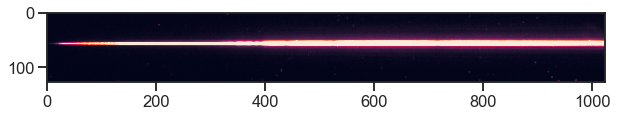

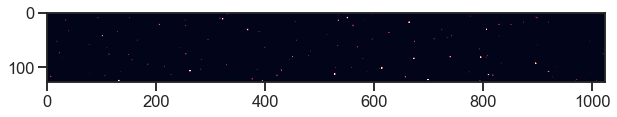

Frame 91


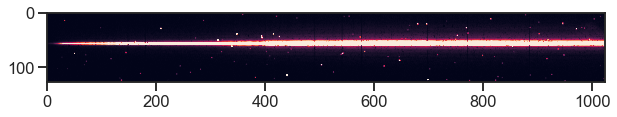

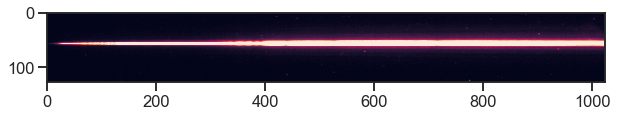

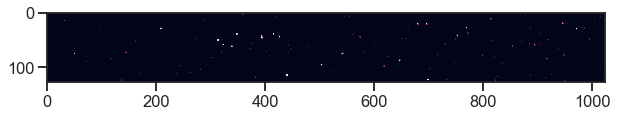

Frame 92


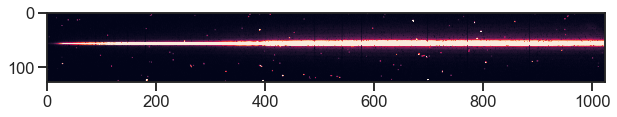

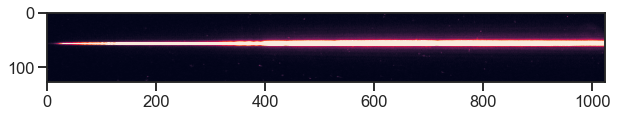

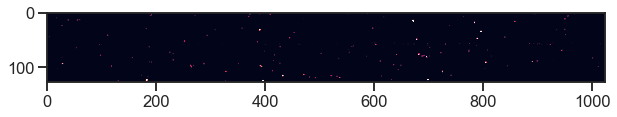

Frame 93


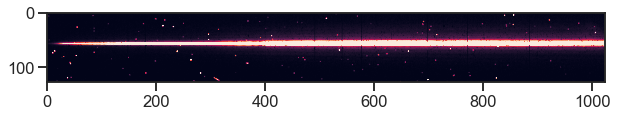

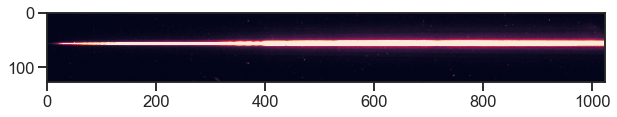

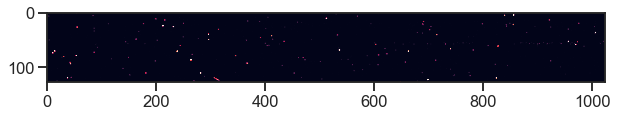

Frame 94


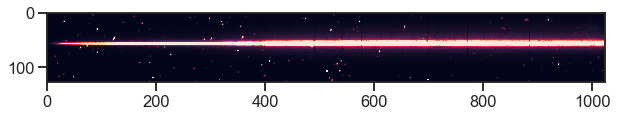

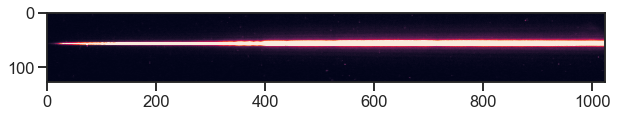

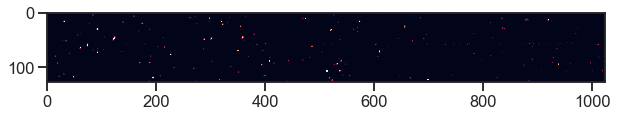

Frame 95


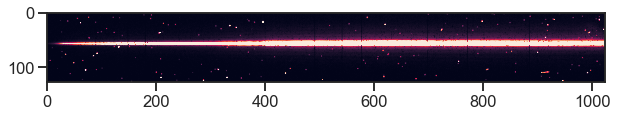

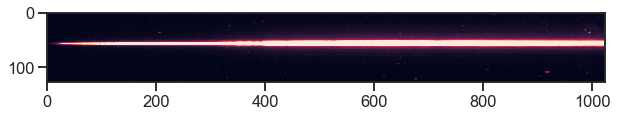

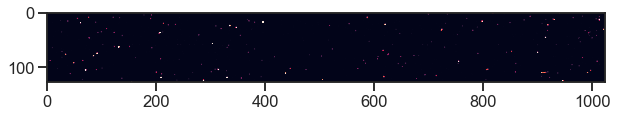

In [26]:
# and the 430 data
transit_430_cleaned_t = transit_430_cleaned + transit_430_2_cleaned

for i in range(len(transit_430_cleaned_t)):
    print("Frame", i)
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_430[0][i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(transit_430_cleaned_t[i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_430[0][i]-transit_430_cleaned_t[i])
    im.set_clim(0,200)
    plt.show()
        

In [29]:
# save all of the cleaned images
name = "cleaned_data_wasp17_feb22"

if os.path.exists(name) != True:
    os.makedirs(name)
for i in range(len(transit_750_cleaned)):
    filename = "cleaned_750_1_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_750_cleaned[i], data_750[1][i], overwrite=True)
    fits.append(name + "/"+filename, data_750[4][i])
    
for i in range(len(transit_430_cleaned)):
    filename = "cleaned_430_1_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_430_cleaned[i], data_430[1][i], overwrite=True)
    fits.append(name + "/"+filename, data_430[4][i])
    
for i in range(len(transit_430_2_cleaned)):
    filename = "cleaned_430_2_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_430_2_cleaned[i], data_430[1][48+i], overwrite=True)
    fits.append(name + "/"+filename, data_430[4][48+i])


In [30]:
# and then just write the jitter detrending vectors dictionary to a pickle file for later use
with open('jitter_750.pkl', 'wb') as handle:
    pickle.dump(data_750[2], handle, protocol=pickle.HIGHEST_PROTOCOL)

with open('jitter_430.pkl', 'wb') as handle:
    pickle.dump(data_430[2], handle, protocol=pickle.HIGHEST_PROTOCOL)

In [1]:
# now that we have the cleaned files, we don't need to run any of the above code a second time
# read those files in to have this as a new starting point
from STIS_pipeline_functions import *

name = "cleaned_data_wasp17_feb22"

cleaned_data_430_1 = sorted(glob.glob(name + "/cleaned_430_1*"))
transit_430_cleaned = []
headers_430 = []
errs_430 = []
for i in cleaned_data_430_1:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_430_cleaned.append(c_data)
    headers_430.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_430.append(e_data)
    
cleaned_data_430_2 = sorted(glob.glob(name + "/cleaned_430_2*"))
transit_430_2_cleaned = []
headers_430_2 = []
errs_430_2 = []
for i in cleaned_data_430_2:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_430_2_cleaned.append(c_data)
    headers_430_2.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_430_2.append(e_data)

with open('jitter_430.pkl', 'rb') as handle:
    jit_430 = pickle.load(handle)

/Users/natalieallen/opt/anaconda3/lib/python3.8/site-packages/autograd/numpy/numpy_wrapper.py:20: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  int_types = {_np.int, _np.int8, _np.int16, _np.int32, _np.int64, _np.integer}


In [2]:
cleaned_data_750 = sorted(glob.glob(name + "/cleaned_750*"))
transit_750_cleaned = []
headers_750 = []
errs_750 = []
for i in cleaned_data_750:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_750_cleaned.append(c_data)
    headers_750.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_750.append(e_data)

with open('jitter_750.pkl', 'rb') as handle:
    jit_750 = pickle.load(handle)

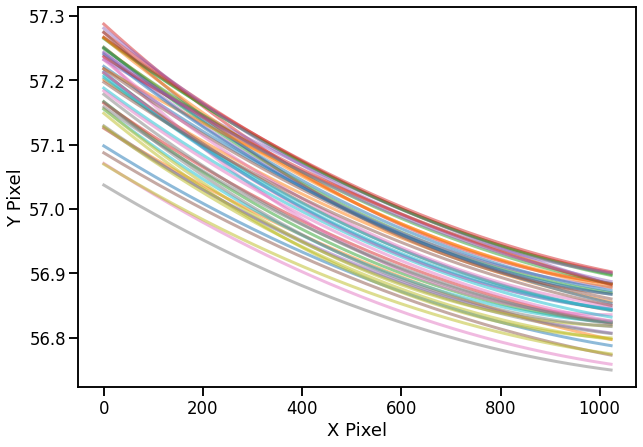

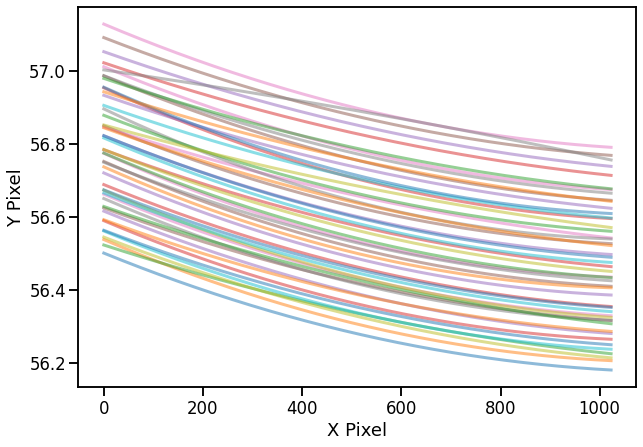

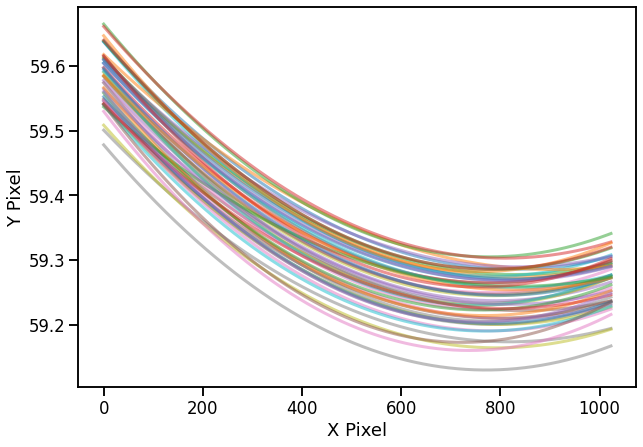

In [3]:
# now to retrace the cleaned data
trace_430_list = []
plt.figure(figsize = (10,7))
for i in transit_430_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_430_list.append(trace)

trace_430_coeffs = []
trace_430_fit = []
for j in trace_430_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_430_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_430_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_cleaned[0][0])),coeffs1)]
    trace_430_fit.append(trace)
    trace_430_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

trace_430_2_list = []
plt.figure(figsize = (10,7))
for i in transit_430_2_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_430_2_list.append(trace)

trace_430_2_coeffs = []
trace_430_2_fit = []
for j in trace_430_2_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_430_2_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_2_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_430_2_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_2_cleaned[0][0])),coeffs1)]
    trace_430_2_fit.append(trace)
    trace_430_2_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

trace_750_list = []
plt.figure(figsize = (10,7))
for i in transit_750_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_750_list.append(trace)

trace_750_coeffs = []
trace_750_fit = []
for j in trace_750_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_750_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_750_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_750_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_750_cleaned[0][0])),coeffs1)]
    trace_750_fit.append(trace)
    trace_750_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()


In [4]:
# now for the spectral extraction - I use optimal since I don't do the spline cleaning, and I feed in the ron and 
# gain values from the header
spectra_430 = []
for i in range(len(transit_430_cleaned)):
    spec = spectral_extraction(transit_430_cleaned[i], trace_430_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_430.append(spec)

In [5]:
spectra_430_2 = []
for i in range(len(transit_430_2_cleaned)):
    spec = spectral_extraction(transit_430_2_cleaned[i], trace_430_2_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_430_2.append(spec)

In [6]:
spectra_750 = []
for i in range(len(transit_750_cleaned)):
    spec = spectral_extraction(transit_750_cleaned[i], trace_750_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_750.append(spec)

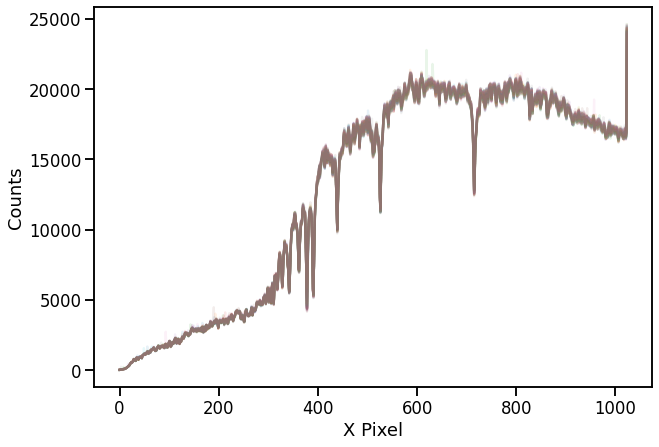

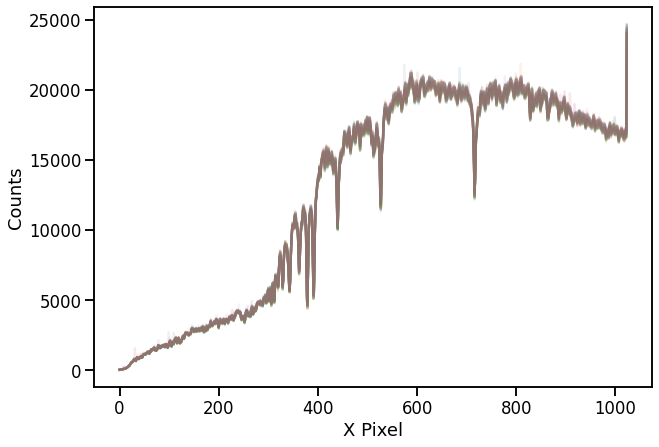

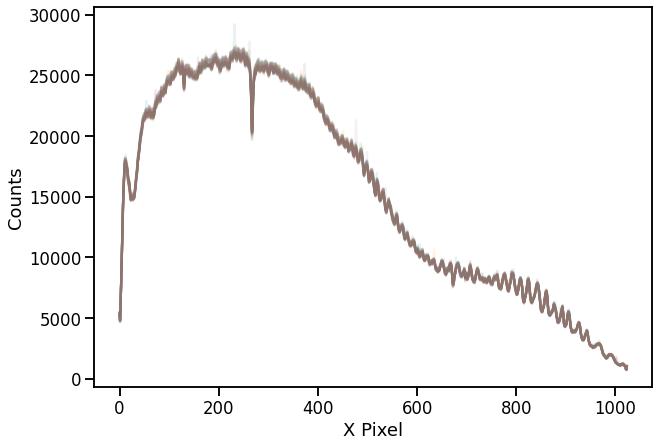

In [7]:
%matplotlib inline
# plot all of the spectra on top of each other
plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

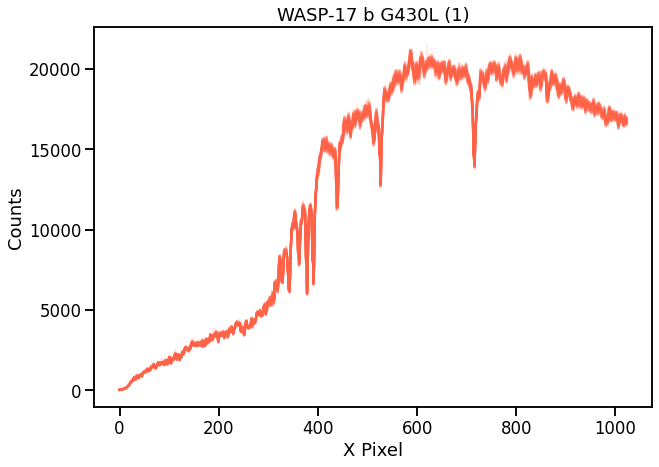

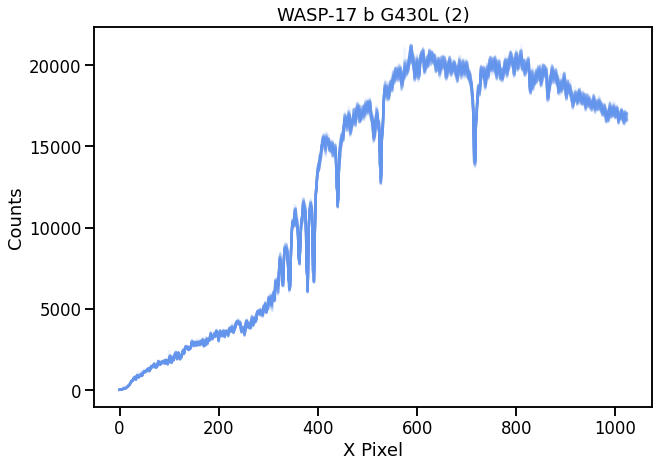

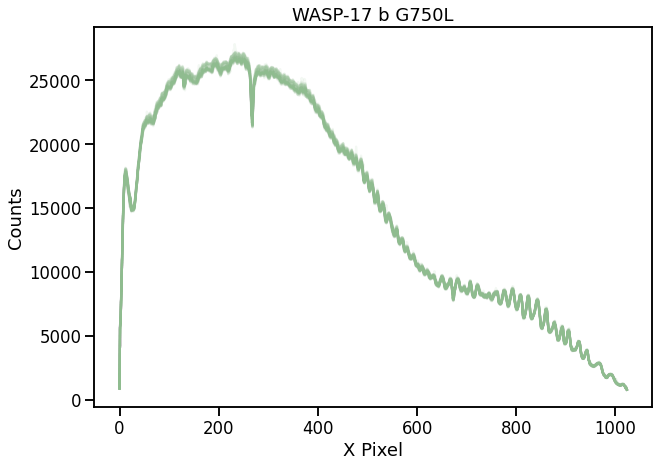

In [8]:
# hm, there's maybe a few outliers, so let's just try to get rid of some of those using a basic median filter function
spectra_430 = spectrum_outliers(spectra_430)
spectra_430_2 = spectrum_outliers(spectra_430_2)
spectra_750 = spectrum_outliers(spectra_750)

plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(i[1], alpha = 0.1, color = "tomato")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-17 b G430L (1)")
#plt.savefig("w17b_g430l_extspec1.png", dpi = 300, facecolor = "white")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(i[1], alpha = 0.1, color = "cornflowerblue")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-17 b G430L (2)")
#plt.savefig("w17b_g430l_extspec2.png", dpi = 300, facecolor = "white")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(i[1], alpha = 0.1, color = "darkseagreen")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-17 b G750L")
#plt.savefig("w17b_g750l_extspec.png", dpi = 300, facecolor = "white")
plt.show()

In [9]:
# sum up each of the spectra for the white light curve
lc_430 = []
lc_err_430 = []
for i in spectra_430:
    point = np.nansum(i[1])
    # optimal extraction outputs inverse variance, so np.sqrt(np.nansum((1/np.sqrt(i[2]))**2)) 
    # is the error on each point
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_430.append(point)
    lc_err_430.append(err)
    
lc_430_2 = []
lc_err_430_2 = []
for i in spectra_430_2:
    point = np.nansum(i[1])
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_430_2.append(point)
    lc_err_430_2.append(err)
    
lc_750 = []
lc_err_750 = []
for i in spectra_750:
    point = np.nansum(i[1])
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_750.append(point)
    lc_err_750.append(err)

In [10]:
# now to deal with the timestamps. HST header times come in JDUTC, we want BJD-TBD 
times_430 = times_to_bjd(headers_430, starname = "WASP-17")
times_start_430 = times_430[0][0]
times_end_430 = times_430[0][1]

times_430_2 = times_to_bjd(headers_430_2, starname = "WASP-17")
times_start_430_2 = times_430_2[0][0]
times_end_430_2 = times_430_2[0][1]

times_750 = times_to_bjd(headers_750, starname = "WASP-17")
times_start_750 = times_750[0][0]
times_end_750 = times_750[0][1]

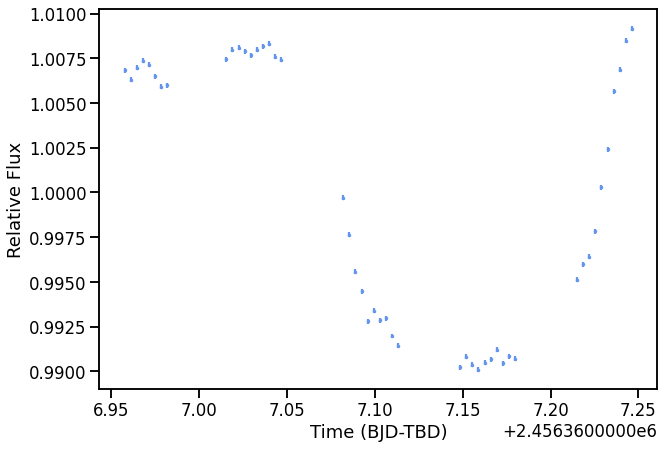

In [11]:
# should now be able to plot our raw white light curve - looks pretty good!
plt.figure(figsize = (10,7))
plt.errorbar(times_start_430, lc_430/np.nanmedian(lc_430), yerr = lc_err_430/np.nanmedian(lc_430), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

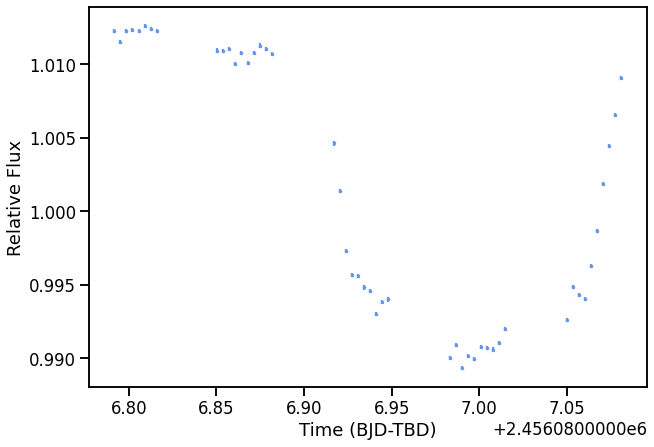

In [12]:
plt.figure(figsize = (10,7))
plt.errorbar(times_start_430_2, lc_430_2/np.nanmedian(lc_430_2), yerr = lc_err_430_2/np.nanmedian(lc_430_2), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

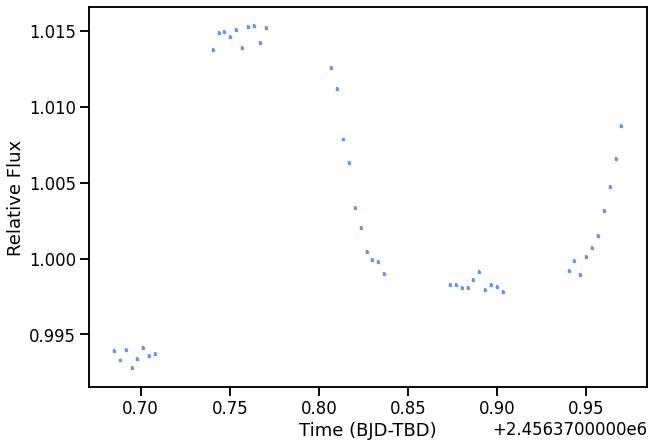

In [13]:
# oof that first orbit
plt.figure(figsize = (10,7))
plt.errorbar(times_start_750, lc_750/np.nanmedian(lc_750), yerr = lc_err_750/np.nanmedian(lc_750), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

In [14]:
# calculate trace polynomial movement - another detrending vector
template_430 = np.nanmedian(trace_430_coeffs, axis = 0)
movement_430 = []
movement_coeff1_430 = []
movement_coeff2_430 = []
for i in trace_430_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_430.append((template_430-i)[0])
    movement_coeff1_430.append((template_430-i)[1])
    movement_coeff2_430.append((template_430-i)[2])
    
#jit_430["Y"] = movement_430

template_430_2 = np.nanmedian(trace_430_2_coeffs, axis = 0)
movement_430_2 = []
movement_coeff1_430_2 = []
movement_coeff2_430_2 = []
for i in trace_430_2_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_430_2.append((template_430-i)[0])
    movement_coeff1_430_2.append((template_430-i)[1])
    movement_coeff2_430_2.append((template_430-i)[2])

#jit_430["Y"] = movement_430 + movement_430_2
jit_430["T_move"] = movement_430 + movement_430_2
jit_430["T_coeff1"] = movement_coeff1_430 + movement_coeff1_430_2
jit_430["T_coeff2"] = movement_coeff2_430 + movement_coeff2_430_2

In [15]:
template_750 = np.nanmedian(trace_750_coeffs, axis = 0)
movement_750 = []
movement_coeff1_750 = []
movement_coeff2_750 = []
for i in trace_750_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_750.append((template_750-i)[0])
    movement_coeff1_750.append((template_750-i)[1])
    movement_coeff2_750.append((template_750-i)[2])
#jit_750["Y"] = movement_750
jit_750["T_move"] = movement_750
jit_750["T_coeff1"] = movement_coeff1_750
jit_750["T_coeff2"] = movement_coeff2_750

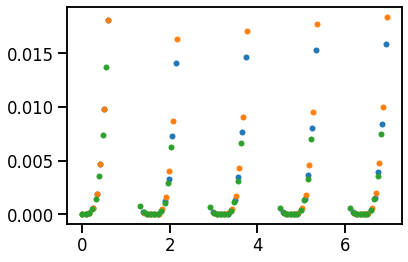

In [16]:
# last detrending vector: HST orbital phase

HST_period = 95.42/(60. * 24.) # HST period in days
#visit['orbital phase'] = juliet.utils.get_phases(visit['times'], HST_period, visit['times'][0])
phase_430_1 = juliet.utils.get_phases(times_start_430, HST_period, times_start_430[0])**4
phase_430_2 = juliet.utils.get_phases(times_start_430_2, HST_period, times_start_430_2[0])**4

jit_430["phase^4"] = list(phase_430_1) + list(phase_430_2)

jit_750["phase^4"] = juliet.utils.get_phases(times_start_750, HST_period, times_start_750[0])**4

# looks about right
plt.plot((times_start_430 - times_start_430[0])*24, phase_430_1, "o")
plt.plot((times_start_430_2 - times_start_430_2[0])*24, phase_430_2, "o")
plt.plot((times_start_750 - times_start_750[0])*24, jit_750["phase^4"], "o")

In [17]:
# before fitting, we just need to normalize our detrending vectors into standard deviation
# these are the detrending vectors to use
jit_use = ["V2_roll", "V3_roll", "Latitude", "Longitude", "RA", "DEC", "T_move", "T_coeff1", "T_coeff2", "phase^4"]

norm_jit_750 = {}
for i in jit_use:
    norm = (jit_750[i]/np.nanmean(jit_750[i]))-1
    norm_jit_750[i] = norm/np.std(norm)

In [18]:
jit_use = ["V2_roll", "V3_roll", "Latitude", "Longitude", "RA", "DEC", "T_move", "T_coeff1", "T_coeff2", "phase^4"]
norm_jit_430 = {}
for i in jit_use:
    norm = (jit_430[i][:48]/np.nanmean(jit_430[i][:48]))-1
    norm_jit_430[i] = norm/np.std(norm)
    
norm_jit_430_2 = {}
for i in jit_use:
    norm = (jit_430[i][48:]/np.nanmean(jit_430[i][48:]))-1
    norm_jit_430_2[i] = norm/np.std(norm)

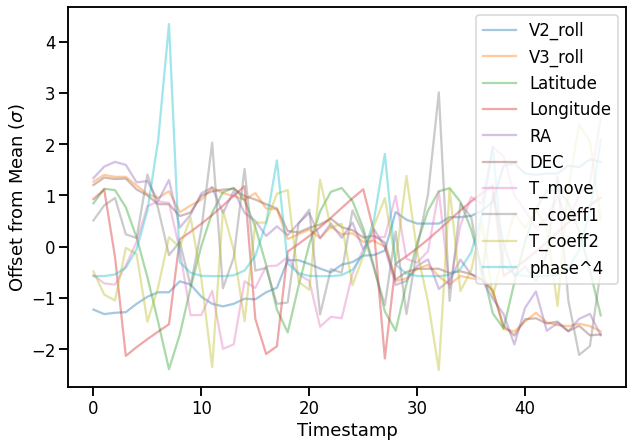

In [19]:
# check them out 
plt.figure(figsize = (10,7))
for i in norm_jit_750:
    plt.plot(norm_jit_750[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

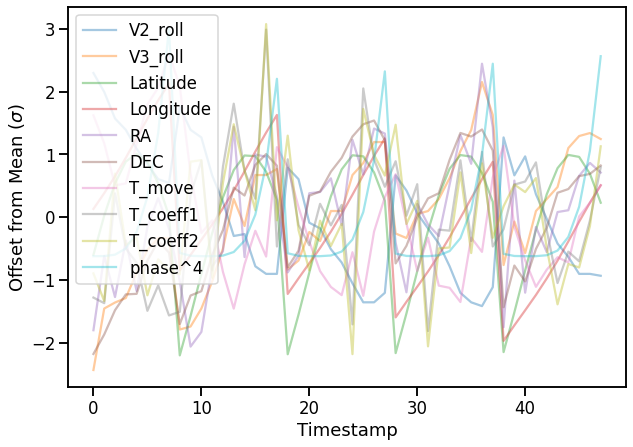

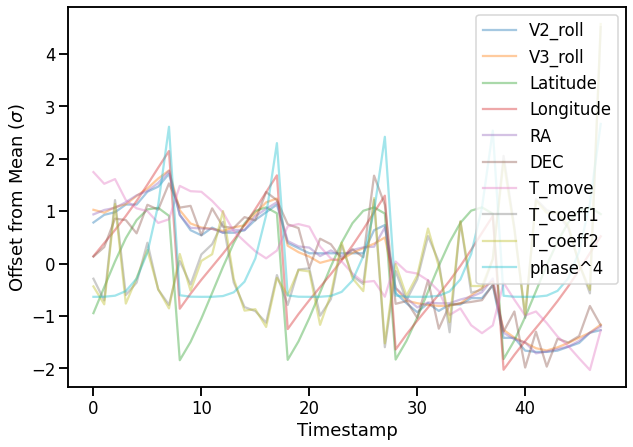

In [20]:
plt.figure(figsize = (10,7))
for i in norm_jit_430:
    plt.plot(norm_jit_430[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

plt.figure(figsize = (10,7))
for i in norm_jit_430_2:
    plt.plot(norm_jit_430_2[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

In [21]:
# take out that bad first orbit for the 750 data
times_start_750_less = times_start_750[8:]
lc_750_less = lc_750[8:]
lc_err_750_less = lc_err_750[8:]
spectra_750_less = spectra_750[8:]
norm_jit_750_less = {}
jit_names = list(norm_jit_750.keys())
for i in range(len(norm_jit_750)):
    norm_jit_750_less[jit_names[i]] = norm_jit_750[jit_names[i]][8:]

In [22]:
# now we need to run PCA on these detrending vectors
# do the PCA
vectors = [norm_jit_430[i] for i in list(norm_jit_430.keys())]
eigenvectors,eigenvalues,PC = classic_PCA(vectors)

norm_pc_430 = {}
j = 0
for i in PC:
    norm = (i/np.nanmean(i))-1
    name = "PC" + str(j)
    j = j+1
    norm_pc_430[name] = norm/np.std(norm)
    
    
vectors2 = [norm_jit_430_2[i] for i in list(norm_jit_430_2.keys())]
eigenvectors,eigenvalues,PC2 = classic_PCA(vectors2)

norm_pc_430_2 = {}
j = 0
for i in PC2:
    norm = (i/np.nanmean(i))-1
    name = "PC" + str(j)
    j = j+1
    norm_pc_430_2[name] = norm/np.std(norm)
    
vectors_750 = [norm_jit_750_less[i] for i in list(norm_jit_750_less.keys())]
eigenvectors,eigenvalues,PC = classic_PCA(vectors_750)

norm_pc_750 = {}
j = 0
for i in PC:
    norm = (i/np.nanmean(i))-1
    name = "PC" + str(j)
    j = j+1
    norm_pc_750[name] = norm/np.std(norm)
    

In [23]:
# and get all of the individual lists
norm_pc_use1_430 = {}
names = list(norm_pc_430.keys())
for i in range(1):
    name = "PC" + str(i+1)
    norm_pc_use1_430[name] = norm_pc_430[names[i]]
    
norm_pc_use1_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(1):
    name = "PC" + str(i+1)
    norm_pc_use1_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use2_430 = {}
names = list(norm_pc_430.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_430[name] = norm_pc_430[names[i]]
    
norm_pc_use2_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use3_430 = {}
names = list(norm_pc_430.keys())
for i in range(3):
    name = "PC" + str(i+1)
    norm_pc_use3_430[name] = norm_pc_430[names[i]]
    
norm_pc_use3_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(3):
    name = "PC" + str(i+1)
    norm_pc_use3_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use4_430 = {}
names = list(norm_pc_430.keys())
for i in range(4):
    name = "PC" + str(i+1)
    norm_pc_use4_430[name] = norm_pc_430[names[i]]
    
norm_pc_use4_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(4):
    name = "PC" + str(i+1)
    norm_pc_use4_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use5_430 = {}
names = list(norm_pc_430.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_430[name] = norm_pc_430[names[i]]
    
norm_pc_use5_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use6_430 = {}
names = list(norm_pc_430.keys())
for i in range(6):
    name = "PC" + str(i+1)
    norm_pc_use6_430[name] = norm_pc_430[names[i]]
    
norm_pc_use6_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(6):
    name = "PC" + str(i+1)
    norm_pc_use6_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use7_430 = {}
names = list(norm_pc_430.keys())
for i in range(7):
    name = "PC" + str(i+1)
    norm_pc_use7_430[name] = norm_pc_430[names[i]]
    
norm_pc_use7_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(7):
    name = "PC" + str(i+1)
    norm_pc_use7_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use8_430 = {}
names = list(norm_pc_430.keys())
for i in range(8):
    name = "PC" + str(i+1)
    norm_pc_use8_430[name] = norm_pc_430[names[i]]
    
norm_pc_use8_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(8):
    name = "PC" + str(i+1)
    norm_pc_use8_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use9_430 = {}
names = list(norm_pc_430.keys())
for i in range(9):
    name = "PC" + str(i+1)
    norm_pc_use9_430[name] = norm_pc_430[names[i]]
    
norm_pc_use9_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(9):
    name = "PC" + str(i+1)
    norm_pc_use9_430_2[name] = norm_pc_430_2[names[i]]

norm_pc_use1_750 = {}
names = list(norm_pc_750.keys())
for i in range(1):
    name = "PC" + str(i+1)
    norm_pc_use1_750[name] = norm_pc_750[names[i]]
    
norm_pc_use2_750 = {}
names = list(norm_pc_750.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_750[name] = norm_pc_750[names[i]]
    
norm_pc_use3_750 = {}
names = list(norm_pc_750.keys())
for i in range(3):
    name = "PC" + str(i+1)
    norm_pc_use3_750[name] = norm_pc_750[names[i]]
    
norm_pc_use4_750 = {}
names = list(norm_pc_750.keys())
for i in range(4):
    name = "PC" + str(i+1)
    norm_pc_use4_750[name] = norm_pc_750[names[i]]
    
norm_pc_use5_750 = {}
names = list(norm_pc_750.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_750[name] = norm_pc_750[names[i]]
    
norm_pc_use6_750 = {}
names = list(norm_pc_750.keys())
for i in range(6):
    name = "PC" + str(i+1)
    norm_pc_use6_750[name] = norm_pc_750[names[i]]
    
norm_pc_use7_750 = {}
names = list(norm_pc_750.keys())
for i in range(7):
    name = "PC" + str(i+1)
    norm_pc_use7_750[name] = norm_pc_750[names[i]]
    
norm_pc_use8_750 = {}
names = list(norm_pc_750.keys())
for i in range(8):
    name = "PC" + str(i+1)
    norm_pc_use8_750[name] = norm_pc_750[names[i]]
    
norm_pc_use9_750 = {}
names = list(norm_pc_750.keys())
for i in range(9):
    name = "PC" + str(i+1)
    norm_pc_use9_750[name] = norm_pc_750[names[i]]

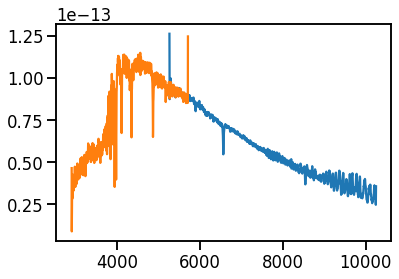

In [24]:
# next, we get the wavelength solution
wl_sol_750 = fits.getdata("wasp-17/HST/G750L/obri19010/obri19010_x1d.fits", ext = 1)
for i, order_750 in enumerate(wl_sol_750):
    plt.plot(order_750["WAVELENGTH"], order_750["FLUX"])
    
wl_sol_430 = fits.getdata("wasp-17/HST/G430L/obri05010/obri05010_x1d.fits", ext = 1)
for i, order_430 in enumerate(wl_sol_430):
    plt.plot(order_430["WAVELENGTH"], order_430["FLUX"])

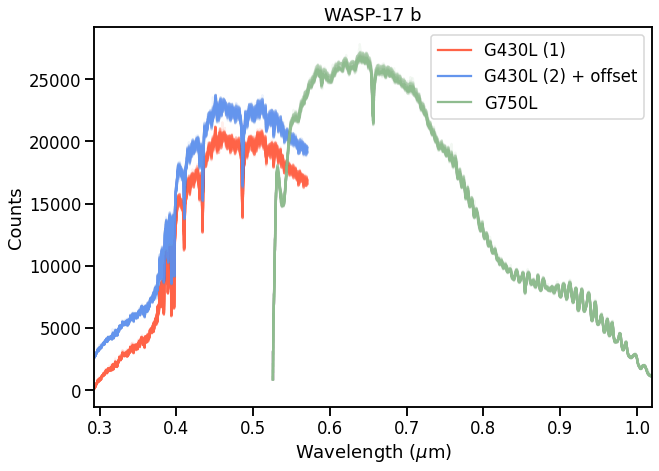

In [25]:
# extracted spectra with wavelengths
plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(order_430["WAVELENGTH"]/10000, i[1], alpha = 0.1, color = "tomato")
plt.plot([], [], color='tomato', label='G430L (1)')
plt.ylabel("Counts")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b")
#plt.savefig("w17b_g430l_extspec1.png", dpi = 300, facecolor = "white")
#plt.show()

#plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(order_430["WAVELENGTH"]/10000, i[1]+2500, alpha = 0.1, color = "cornflowerblue")
plt.plot([], [], color='cornflowerblue', label='G430L (2) + offset')
#plt.ylabel("Counts")
#plt.xlabel("X Pixel")
#plt.title("WASP-17 b G430L (2)")
#plt.savefig("w17b_g430l_extspec2.png", dpi = 300, facecolor = "white")
#plt.show()

#plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(order_750["WAVELENGTH"]/10000, i[1], alpha = 0.1, color = "darkseagreen")
plt.plot([], [], color='darkseagreen', label='G750L')
#plt.ylabel("Counts")
#plt.xlabel("X Pixel")
#plt.title("WASP-17 b G750L")
plt.xlim(2930/10000, 10200/10000)
plt.legend()
#plt.savefig("w17b_extspec.png", dpi = 300, facecolor = "white")

plt.show()

In [26]:
# we're going to fix limb darkening for now
# u1 = 2*sqrt(q1)*q2, u2 = sqrt(q1)*(1-2*q2) or q1 = (u1+u2)^2, q2 = u1/(2*(u1+u2)). 

from exotic_ld import StellarLimbDarkening

sld = StellarLimbDarkening(
            M_H=-0.25, Teff=6550, logg=4.2, ld_model='1D',
            ld_data_path="/Users/natalieallen/Documents/Grad/Sing Research/exotic-ld_data")

c1_430, c2_430 = sld.compute_quadratic_ld_coeffs(
            wavelength_range=np.array([order_430["WAVELENGTH"][0], order_430["WAVELENGTH"][-1]]),
            mode='HST_STIS_G430L')

c1_750, c2_750 = sld.compute_quadratic_ld_coeffs(
            wavelength_range=np.array([order_750["WAVELENGTH"][0], order_750["WAVELENGTH"][-1]]),
            mode='HST_STIS_G750L')

In [27]:
# to read into the white_light_fit functions, just need to create a dictionary like this - 
# put just the value if it should be fixed, and the value and range in a list if it should be fit
# now updated from Ricky's fit
params_430 = {"P": [3.7354858],"t0": [2454592.8011189], "p": [0.12, 0.05], "b": [0.268], "rho": [475.128], "ecc": [0], "omega": [90], "c1": [c1_430], "c2": [c2_430]}

In [28]:
params_750 = {"P": [3.7354858],"t0": [2454592.8011189], "p": [0.12, 0.05], "b": [0.268], "rho": [475.128], "ecc": [0], "omega": [90], "c1": [c1_750], "c2": [c2_750]}

In [29]:
# now for a bunch of light curve fitting
# to quickly describe, there are three main "options" for different fitting methods
# there is a gp detrending method (using juliet), and two linear detrending methods - one using juliet,
# and another just using a quick LM fit function (mostly just for test purposes)
# the juliet fits can use any of the available samplers, although right now I only have the default pymultinest and
# dynesty set up

# if you use either juliet method, you need to provide a name for an output folder with juliet_name
gp_fit = white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_430, sys_method = "gp", juliet_name = "wasp-17_430_1_newt_pc_dynamic_newpriors_rho_uniform", gp_kernel = "Matern", sampler = "dynamic_dynesty")
# this outputs a juliet "results" type - will show some ways of how to use that below

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_1_newt_pc_dynamic_newpriors_rho_uniform/_dynesty_DNS_posteriors.pkl


In [30]:
# here are the results for that fit
for i in gp_fit.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit.posteriors['posterior_samples'][i]))

unnamed 0.17430946847044018
loglike 266.49284767021015
p_p1 0.11694344733945561
mflux_STIS -0.0010801003766314808
sigma_w_STIS 5.97300640364169
GP_sigma_STIS 331.63837555960265
GP_malpha0_STIS 0.2957056634248529
GP_malpha1_STIS 0.28293176607038395
GP_malpha2_STIS 0.16361378400256923
GP_malpha3_STIS 0.33766716344441744
GP_malpha4_STIS 0.1508995755817543
GP_malpha5_STIS 1.2079785410705983
GP_malpha6_STIS 0.07622545349036425
GP_malpha7_STIS 0.1421221208668631
GP_malpha8_STIS 0.0707329535459751
GP_malpha9_STIS 0.07969340900005359


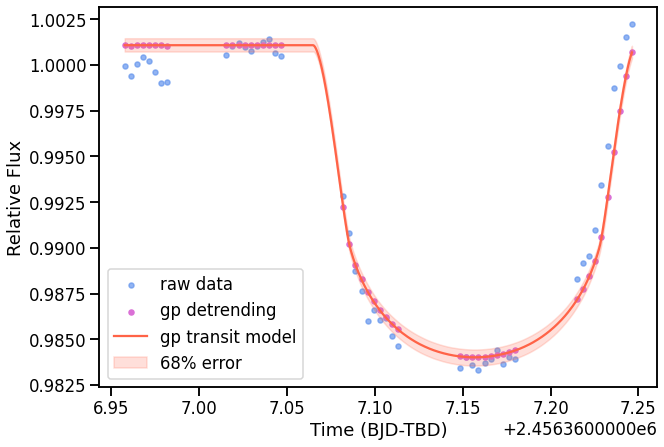

In [31]:
# let's plot the results of this fit using the juliet object
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_plus_GP_model = gp_fit.lc.evaluate('STIS')
transit_model = gp_fit.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_430, (lc_430/np.median(lc_430[:10])), label = "raw data", color = "cornflowerblue", alpha = 0.7)
plt.scatter(times_start_430, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(np.linspace(times_start_430[0], times_start_430[-1], 1000), transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [32]:
# second 430 transit
gp_fit_2 = white_light_fit(params_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_430_2, sys_method = "gp", juliet_name = "wasp-17_430_2_newt_pc_dynamic_newpriors_rho_uniform", gp_kernel = "Matern", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_2_newt_pc_dynamic_newpriors_rho_uniform/_dynesty_DNS_posteriors.pkl


In [33]:
# here are the results for that fit
for i in gp_fit_2.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_2.posteriors['posterior_samples'][i]))

unnamed 0.4739092890136012
loglike 277.11144943550084
p_p1 0.12909374493168374
mflux_STIS 0.0008126220736446158
sigma_w_STIS 32.89365325616474
GP_sigma_STIS 222.36022357444597
GP_malpha0_STIS 0.4280849604321986
GP_malpha1_STIS 0.53486941830516
GP_malpha2_STIS 0.3767486621927312
GP_malpha3_STIS 1.0543332946796682
GP_malpha4_STIS 0.6143476648998487
GP_malpha5_STIS 0.4627059775547145
GP_malpha6_STIS 0.4212441271056973
GP_malpha7_STIS 0.3124785167422641
GP_malpha8_STIS 0.4732712522885703
GP_malpha9_STIS 0.6266414872198792


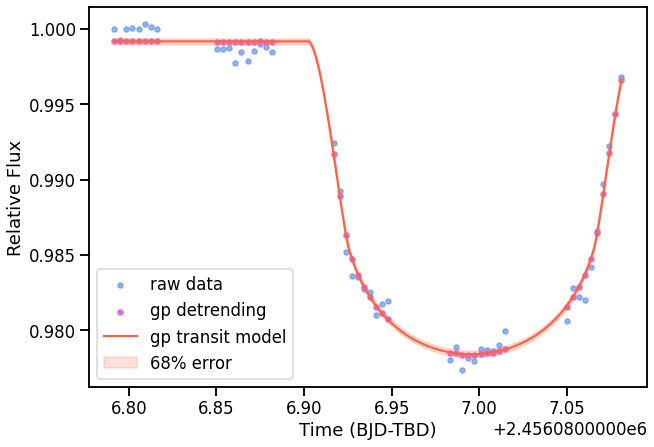

In [34]:
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_430_2[0], times_start_430_2[-1], 1000)

transit_plus_GP_model = gp_fit_2.lc.evaluate('STIS')
transit_model = gp_fit_2.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_2.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_430_2, (lc_430_2/np.median(lc_430_2[:10])), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_430_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [35]:
# 750 transit -- maybe we can recover the first transit using all of the jitter vectors
gp_fit_750 = white_light_fit(params_750, times_start_750, lc_750, lc_err_750, norm_jit_750, sys_method = "gp", juliet_name = "wasp-17_750_newprior", gp_kernel = "Matern", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_newprior/_dynesty_DNS_posteriors.pkl


In [36]:
for i in gp_fit_750.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_750.posteriors['posterior_samples'][i]))

unnamed 0.1293581266119425
loglike 203.30247319558663
p_p1 0.11598737310494509
mflux_STIS -0.016609601505945745
sigma_w_STIS 9.2093530232977
GP_sigma_STIS 1927.3213884395125
GP_malpha0_STIS 0.35074141947763354
GP_malpha1_STIS 0.49242003378381816
GP_malpha2_STIS 0.016213265492849283
GP_malpha3_STIS 0.013400456723253209
GP_malpha4_STIS 0.8154709914350216
GP_malpha5_STIS 0.4280492743564939
GP_malpha6_STIS 0.34515294095093557
GP_malpha7_STIS 0.06723592354452103
GP_malpha8_STIS 0.08540752694001034
GP_malpha9_STIS 0.018542781488096214


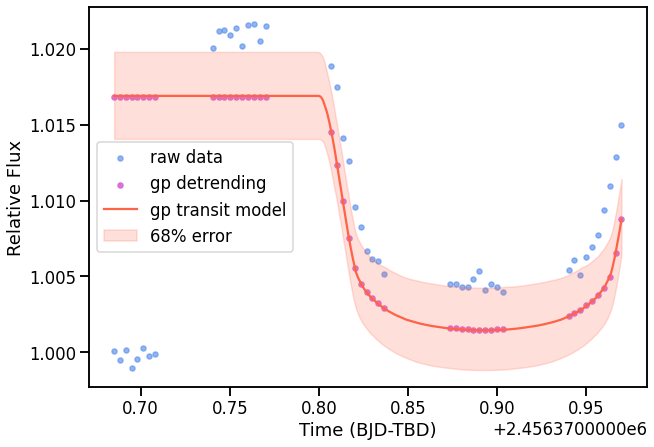

In [37]:
# just wanted to see if it could be saved, will use the _less to leave out for the rest of fits
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_750[0], times_start_750[-1], 1000)
transit_plus_GP_model = gp_fit_750.lc.evaluate('STIS')
transit_model = gp_fit_750.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_750.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_750, (lc_750/np.median(lc_750[:10])), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_750, (lc_750/np.median(lc_750[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [38]:
gp_fit_750_nf = white_light_fit(params_750, times_start_750_less, lc_750_less, lc_err_750_less, norm_pc_750, sys_method = "gp", juliet_name = "wasp-17_750_less_dd", gp_kernel = "Matern", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_less_dd/_dynesty_DNS_posteriors.pkl


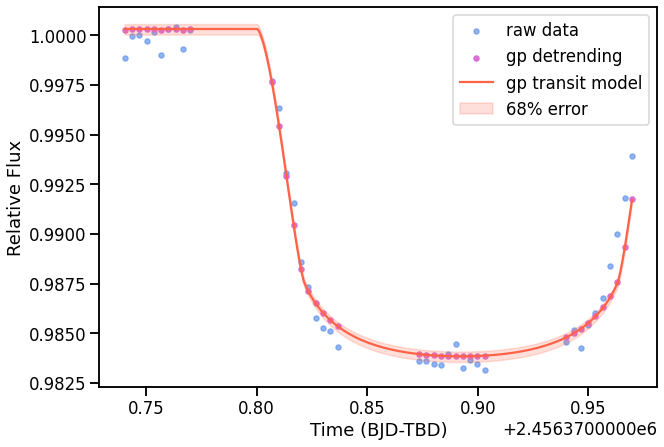

In [39]:
# better!
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_750_less[0], times_start_750_less[-1], 1000)
# then the gp detrending
transit_plus_GP_model = gp_fit_750_nf.lc.evaluate('STIS')
transit_model = gp_fit_750_nf.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_750_nf.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_750_less, (lc_750_less/np.median(lc_750_less[:10])), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_750_less, (lc_750_less/np.median(lc_750_less[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
#plt.plot(t_final, batman_model(t_final), color='black',zorder=10, label = "gp transit model (batman)")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [40]:
# now that we know our light curve fits are working correctly, we'll move to our spectroscopic light curve testing
# this is used to determine the optimal detrending parameters
# spectroscopic fit params dictionary -- only difference is how you pass in the limb darkening info
params_430_spec = {"P": [3.7354858],"t0": [2454592.8011189], "p": [0.12, 0.05], "b": [0.268], "rho": [475.128], "ecc": [0], "omega": [90], "c1": [c1_430], "c2": [c2_430]}
params_750_spec = {"P": [3.7354858],"t0": [2454592.8011189], "p": [0.12, 0.05], "b": [0.268], "rho": [475.128], "ecc": [0], "omega": [90], "c1": [c1_750], "c2": [c2_750]}

In [41]:
# the only difference for the spectroscopic light curve fitting function is that you pass in the wavelengths and 
# spectra itself rather than the light curve, and also the binning scheme (in a file, with the beginning
# and end wavelengths specified, see examples), and the "sld", which is the limb darkening object defined above
bins_joint_dd_lin_p, rp_joint_dd_lin_p, rp_e_joint_dd_lin_p, fits_linear_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_jit_430,\
                                                                      times_start_430_2, spectra_430_2, norm_jit_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_phase/wasp-17_430

<Figure size 576x1728 with 0 Axes>

In [42]:
bins_joint_dd_lin_pc_p, rp_joint_dd_lin_pc_p, rp_e_joint_dd_lin_pc_p, fits_lin_pc_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_

<Figure size 576x1728 with 0 Axes>

In [43]:
bins_joint_dd_lin_pc1_p, rp_joint_dd_lin_pc1_p, rp_e_joint_dd_lin_pc1_p, fits_lin_pc1_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use1_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use1_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc1_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [44]:
bins_joint_dd_lin_pc2_p, rp_joint_dd_lin_pc2_p, rp_e_joint_dd_lin_pc2_p, fits_lin_pc2_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use2_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use2_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [45]:
bins_joint_dd_lin_pc3_p, rp_joint_dd_lin_pc3_p, rp_e_joint_dd_lin_pc3_p, fits_lin_pc3_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use3_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use3_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc3_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [46]:
bins_joint_dd_lin_pc4_p, rp_joint_dd_lin_pc4_p, rp_e_joint_dd_lin_pc4_p, fits_lin_pc4_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use4_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use4_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc4_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [47]:
bins_joint_dd_lin_pc5_p, rp_joint_dd_lin_pc5_p, rp_e_joint_dd_lin_pc5_p, fits_lin_pc5_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use5_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use5_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc5_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [48]:
bins_joint_dd_lin_pc6_p, rp_joint_dd_lin_pc6_p, rp_e_joint_dd_lin_pc6_p, fits_lin_pc6_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use6_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use6_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc6_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [49]:
bins_joint_dd_lin_pc7_p, rp_joint_dd_lin_pc7_p, rp_e_joint_dd_lin_pc7_p, fits_lin_pc7_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use7_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use7_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc7_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [50]:
bins_joint_dd_lin_pc8_p, rp_joint_dd_lin_pc8_p, rp_e_joint_dd_lin_pc8_p, fits_lin_pc8_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use8_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use8_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc8_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [51]:
bins_joint_dd_lin_pc9_p, rp_joint_dd_lin_pc9_p, rp_e_joint_dd_lin_pc9_p, fits_lin_pc9_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use9_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use9_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc9_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

<Figure size 576x1728 with 0 Axes>

In [52]:
bins_7_nf_lin_dd_p, rp_7_nf_lin_dd_p, rp_e_7_nf_lin_dd_p, fits_7_lin_dd_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_jit_750_less,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_linear_phase/wasp-17_750_dd_less_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_linear_phase/wasp-17_750_dd_less_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_linear_phase/wasp-17_750_dd_less_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_linear_phase/wasp-17_750_dd_less_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_linear_phase/wasp-17_750_dd_less_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_linear_

<Figure size 576x1728 with 0 Axes>

In [53]:
bins_7_nf_lin_pc_p, rp_7_nf_lin_pc_p, rp_e_7_nf_lin_pc_p, fits_7_lin_dd_pc_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_linear_phase/wasp-17_750_dd_less_pc_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_linear_phase/wasp-17_750_dd_less_pc_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_linear_phase/wasp-17_750_dd_less_pc_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_linear_phase/wasp-17_750_dd_less_pc_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_linear_phase/wasp-17_750_dd_less_pc_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fi

<Figure size 576x1728 with 0 Axes>

In [54]:
bins_7_nf_lin_pc1_p, rp_7_nf_lin_pc1_p, rp_e_7_nf_lin_pc1_p, fits_7_lin_dd_pc1_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use1_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc1_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_linear_phase/wasp-17_750_dd_less_pc1_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_linear_phase/wasp-17_750_dd_less_pc1_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_linear_phase/wasp-17_750_dd_less_pc1_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_linear_phase/wasp-17_750_dd_less_pc1_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_linear_phase/wasp-17_750_dd_less_pc1_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [55]:
bins_7_nf_lin_pc2_p, rp_7_nf_lin_pc2_p, rp_e_7_nf_lin_pc2_p, fits_7_lin_dd_pc2_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use2_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc2_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [56]:
bins_7_nf_lin_pc3_p, rp_7_nf_lin_pc3_p, rp_e_7_nf_lin_pc3_p, fits_7_lin_dd_pc3_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use3_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc3_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_linear_phase/wasp-17_750_dd_less_pc3_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_linear_phase/wasp-17_750_dd_less_pc3_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_linear_phase/wasp-17_750_dd_less_pc3_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_linear_phase/wasp-17_750_dd_less_pc3_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_linear_phase/wasp-17_750_dd_less_pc3_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [57]:
bins_7_nf_lin_pc4_p, rp_7_nf_lin_pc4_p, rp_e_7_nf_lin_pc4_p, fits_7_lin_dd_pc4_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use4_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc4_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_linear_phase/wasp-17_750_dd_less_pc4_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_linear_phase/wasp-17_750_dd_less_pc4_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_linear_phase/wasp-17_750_dd_less_pc4_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_linear_phase/wasp-17_750_dd_less_pc4_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_linear_phase/wasp-17_750_dd_less_pc4_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [58]:
bins_7_nf_lin_pc5_p, rp_7_nf_lin_pc5_p, rp_e_7_nf_lin_pc5_p, fits_7_lin_dd_pc5_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use5_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc5_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_linear_phase/wasp-17_750_dd_less_pc5_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_linear_phase/wasp-17_750_dd_less_pc5_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_linear_phase/wasp-17_750_dd_less_pc5_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_linear_phase/wasp-17_750_dd_less_pc5_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_linear_phase/wasp-17_750_dd_less_pc5_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [59]:
bins_7_nf_lin_pc6_p, rp_7_nf_lin_pc6_p, rp_e_7_nf_lin_pc6_p, fits_7_lin_dd_pc6_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use6_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc6_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_linear_phase/wasp-17_750_dd_less_pc6_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_linear_phase/wasp-17_750_dd_less_pc6_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_linear_phase/wasp-17_750_dd_less_pc6_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_linear_phase/wasp-17_750_dd_less_pc6_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_linear_phase/wasp-17_750_dd_less_pc6_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [60]:
bins_7_nf_lin_pc7_p, rp_7_nf_lin_pc7_p, rp_e_7_nf_lin_pc7_p, fits_7_lin_dd_pc7_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use7_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc7_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_linear_phase/wasp-17_750_dd_less_pc7_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_linear_phase/wasp-17_750_dd_less_pc7_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_linear_phase/wasp-17_750_dd_less_pc7_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_linear_phase/wasp-17_750_dd_less_pc7_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_linear_phase/wasp-17_750_dd_less_pc7_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [61]:
bins_7_nf_lin_pc8_p, rp_7_nf_lin_pc8_p, rp_e_7_nf_lin_pc8_p, fits_7_lin_dd_pc8_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use8_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc8_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_linear_phase/wasp-17_750_dd_less_pc8_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_linear_phase/wasp-17_750_dd_less_pc8_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_linear_phase/wasp-17_750_dd_less_pc8_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_linear_phase/wasp-17_750_dd_less_pc8_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_linear_phase/wasp-17_750_dd_less_pc8_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [62]:
bins_7_nf_lin_pc9_p, rp_7_nf_lin_pc9_p, rp_e_7_nf_lin_pc9_p, fits_7_lin_dd_pc9_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use9_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc9_linear_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_linear_phase/wasp-17_750_dd_less_pc9_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_linear_phase/wasp-17_750_dd_less_pc9_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_linear_phase/wasp-17_750_dd_less_pc9_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_linear_phase/wasp-17_750_dd_less_pc9_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_linear_phase/wasp-17_750_dd_less_pc9_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

<Figure size 576x1728 with 0 Axes>

In [63]:
bins_joint_dd_p, rp_joint_dd_p, rp_e_joint_dd_p, fits_jitter_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_jit_430,\
                                                                      times_start_430_2, spectra_430_2, norm_jit_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_phase/wasp-17_430_spec_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_phase/wasp-17_430_spec_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_phase/wasp-17_430_spec_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_phase/wasp-17_430_spec_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_phase/wasp-17_430_spec_d_dynesty_norm_fixed_phase_bin005/_dynesty_DNS_posteriors

<Figure size 576x1728 with 0 Axes>

In [64]:
bins_joint_pc_p, rp_joint_pc_p, rp_e_joint_pc_p, fits_pc_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC_d_dynesty_norm_fixed_phase_

<Figure size 576x1728 with 0 Axes>

In [65]:
bins_joint_pc1_p, rp_joint_pc1_p, rp_e_joint_pc1_p, fits_pc1_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use1_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use1_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC1_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC1_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [66]:
bins_joint_pc2_p, rp_joint_pc2_p, rp_e_joint_pc2_p, fits_pc2_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use2_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use2_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC2_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC2_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [67]:
bins_joint_pc3_p, rp_joint_pc3_p, rp_e_joint_pc3_p, fits_pc3_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use3_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use3_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC3_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC3_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [68]:
bins_joint_pc4_p, rp_joint_pc4_p, rp_e_joint_pc4_p, fits_pc4_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use4_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use4_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC4_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC4_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [69]:
bins_joint_pc5_p, rp_joint_pc5_p, rp_e_joint_pc5_p, fits_pc5_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use5_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use5_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [70]:
bins_joint_pc6_p, rp_joint_pc6_p, rp_e_joint_pc6_p, fits_pc6_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use6_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use6_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC6_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC6_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [71]:
bins_joint_pc7_p, rp_joint_pc7_p, rp_e_joint_pc7_p, fits_pc7_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use7_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use7_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC7_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC7_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [72]:
bins_joint_pc8_p, rp_joint_pc8_p, rp_e_joint_pc8_p, fits_pc8_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use8_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use8_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC8_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC8_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [73]:
bins_joint_pc9_p, rp_joint_pc9_p, rp_e_joint_pc9_p, fits_pc9_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use9_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use9_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC9_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC9_d_dynesty_norm_fi

<Figure size 576x1728 with 0 Axes>

In [74]:
bins_7_nf_dd_p, rp_7_nf_dd_p, rp_e_7_nf_dd_p, fits_7_dd_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_jit_750_less,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc_newprior_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_newprior_phase/wasp-17_750_dd_less_pc_newprior_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_newprior_phase/wasp-17_750_dd_less_pc_newprior_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_newprior_phase/wasp-17_750_dd_less_pc_newprior_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_newprior_phase/wasp-17_750_dd_less_pc_newprior_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_newprior_phase/wasp-17_750_dd_less_pc_newprior_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extra

<Figure size 576x1728 with 0 Axes>

In [75]:
bins_7_nf_pc_p, rp_7_nf_pc_p, rp_e_7_nf_pc_p, fits_7_dd_pc_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_phase/wasp-17_750_dd_less_pc_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_phase/wasp-17_750_dd_less_pc_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_phase/wasp-17_750_dd_less_pc_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_phase/wasp-17_750_dd_less_pc_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_phase/wasp-17_750_dd_less_pc_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc_phase/wasp-17_750_dd_less_pc_phase_bin006/_d

<Figure size 576x1728 with 0 Axes>

In [76]:
bins_7_nf_pc1_p, rp_7_nf_pc1_p, rp_e_7_nf_pc1_p, fits_7_dd_pc1_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use1_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc1_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_phase/wasp-17_750_dd_less_pc1_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_phase/wasp-17_750_dd_less_pc1_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_phase/wasp-17_750_dd_less_pc1_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_phase/wasp-17_750_dd_less_pc1_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_phase/wasp-17_750_dd_less_pc1_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc1_phase/wasp-17_750_dd_less_pc1_pha

<Figure size 576x1728 with 0 Axes>

In [77]:
bins_7_nf_pc2_p, rp_7_nf_pc2_p, rp_e_7_nf_pc2_p, fits_7_dd_pc2_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use2_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc2_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_phase/wasp-17_750_dd_less_pc2_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_phase/wasp-17_750_dd_less_pc2_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_phase/wasp-17_750_dd_less_pc2_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_phase/wasp-17_750_dd_less_pc2_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_phase/wasp-17_750_dd_less_pc2_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_phase/wasp-17_750_dd_less_pc2_pha

<Figure size 576x1728 with 0 Axes>

In [78]:
bins_7_nf_pc3_p, rp_7_nf_pc3_p, rp_e_7_nf_pc3_p, fits_7_dd_pc3_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use3_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc3_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_phase/wasp-17_750_dd_less_pc3_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_phase/wasp-17_750_dd_less_pc3_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_phase/wasp-17_750_dd_less_pc3_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_phase/wasp-17_750_dd_less_pc3_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_phase/wasp-17_750_dd_less_pc3_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc3_phase/wasp-17_750_dd_less_pc3_pha

<Figure size 576x1728 with 0 Axes>

In [79]:
bins_7_nf_pc4_p, rp_7_nf_pc4_p, rp_e_7_nf_pc4_p, fits_7_dd_pc4_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use4_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc4_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_phase/wasp-17_750_dd_less_pc4_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_phase/wasp-17_750_dd_less_pc4_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_phase/wasp-17_750_dd_less_pc4_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_phase/wasp-17_750_dd_less_pc4_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_phase/wasp-17_750_dd_less_pc4_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc4_phase/wasp-17_750_dd_less_pc4_pha

<Figure size 576x1728 with 0 Axes>

In [80]:
bins_7_nf_pc5_p, rp_7_nf_pc5_p, rp_e_7_nf_pc5_p, fits_7_dd_pc5_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use5_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc5_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_pha

<Figure size 576x1728 with 0 Axes>

In [81]:
bins_7_nf_pc6_p, rp_7_nf_pc6_p, rp_e_7_nf_pc6_p, fits_7_dd_pc6_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use6_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc6_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_phase/wasp-17_750_dd_less_pc6_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_phase/wasp-17_750_dd_less_pc6_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_phase/wasp-17_750_dd_less_pc6_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_phase/wasp-17_750_dd_less_pc6_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_phase/wasp-17_750_dd_less_pc6_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc6_phase/wasp-17_750_dd_less_pc6_pha

<Figure size 576x1728 with 0 Axes>

In [82]:
bins_7_nf_pc7_p, rp_7_nf_pc7_p, rp_e_7_nf_pc7_p, fits_7_dd_pc7_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use7_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc7_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_phase/wasp-17_750_dd_less_pc7_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_phase/wasp-17_750_dd_less_pc7_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_phase/wasp-17_750_dd_less_pc7_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_phase/wasp-17_750_dd_less_pc7_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_phase/wasp-17_750_dd_less_pc7_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc7_phase/wasp-17_750_dd_less_pc7_pha

<Figure size 576x1728 with 0 Axes>

In [83]:
bins_7_nf_pc8_p, rp_7_nf_pc8_p, rp_e_7_nf_pc8_p, fits_7_dd_pc8_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use8_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc8_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_phase/wasp-17_750_dd_less_pc8_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_phase/wasp-17_750_dd_less_pc8_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_phase/wasp-17_750_dd_less_pc8_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_phase/wasp-17_750_dd_less_pc8_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_phase/wasp-17_750_dd_less_pc8_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc8_phase/wasp-17_750_dd_less_pc8_pha

<Figure size 576x1728 with 0 Axes>

In [84]:
bins_7_nf_pc9_p, rp_7_nf_pc9_p, rp_e_7_nf_pc9_p, fits_7_dd_pc9_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use9_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc9_phase",\
                                                    mode = 'HST_STIS_G750L', plot = False, sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_phase/wasp-17_750_dd_less_pc9_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_phase/wasp-17_750_dd_less_pc9_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_phase/wasp-17_750_dd_less_pc9_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_phase/wasp-17_750_dd_less_pc9_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_phase/wasp-17_750_dd_less_pc9_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc9_phase/wasp-17_750_dd_less_pc9_pha

<Figure size 576x1728 with 0 Axes>

Text(0.5, 1.0, 'WASP-17 b')

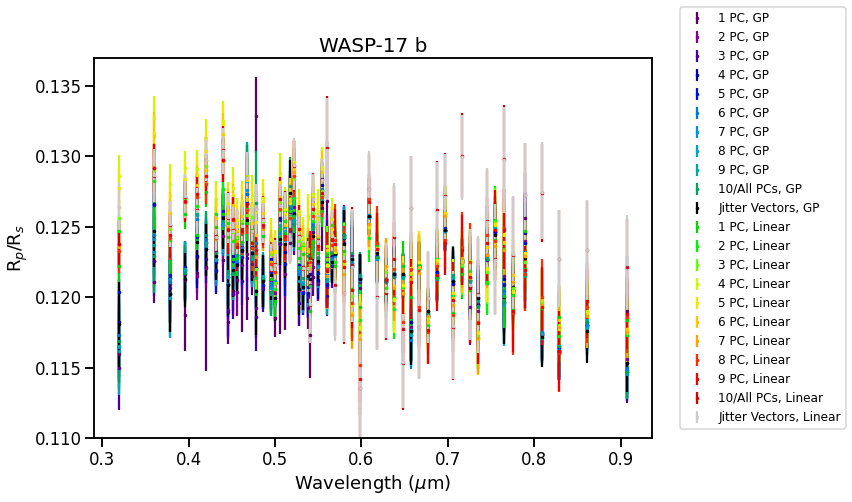

In [85]:
plt.figure(figsize = (10,7))
colormap = plt.cm.nipy_spectral
colors = colormap(np.linspace(0, 1, 25))

plt.errorbar(np.array(bins_joint_pc1_p)/10000, rp_joint_pc1_p, yerr = np.array(rp_e_joint_pc1_p).T, fmt = ".", label = "1 PC, GP", color = colors[1])
plt.errorbar(np.array(bins_joint_pc2_p)/10000, rp_joint_pc2_p, yerr = np.array(rp_e_joint_pc2_p).T, fmt = ".", label = "2 PC, GP", color = colors[2])
plt.errorbar(np.array(bins_joint_pc3_p)/10000, rp_joint_pc3_p, yerr = np.array(rp_e_joint_pc3_p).T, fmt = ".", label = "3 PC, GP", color = colors[3])
plt.errorbar(np.array(bins_joint_pc4_p)/10000, rp_joint_pc4_p, yerr = np.array(rp_e_joint_pc4_p).T, fmt = ".", label = "4 PC, GP", color = colors[4])
plt.errorbar(np.array(bins_joint_pc5_p)/10000, rp_joint_pc5_p, yerr = np.array(rp_e_joint_pc5_p).T, fmt = ".", label = "5 PC, GP", color = colors[5])
plt.errorbar(np.array(bins_joint_pc6_p)/10000, rp_joint_pc6_p, yerr = np.array(rp_e_joint_pc6_p).T, fmt = ".", label = "6 PC, GP", color = colors[6])
plt.errorbar(np.array(bins_joint_pc7_p)/10000, rp_joint_pc7_p, yerr = np.array(rp_e_joint_pc7_p).T, fmt = ".", label = "7 PC, GP", color = colors[7])
plt.errorbar(np.array(bins_joint_pc8_p)/10000, rp_joint_pc8_p, yerr = np.array(rp_e_joint_pc8_p).T, fmt = ".", label = "8 PC, GP", color = colors[8])
plt.errorbar(np.array(bins_joint_pc9_p)/10000, rp_joint_pc9_p, yerr = np.array(rp_e_joint_pc9_p).T, fmt = ".", label = "9 PC, GP", color = colors[9])
plt.errorbar(np.array(bins_joint_pc_p)/10000, rp_joint_pc_p, yerr = np.array(rp_e_joint_pc_p).T, fmt = ".", label = "10/All PCs, GP", color = colors[10])
plt.errorbar(np.array(bins_joint_dd_p)/10000, rp_joint_dd_p, yerr = np.array(rp_e_joint_dd_p).T, fmt = ".", label = "Jitter Vectors, GP", color = colors[0])

plt.errorbar(np.array(bins_joint_dd_lin_pc1_p)/10000, rp_joint_dd_lin_pc1_p, yerr = np.array(rp_e_joint_dd_lin_pc1_p).T, fmt = ".", label = "1 PC, Linear", color = colors[13])
plt.errorbar(np.array(bins_joint_dd_lin_pc2_p)/10000, rp_joint_dd_lin_pc2_p, yerr = np.array(rp_e_joint_dd_lin_pc2_p).T, fmt = ".", label = "2 PC, Linear", color = colors[14])
plt.errorbar(np.array(bins_joint_dd_lin_pc3_p)/10000, rp_joint_dd_lin_pc3_p, yerr = np.array(rp_e_joint_dd_lin_pc3_p).T, fmt = ".", label = "3 PC, Linear", color = colors[15])
plt.errorbar(np.array(bins_joint_dd_lin_pc4_p)/10000, rp_joint_dd_lin_pc4_p, yerr = np.array(rp_e_joint_dd_lin_pc4_p).T, fmt = ".", label = "4 PC, Linear", color = colors[16])
plt.errorbar(np.array(bins_joint_dd_lin_pc5_p)/10000, rp_joint_dd_lin_pc5_p, yerr = np.array(rp_e_joint_dd_lin_pc5_p).T, fmt = ".", label = "5 PC, Linear", color = colors[17])
plt.errorbar(np.array(bins_joint_dd_lin_pc6_p)/10000, rp_joint_dd_lin_pc6_p, yerr = np.array(rp_e_joint_dd_lin_pc6_p).T, fmt = ".", label = "6 PC, Linear", color = colors[18])
plt.errorbar(np.array(bins_joint_dd_lin_pc7_p)/10000, rp_joint_dd_lin_pc7_p, yerr = np.array(rp_e_joint_dd_lin_pc7_p).T, fmt = ".", label = "7 PC, Linear", color = colors[19])
plt.errorbar(np.array(bins_joint_dd_lin_pc8_p)/10000, rp_joint_dd_lin_pc8_p, yerr = np.array(rp_e_joint_dd_lin_pc8_p).T, fmt = ".", label = "8 PC, Linear", color = colors[20])
plt.errorbar(np.array(bins_joint_dd_lin_pc9_p)/10000, rp_joint_dd_lin_pc9_p, yerr = np.array(rp_e_joint_dd_lin_pc9_p).T, fmt = ".", label = "9 PC, Linear", color = colors[21])
plt.errorbar(np.array(bins_joint_dd_lin_pc_p)/10000, rp_joint_dd_lin_pc_p, yerr = np.array(rp_e_joint_dd_lin_pc_p).T, fmt = ".", label = "10/All PCs, Linear", color = colors[22])
plt.errorbar(np.array(bins_joint_dd_lin_p)/10000, rp_joint_dd_lin_p, yerr = np.array(rp_e_joint_dd_lin_p).T, fmt = ".", label = "Jitter Vectors, Linear", color = colors[24])

plt.errorbar(np.array(bins_7_nf_pc1_p)/10000, rp_7_nf_pc1_p, yerr = np.array(rp_e_7_nf_pc1_p).T, fmt = ".", color = colors[1])
plt.errorbar(np.array(bins_7_nf_pc2_p)/10000, rp_7_nf_pc2_p, yerr = np.array(rp_e_7_nf_pc2_p).T, fmt = ".", color = colors[2])
plt.errorbar(np.array(bins_7_nf_pc3_p)/10000, rp_7_nf_pc3_p, yerr = np.array(rp_e_7_nf_pc3_p).T, fmt = ".", color = colors[3])
plt.errorbar(np.array(bins_7_nf_pc4_p)/10000, rp_7_nf_pc4_p, yerr = np.array(rp_e_7_nf_pc4_p).T, fmt = ".", color = colors[4])
plt.errorbar(np.array(bins_7_nf_pc5_p)/10000, rp_7_nf_pc5_p, yerr = np.array(rp_e_7_nf_pc5_p).T, fmt = ".", color = colors[5])
plt.errorbar(np.array(bins_7_nf_pc6_p)/10000, rp_7_nf_pc6_p, yerr = np.array(rp_e_7_nf_pc6_p).T, fmt = ".", color = colors[6])
plt.errorbar(np.array(bins_7_nf_pc7_p)/10000, rp_7_nf_pc7_p, yerr = np.array(rp_e_7_nf_pc7_p).T, fmt = ".", color = colors[7])
plt.errorbar(np.array(bins_7_nf_pc8_p)/10000, rp_7_nf_pc8_p, yerr = np.array(rp_e_7_nf_pc8_p).T, fmt = ".", color = colors[8])
plt.errorbar(np.array(bins_7_nf_pc9_p)/10000, rp_7_nf_pc9_p, yerr = np.array(rp_e_7_nf_pc9_p).T, fmt = ".", color = colors[9])
plt.errorbar(np.array(bins_7_nf_pc_p)/10000, rp_7_nf_pc_p, yerr = np.array(rp_e_7_nf_pc_p).T, fmt = ".", color = colors[10])
plt.errorbar(np.array(bins_7_nf_dd_p)/10000, rp_7_nf_dd_p, yerr = np.array(rp_e_7_nf_dd_p).T, fmt = ".", color = colors[0])

plt.errorbar(np.array(bins_7_nf_lin_pc1_p)/10000, rp_7_nf_lin_pc1_p, yerr = np.array(rp_e_7_nf_lin_pc1_p).T, fmt = ".", color = colors[13])
plt.errorbar(np.array(bins_7_nf_lin_pc2_p)/10000, rp_7_nf_lin_pc2_p, yerr = np.array(rp_e_7_nf_lin_pc2_p).T, fmt = ".", color = colors[14])
plt.errorbar(np.array(bins_7_nf_lin_pc3_p)/10000, rp_7_nf_lin_pc3_p, yerr = np.array(rp_e_7_nf_lin_pc3_p).T, fmt = ".", color = colors[15])
plt.errorbar(np.array(bins_7_nf_lin_pc4_p)/10000, rp_7_nf_lin_pc4_p, yerr = np.array(rp_e_7_nf_lin_pc4_p).T, fmt = ".", color = colors[16])
plt.errorbar(np.array(bins_7_nf_lin_pc5_p)/10000, rp_7_nf_lin_pc5_p, yerr = np.array(rp_e_7_nf_lin_pc5_p).T, fmt = ".", color = colors[17])
plt.errorbar(np.array(bins_7_nf_lin_pc6_p)/10000, rp_7_nf_lin_pc6_p, yerr = np.array(rp_e_7_nf_lin_pc6_p).T, fmt = ".", color = colors[18])
plt.errorbar(np.array(bins_7_nf_lin_pc7_p)/10000, rp_7_nf_lin_pc7_p, yerr = np.array(rp_e_7_nf_lin_pc7_p).T, fmt = ".", color = colors[19])
plt.errorbar(np.array(bins_7_nf_lin_pc8_p)/10000, rp_7_nf_lin_pc8_p, yerr = np.array(rp_e_7_nf_lin_pc8_p).T, fmt = ".", color = colors[20])
plt.errorbar(np.array(bins_7_nf_lin_pc9_p)/10000, rp_7_nf_lin_pc9_p, yerr = np.array(rp_e_7_nf_lin_pc9_p).T, fmt = ".", color = colors[21])
plt.errorbar(np.array(bins_7_nf_lin_pc_p)/10000, rp_7_nf_lin_pc_p, yerr = np.array(rp_e_7_nf_lin_pc_p).T, fmt = ".", color = colors[22])
plt.errorbar(np.array(bins_7_nf_lin_dd_p)/10000, rp_7_nf_lin_dd_p, yerr = np.array(rp_e_7_nf_lin_dd_p).T, fmt = ".", color = colors[24])

plt.ylim(0.11, 0.137)
p = plt.legend(loc=(1.05,0.025), prop={'size':12})
plt.ylabel(r"R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b", fontsize=20)
#plt.savefig("w17b.png", dpi = 300, facecolor = "white", bbox_extra_artists=(p,), bbox_inches='tight')

Text(0.5, 1.0, 'WASP-17 b')

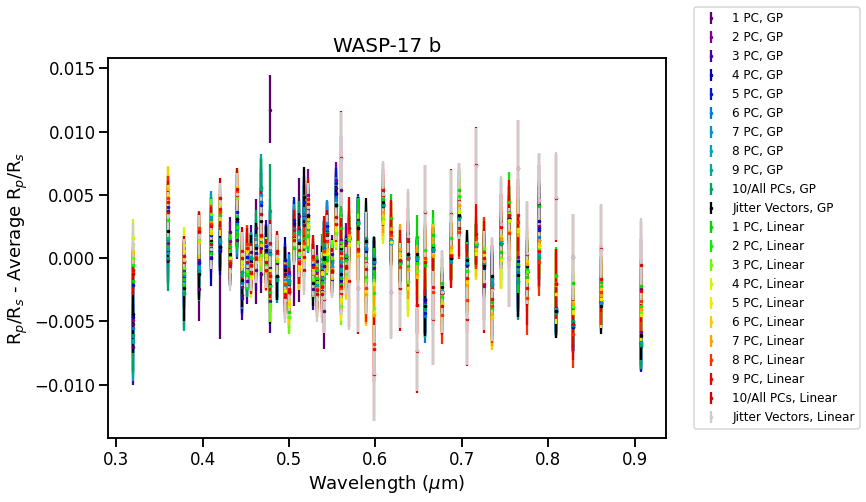

In [86]:
plt.figure(figsize = (10,7))
colormap = plt.cm.nipy_spectral
colors = colormap(np.linspace(0, 1, 25))

plt.errorbar(np.array(bins_joint_pc1_p)/10000, rp_joint_pc1_p-np.nanmedian(rp_joint_pc1_p), yerr = np.array(rp_e_joint_pc1_p).T, fmt = ".", label = "1 PC, GP", color = colors[1])
plt.errorbar(np.array(bins_joint_pc2_p)/10000, rp_joint_pc2_p-np.nanmedian(rp_joint_pc2_p), yerr = np.array(rp_e_joint_pc2_p).T, fmt = ".", label = "2 PC, GP", color = colors[2])
plt.errorbar(np.array(bins_joint_pc3_p)/10000, rp_joint_pc3_p-np.nanmedian(rp_joint_pc3_p), yerr = np.array(rp_e_joint_pc3_p).T, fmt = ".", label = "3 PC, GP", color = colors[3])
plt.errorbar(np.array(bins_joint_pc4_p)/10000, rp_joint_pc4_p-np.nanmedian(rp_joint_pc4_p), yerr = np.array(rp_e_joint_pc4_p).T, fmt = ".", label = "4 PC, GP", color = colors[4])
plt.errorbar(np.array(bins_joint_pc5_p)/10000, rp_joint_pc5_p-np.nanmedian(rp_joint_pc5_p), yerr = np.array(rp_e_joint_pc5_p).T, fmt = ".", label = "5 PC, GP", color = colors[5])
plt.errorbar(np.array(bins_joint_pc6_p)/10000, rp_joint_pc6_p-np.nanmedian(rp_joint_pc6_p), yerr = np.array(rp_e_joint_pc6_p).T, fmt = ".", label = "6 PC, GP", color = colors[6])
plt.errorbar(np.array(bins_joint_pc7_p)/10000, rp_joint_pc7_p-np.nanmedian(rp_joint_pc7_p), yerr = np.array(rp_e_joint_pc7_p).T, fmt = ".", label = "7 PC, GP", color = colors[7])
plt.errorbar(np.array(bins_joint_pc8_p)/10000, rp_joint_pc8_p-np.nanmedian(rp_joint_pc8_p), yerr = np.array(rp_e_joint_pc8_p).T, fmt = ".", label = "8 PC, GP", color = colors[8])
plt.errorbar(np.array(bins_joint_pc9_p)/10000, rp_joint_pc9_p-np.nanmedian(rp_joint_pc9_p), yerr = np.array(rp_e_joint_pc9_p).T, fmt = ".", label = "9 PC, GP", color = colors[9])
plt.errorbar(np.array(bins_joint_pc_p)/10000, rp_joint_pc_p-np.nanmedian(rp_joint_pc_p), yerr = np.array(rp_e_joint_pc_p).T, fmt = ".", label = "10/All PCs, GP", color = colors[10])
plt.errorbar(np.array(bins_joint_dd_p)/10000, rp_joint_dd_p-np.nanmedian(rp_joint_dd_p), yerr = np.array(rp_e_joint_dd_p).T, fmt = ".", label = "Jitter Vectors, GP", color = colors[0])

plt.errorbar(np.array(bins_joint_dd_lin_pc1_p)/10000, rp_joint_dd_lin_pc1_p-np.nanmedian(rp_joint_dd_lin_pc1_p), yerr = np.array(rp_e_joint_dd_lin_pc1_p).T, fmt = ".", label = "1 PC, Linear", color = colors[13])
plt.errorbar(np.array(bins_joint_dd_lin_pc2_p)/10000, rp_joint_dd_lin_pc2_p-np.nanmedian(rp_joint_dd_lin_pc2_p), yerr = np.array(rp_e_joint_dd_lin_pc2_p).T, fmt = ".", label = "2 PC, Linear", color = colors[14])
plt.errorbar(np.array(bins_joint_dd_lin_pc3_p)/10000, rp_joint_dd_lin_pc3_p-np.nanmedian(rp_joint_dd_lin_pc3_p), yerr = np.array(rp_e_joint_dd_lin_pc3_p).T, fmt = ".", label = "3 PC, Linear", color = colors[15])
plt.errorbar(np.array(bins_joint_dd_lin_pc4_p)/10000, rp_joint_dd_lin_pc4_p-np.nanmedian(rp_joint_dd_lin_pc4_p), yerr = np.array(rp_e_joint_dd_lin_pc4_p).T, fmt = ".", label = "4 PC, Linear", color = colors[16])
plt.errorbar(np.array(bins_joint_dd_lin_pc5_p)/10000, rp_joint_dd_lin_pc5_p-np.nanmedian(rp_joint_dd_lin_pc5_p), yerr = np.array(rp_e_joint_dd_lin_pc5_p).T, fmt = ".", label = "5 PC, Linear", color = colors[17])
plt.errorbar(np.array(bins_joint_dd_lin_pc6_p)/10000, rp_joint_dd_lin_pc6_p-np.nanmedian(rp_joint_dd_lin_pc6_p), yerr = np.array(rp_e_joint_dd_lin_pc6_p).T, fmt = ".", label = "6 PC, Linear", color = colors[18])
plt.errorbar(np.array(bins_joint_dd_lin_pc7_p)/10000, rp_joint_dd_lin_pc7_p-np.nanmedian(rp_joint_dd_lin_pc7_p), yerr = np.array(rp_e_joint_dd_lin_pc7_p).T, fmt = ".", label = "7 PC, Linear", color = colors[19])
plt.errorbar(np.array(bins_joint_dd_lin_pc8_p)/10000, rp_joint_dd_lin_pc8_p-np.nanmedian(rp_joint_dd_lin_pc8_p), yerr = np.array(rp_e_joint_dd_lin_pc8_p).T, fmt = ".", label = "8 PC, Linear", color = colors[20])
plt.errorbar(np.array(bins_joint_dd_lin_pc9_p)/10000, rp_joint_dd_lin_pc9_p-np.nanmedian(rp_joint_dd_lin_pc9_p), yerr = np.array(rp_e_joint_dd_lin_pc9_p).T, fmt = ".", label = "9 PC, Linear", color = colors[21])
plt.errorbar(np.array(bins_joint_dd_lin_pc_p)/10000, rp_joint_dd_lin_pc_p-np.nanmedian(rp_joint_dd_lin_pc_p), yerr = np.array(rp_e_joint_dd_lin_pc_p).T, fmt = ".", label = "10/All PCs, Linear", color = colors[22])
plt.errorbar(np.array(bins_joint_dd_lin_p)/10000, rp_joint_dd_lin_p-np.nanmedian(rp_joint_dd_lin_p), yerr = np.array(rp_e_joint_dd_lin_p).T, fmt = ".", label = "Jitter Vectors, Linear", color = colors[24])

plt.errorbar(np.array(bins_7_nf_pc1_p)/10000, rp_7_nf_pc1_p-np.nanmedian(rp_7_nf_pc1_p), yerr = np.array(rp_e_7_nf_pc1_p).T, fmt = ".", color = colors[1])
plt.errorbar(np.array(bins_7_nf_pc2_p)/10000, rp_7_nf_pc2_p-np.nanmedian(rp_7_nf_pc2_p), yerr = np.array(rp_e_7_nf_pc2_p).T, fmt = ".", color = colors[2])
plt.errorbar(np.array(bins_7_nf_pc3_p)/10000, rp_7_nf_pc3_p-np.nanmedian(rp_7_nf_pc3_p), yerr = np.array(rp_e_7_nf_pc3_p).T, fmt = ".", color = colors[3])
plt.errorbar(np.array(bins_7_nf_pc4_p)/10000, rp_7_nf_pc4_p-np.nanmedian(rp_7_nf_pc4_p), yerr = np.array(rp_e_7_nf_pc4_p).T, fmt = ".", color = colors[4])
plt.errorbar(np.array(bins_7_nf_pc5_p)/10000, rp_7_nf_pc5_p-np.nanmedian(rp_7_nf_pc5_p), yerr = np.array(rp_e_7_nf_pc5_p).T, fmt = ".", color = colors[5])
plt.errorbar(np.array(bins_7_nf_pc6_p)/10000, rp_7_nf_pc6_p-np.nanmedian(rp_7_nf_pc6_p), yerr = np.array(rp_e_7_nf_pc6_p).T, fmt = ".", color = colors[6])
plt.errorbar(np.array(bins_7_nf_pc7_p)/10000, rp_7_nf_pc7_p-np.nanmedian(rp_7_nf_pc7_p), yerr = np.array(rp_e_7_nf_pc7_p).T, fmt = ".", color = colors[7])
plt.errorbar(np.array(bins_7_nf_pc8_p)/10000, rp_7_nf_pc8_p-np.nanmedian(rp_7_nf_pc8_p), yerr = np.array(rp_e_7_nf_pc8_p).T, fmt = ".", color = colors[8])
plt.errorbar(np.array(bins_7_nf_pc9_p)/10000, rp_7_nf_pc9_p-np.nanmedian(rp_7_nf_pc9_p), yerr = np.array(rp_e_7_nf_pc9_p).T, fmt = ".", color = colors[9])
plt.errorbar(np.array(bins_7_nf_pc_p)/10000, rp_7_nf_pc_p-np.nanmedian(rp_7_nf_pc_p), yerr = np.array(rp_e_7_nf_pc_p).T, fmt = ".", color = colors[10])
plt.errorbar(np.array(bins_7_nf_dd_p)/10000, rp_7_nf_dd_p-np.nanmedian(rp_7_nf_dd_p), yerr = np.array(rp_e_7_nf_dd_p).T, fmt = ".", color = colors[0])

plt.errorbar(np.array(bins_7_nf_lin_pc1_p)/10000, rp_7_nf_lin_pc1_p-np.nanmedian(rp_7_nf_lin_pc1_p), yerr = np.array(rp_e_7_nf_lin_pc1_p).T, fmt = ".", color = colors[13])
plt.errorbar(np.array(bins_7_nf_lin_pc2_p)/10000, rp_7_nf_lin_pc2_p-np.nanmedian(rp_7_nf_lin_pc2_p), yerr = np.array(rp_e_7_nf_lin_pc2_p).T, fmt = ".", color = colors[14])
plt.errorbar(np.array(bins_7_nf_lin_pc3_p)/10000, rp_7_nf_lin_pc3_p-np.nanmedian(rp_7_nf_lin_pc3_p), yerr = np.array(rp_e_7_nf_lin_pc3_p).T, fmt = ".", color = colors[15])
plt.errorbar(np.array(bins_7_nf_lin_pc4_p)/10000, rp_7_nf_lin_pc4_p-np.nanmedian(rp_7_nf_lin_pc4_p), yerr = np.array(rp_e_7_nf_lin_pc4_p).T, fmt = ".", color = colors[16])
plt.errorbar(np.array(bins_7_nf_lin_pc5_p)/10000, rp_7_nf_lin_pc5_p-np.nanmedian(rp_7_nf_lin_pc5_p), yerr = np.array(rp_e_7_nf_lin_pc5_p).T, fmt = ".", color = colors[17])
plt.errorbar(np.array(bins_7_nf_lin_pc6_p)/10000, rp_7_nf_lin_pc6_p-np.nanmedian(rp_7_nf_lin_pc6_p), yerr = np.array(rp_e_7_nf_lin_pc6_p).T, fmt = ".", color = colors[18])
plt.errorbar(np.array(bins_7_nf_lin_pc7_p)/10000, rp_7_nf_lin_pc7_p-np.nanmedian(rp_7_nf_lin_pc7_p), yerr = np.array(rp_e_7_nf_lin_pc7_p).T, fmt = ".", color = colors[19])
plt.errorbar(np.array(bins_7_nf_lin_pc8_p)/10000, rp_7_nf_lin_pc8_p-np.nanmedian(rp_7_nf_lin_pc8_p), yerr = np.array(rp_e_7_nf_lin_pc8_p).T, fmt = ".", color = colors[20])
plt.errorbar(np.array(bins_7_nf_lin_pc9_p)/10000, rp_7_nf_lin_pc9_p-np.nanmedian(rp_7_nf_lin_pc9_p), yerr = np.array(rp_e_7_nf_lin_pc9_p).T, fmt = ".", color = colors[21])
plt.errorbar(np.array(bins_7_nf_lin_pc_p)/10000, rp_7_nf_lin_pc_p-np.nanmedian(rp_7_nf_lin_pc_p), yerr = np.array(rp_e_7_nf_lin_pc_p).T, fmt = ".", color = colors[22])
plt.errorbar(np.array(bins_7_nf_lin_dd_p)/10000, rp_7_nf_lin_dd_p-np.nanmedian(rp_7_nf_lin_dd_p), yerr = np.array(rp_e_7_nf_lin_dd_p).T, fmt = ".", color = colors[24])

#plt.ylim(0.11, 0.14)
p = plt.legend(loc=(1.05,0.025), prop={'size':12})
plt.ylabel(r"R$_p$/R$_s$ - Average R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b", fontsize=20)
#plt.hlines(0, 0.3, 0.9, linestyle = "--")
#plt.savefig("w17b_subtracted.png", dpi = 300, facecolor = "white", bbox_extra_artists=(p,), bbox_inches='tight')

Text(0.5, 1.0, 'WASP-17 b')

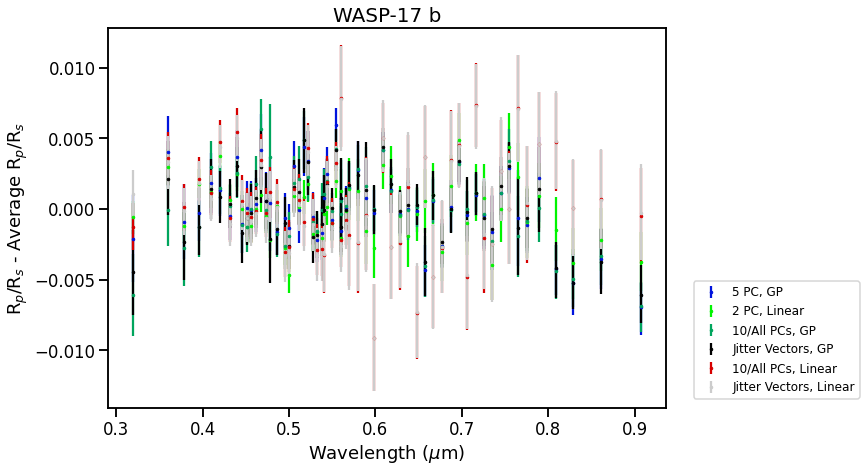

In [87]:
# comparing linear and gp fits with high and low numbers of detrending vectors

plt.figure(figsize = (10,7))
colormap = plt.cm.nipy_spectral
colors = colormap(np.linspace(0, 1, 25))

plt.errorbar(np.array(bins_joint_pc5_p)/10000, rp_joint_pc5_p-np.nanmedian(rp_joint_pc5_p), yerr = np.array(rp_e_joint_pc5_p).T, fmt = ".", label = "5 PC, GP", color = colors[5])
plt.errorbar(np.array(bins_7_nf_pc5_p)/10000, rp_7_nf_pc5_p-np.nanmedian(rp_7_nf_pc5_p), yerr = np.array(rp_e_7_nf_pc5_p).T, fmt = ".", color = colors[5])

#plt.errorbar(np.array(bins_joint_dd_lin_pc1_p)/10000, rp_joint_dd_lin_pc1_p-np.nanmedian(rp_joint_dd_lin_pc1_p), yerr = np.array(rp_e_joint_dd_lin_pc1_p).T, fmt = ".", label = "1 PC, Linear", color = colors[13])
#plt.errorbar(np.array(bins_joint_pc2_p)/10000, rp_joint_pc2_p-np.nanmedian(rp_joint_pc2_p), yerr = np.array(rp_e_joint_pc2_p).T, fmt = ".", label = "2 PC, GP", color = colors[2])
#plt.errorbar(np.array(bins_7_nf_pc2_p)/10000, rp_7_nf_pc2_p-np.nanmedian(rp_7_nf_pc2_p), yerr = np.array(rp_e_7_nf_pc2_p).T, fmt = ".", color = colors[2])

plt.errorbar(np.array(bins_joint_dd_lin_pc2_p)/10000, rp_joint_dd_lin_pc2_p-np.nanmedian(rp_joint_dd_lin_pc2_p), yerr = np.array(rp_e_joint_dd_lin_pc2_p).T, fmt = ".", label = "2 PC, Linear", color = colors[14])
plt.errorbar(np.array(bins_7_nf_lin_pc2_p)/10000, rp_7_nf_lin_pc2_p-np.nanmedian(rp_7_nf_lin_pc2_p), yerr = np.array(rp_e_7_nf_lin_pc2_p).T, fmt = ".", color = colors[14])

plt.errorbar(np.array(bins_joint_pc_p)/10000, rp_joint_pc_p-np.nanmedian(rp_joint_pc_p), yerr = np.array(rp_e_joint_pc_p).T, fmt = ".", label = "10/All PCs, GP", color = colors[10])
plt.errorbar(np.array(bins_joint_dd_p)/10000, rp_joint_dd_p-np.nanmedian(rp_joint_dd_p), yerr = np.array(rp_e_joint_dd_p).T, fmt = ".", label = "Jitter Vectors, GP", color = colors[0])

plt.errorbar(np.array(bins_joint_dd_lin_pc_p)/10000, rp_joint_dd_lin_pc_p-np.nanmedian(rp_joint_dd_lin_pc_p), yerr = np.array(rp_e_joint_dd_lin_pc_p).T, fmt = ".", label = "10/All PCs, Linear", color = colors[22])
plt.errorbar(np.array(bins_joint_dd_lin_p)/10000, rp_joint_dd_lin_p-np.nanmedian(rp_joint_dd_lin_p), yerr = np.array(rp_e_joint_dd_lin_p).T, fmt = ".", label = "Jitter Vectors, Linear", color = colors[24])

#plt.errorbar(np.array(bins_7_nf_lin_pc1_p)/10000, rp_7_nf_lin_pc1_p-np.nanmedian(rp_7_nf_lin_pc1_p), yerr = np.array(rp_e_7_nf_lin_pc1_p).T, fmt = ".", color = colors[13])
#plt.errorbar(np.array(bins_7_nf_pc1_p)/10000, rp_7_nf_pc1_p-np.nanmedian(rp_7_nf_pc1_p), yerr = np.array(rp_e_7_nf_pc1_p).T, fmt = ".", color = colors[1])

plt.errorbar(np.array(bins_7_nf_pc_p)/10000, rp_7_nf_pc_p-np.nanmedian(rp_7_nf_pc_p), yerr = np.array(rp_e_7_nf_pc_p).T, fmt = ".", color = colors[10])
plt.errorbar(np.array(bins_7_nf_dd_p)/10000, rp_7_nf_dd_p-np.nanmedian(rp_7_nf_dd_p), yerr = np.array(rp_e_7_nf_dd_p).T, fmt = ".", color = colors[0])

plt.errorbar(np.array(bins_7_nf_lin_pc_p)/10000, rp_7_nf_lin_pc_p-np.nanmedian(rp_7_nf_lin_pc_p), yerr = np.array(rp_e_7_nf_lin_pc_p).T, fmt = ".", color = colors[22])
plt.errorbar(np.array(bins_7_nf_lin_dd_p)/10000, rp_7_nf_lin_dd_p-np.nanmedian(rp_7_nf_lin_dd_p), yerr = np.array(rp_e_7_nf_lin_dd_p).T, fmt = ".", color = colors[24])

#plt.ylim(0.11, 0.14)
p = plt.legend(loc=(1.05,0.025), prop={'size':12})
plt.ylabel(r"R$_p$/R$_s$ - Average R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b", fontsize=20)
#plt.hlines(0, 0.3, 0.9, linestyle = "--")
#plt.savefig("w17_subtracted_variance.png", dpi = 300, facecolor = "white", bbox_extra_artists=(p,), bbox_inches='tight')

Text(0.5, 1.0, 'WASP-17 b, G430L GP')

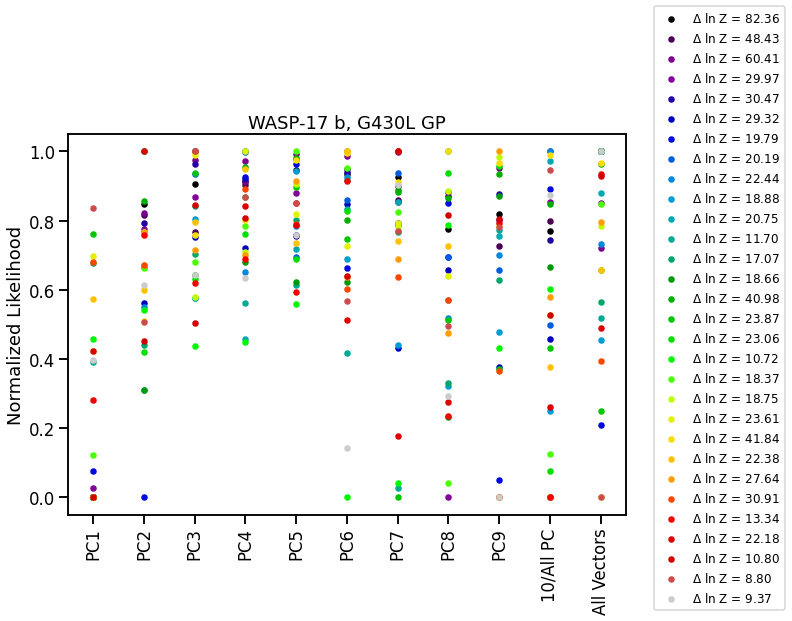

In [88]:
plt.figure(figsize = (10,7))
tests_gp = [fits_pc1_p, fits_pc2_p, fits_pc3_p, fits_pc4_p, fits_pc5_p, fits_pc6_p, fits_pc7_p, fits_pc8_p, fits_pc9_p, fits_pc_p, fits_jitter_p]
normalized = []
ranges = []
for i in range(len(tests_gp[0])):
    minimum = min([x[i][0] for x in tests_gp])
    maximum = max([x[i][0] for x in tests_gp])
    min_sub = [x[i][0] for x in tests_gp] - minimum
    new_max = max(min_sub)
    norm_inbet = []
    ranges.append(maximum-minimum)
    for j in min_sub:
        norm_inbet.append((j-new_max)/new_max + 1)
    normalized.append(norm_inbet)

labels = ["PC1", "PC2", "PC3", "PC4", "PC5", "PC6", "PC7", "PC8", "PC9", "10/All PC", "All Vectors"]
colormap = plt.cm.nipy_spectral
colors = colormap(np.linspace(0, 1, len(fits_pc_p)))
j = 0
for i in normalized:
    #plt.title("Bin " + str(j+1))
    plt.scatter(np.linspace(1,10,11), i, color = colors[j], label = r"$\Delta$ ln Z = " + "{:.2f}".format(ranges[j]))
    j = j+1
    plt.xticks(np.linspace(1,10,11), labels, rotation = 90)
plt.ylabel("Normalized Likelihood")
p = plt.legend(loc=(1.05,-0.25),  prop={'size':12})
plt.title("WASP-17 b, G430L GP")
#plt.savefig("w17b_likelihood_g430l_gp.png", dpi = 300, facecolor = "white", bbox_extra_artists=(p,), bbox_inches='tight')

Text(0.5, 1.0, 'WASP-17 b, G430L Linear')

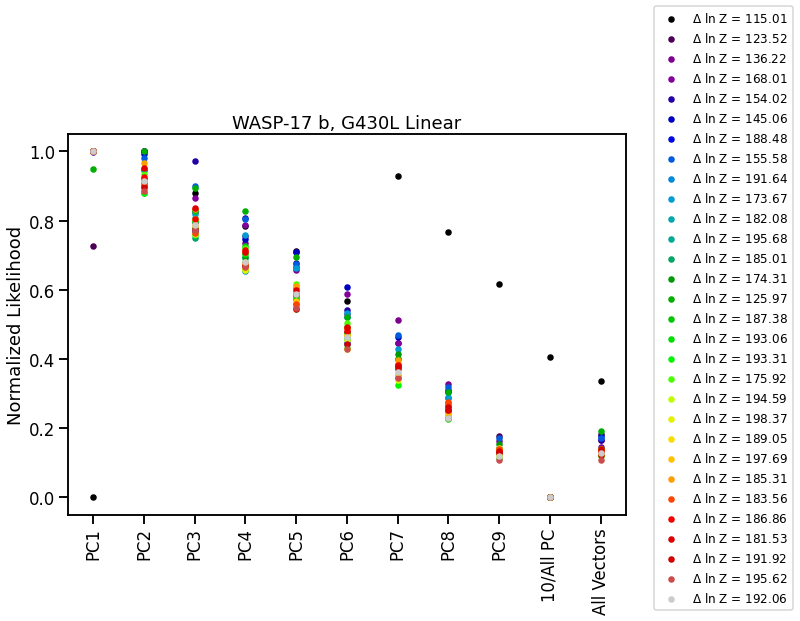

In [89]:
plt.figure(figsize = (10,7))
tests_lin = [fits_lin_pc1_p, fits_lin_pc2_p, fits_lin_pc3_p, fits_lin_pc4_p, fits_lin_pc5_p, fits_lin_pc6_p, fits_lin_pc7_p, fits_lin_pc8_p, fits_lin_pc9_p, fits_lin_pc_p, fits_linear_p]
normalized = []
ranges = []
for i in range(len(tests_lin[0])):
    minimum = min([x[i][0] for x in tests_lin])
    maximum = max([x[i][0] for x in tests_lin])
    min_sub = [x[i][0] for x in tests_lin] - minimum
    new_max = max(min_sub)
    norm_inbet = []
    ranges.append(maximum-minimum)
    for j in min_sub:
        norm_inbet.append((j-new_max)/new_max + 1)
    normalized.append(norm_inbet)

labels = ["PC1", "PC2", "PC3", "PC4", "PC5", "PC6", "PC7", "PC8", "PC9", "10/All PC", "All Vectors"]
colormap = plt.cm.nipy_spectral
colors = colormap(np.linspace(0, 1, len(fits_pc_p)))
j = 0
for i in normalized:
    #plt.title("Bin " + str(j+1))
    plt.scatter(np.linspace(1,10,11), i, color = colors[j], label = r"$\Delta$ ln Z = " + "{:.2f}".format(ranges[j]))
    j = j+1
    plt.xticks(np.linspace(1,10,11), labels, rotation = 90)
plt.ylabel("Normalized Likelihood")
p = plt.legend(loc=(1.05,-0.25),  prop={'size':12})
plt.title("WASP-17 b, G430L Linear")
#plt.savefig("w17b_likelihood_g430l_linear.png", dpi = 300, facecolor = "white", bbox_extra_artists=(p,), bbox_inches='tight')


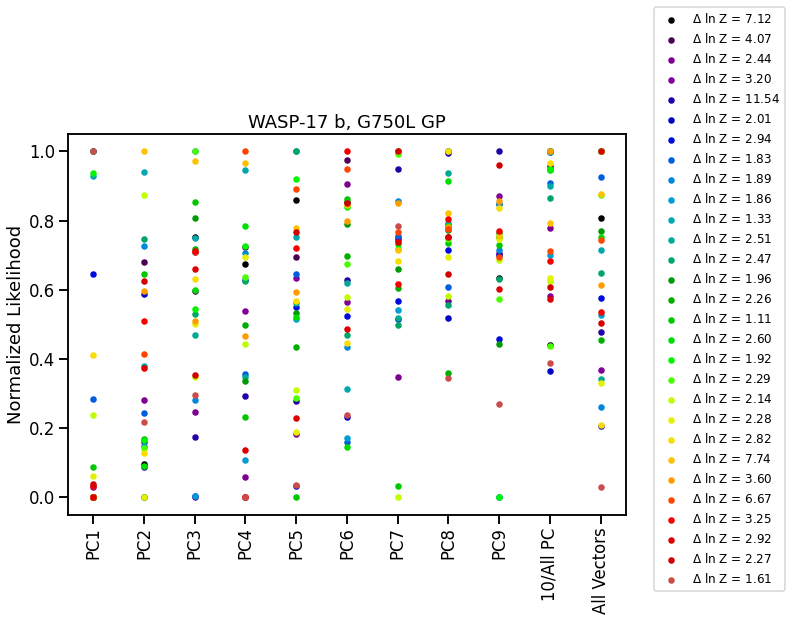

In [90]:
plt.figure(figsize = (10,7))
tests_gp_7 = [fits_7_dd_pc1_p, fits_7_dd_pc2_p, fits_7_dd_pc3_p, fits_7_dd_pc4_p, fits_7_dd_pc5_p, fits_7_dd_pc6_p, fits_7_dd_pc7_p, fits_7_dd_pc8_p, fits_7_dd_pc9_p, fits_7_dd_pc_p, fits_7_dd_p]
normalized = []
ranges = []
for i in range(len(tests_gp_7[0])):
    minimum = min([x[i][0] for x in tests_gp_7])
    maximum = max([x[i][0] for x in tests_gp_7])
    min_sub = [x[i][0] for x in tests_gp_7] - minimum
    new_max = max(min_sub)
    norm_inbet = []
    ranges.append(maximum-minimum)
    for j in min_sub:
        norm_inbet.append((j-new_max)/new_max + 1)
    normalized.append(norm_inbet)

labels = ["PC1", "PC2", "PC3", "PC4", "PC5", "PC6", "PC7", "PC8", "PC9", "10/All PC", "All Vectors"]
colormap = plt.cm.nipy_spectral
colors = colormap(np.linspace(0, 1, len(fits_pc_p)))
j = 0
for i in normalized:
    #plt.title("Bin " + str(j+1))
    plt.scatter(np.linspace(1,10,11), i, color = colors[j], label = r"$\Delta$ ln Z = " + "{:.2f}".format(ranges[j]))
    j = j+1
    plt.xticks(np.linspace(1,10,11), labels, rotation = 90)
    
plt.ylabel("Normalized Likelihood")    
plt.title("WASP-17 b, G750L GP")
p = plt.legend(loc=(1.05,-0.2),  prop={'size':12})
#plt.savefig("w17b_likelihood_g750l_gp.png", dpi = 300, facecolor = "white", bbox_extra_artists=(p,), bbox_inches = "tight")    


Text(0.5, 1.0, 'WASP-17 b, G750L Linear')

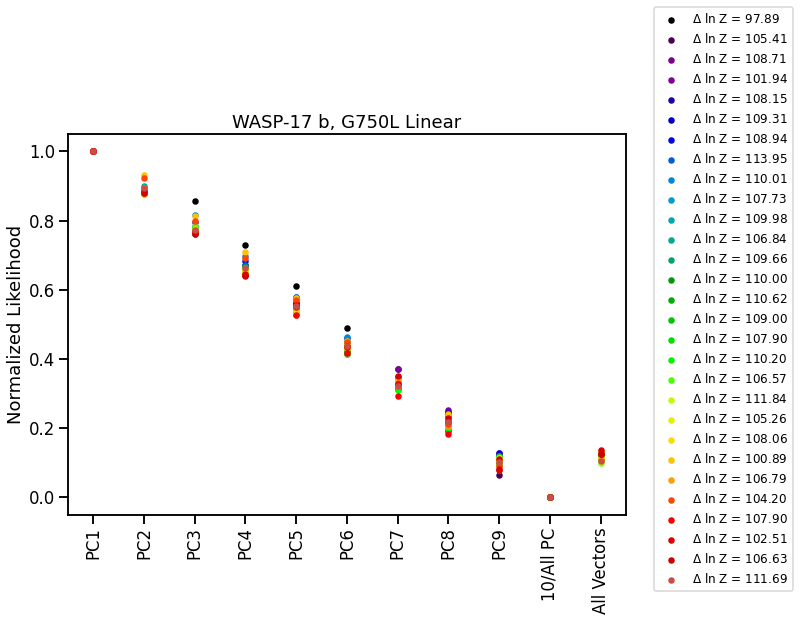

In [91]:
plt.figure(figsize = (10,7))
tests_lin_7 = [fits_7_lin_dd_pc1_p, fits_7_lin_dd_pc2_p, fits_7_lin_dd_pc3_p, fits_7_lin_dd_pc4_p, fits_7_lin_dd_pc5_p, fits_7_lin_dd_pc6_p, fits_7_lin_dd_pc7_p, fits_7_lin_dd_pc8_p, fits_7_lin_dd_pc9_p, fits_7_lin_dd_pc_p, fits_7_lin_dd_p]
normalized = []
ranges = []
for i in range(len(tests_lin_7[0])):
    minimum = min([x[i][0] for x in tests_lin_7])
    maximum = max([x[i][0] for x in tests_lin_7])
    #print(minimum)
    min_sub = [x[i][0] for x in tests_lin_7] - minimum
    new_max = max(min_sub)
    norm_inbet = []
    ranges.append(maximum-minimum)
    for j in min_sub:
        norm_inbet.append((j-new_max)/new_max + 1)
    normalized.append(norm_inbet)

labels = ["PC1", "PC2", "PC3", "PC4", "PC5", "PC6", "PC7", "PC8", "PC9", "10/All PC", "All Vectors"]
colormap = plt.cm.nipy_spectral
colors = colormap(np.linspace(0, 1, len(fits_pc_p)))
j = 0
for i in normalized:
    #plt.title("Bin " + str(j+1))
    plt.scatter(np.linspace(1,10,11), i, color = colors[j], label = r"$\Delta$ ln Z = " + "{:.2f}".format(ranges[j]))
    j = j+1
    plt.xticks(np.linspace(1,10,11), labels, rotation = 90)
plt.ylabel("Normalized Likelihood") 
p = plt.legend(loc=(1.05,-0.2),  prop={'size':12})
plt.title("WASP-17 b, G750L Linear")
#plt.savefig("w17b_likelihood_g750l_linear.png", dpi = 300, facecolor = "white", bbox_extra_artists=(p,), bbox_inches = "tight")    

In [92]:
# with the final detrending vectors decided, we run our final fits
# first, white light curves
gp_fit_joint_final = joint_white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_use5_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_use5_430_2, sys_method = "gp", juliet_name = "wasp-17_430_joint_newt_pc_dynamic_newpriors_rho_uniform_final", gp_kernel = "Matern", limb_darkening = "fixed", sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_joint_newt_pc_dynamic_newpriors_rho_uniform_final/_dynesty_DNS_posteriors.pkl


In [93]:
linear_fit_joint_final = joint_white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_use2_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_use2_430_2, sys_method = "linear", juliet_name = "wasp-17_430_joint_linear_final", limb_darkening = "fixed", sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_joint_linear_final/_dynesty_DNS_posteriors.pkl


In [94]:
gp_fit_750_final = white_light_fit(params_750, times_start_750_less, lc_750_less, lc_err_750_less, norm_pc_use5_750, sys_method = "gp", juliet_name = "wasp-17_750_gp_final", gp_kernel = "Matern", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_gp_final/_dynesty_DNS_posteriors.pkl


In [95]:
linear_fit_750_final = white_light_fit(params_750, times_start_750_less, lc_750_less, lc_err_750_less, norm_pc_use2_750, sys_method = "linear", juliet_name = "wasp-17_750_linear_final", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_linear_final/_dynesty_DNS_posteriors.pkl


(0.976, 1.004)

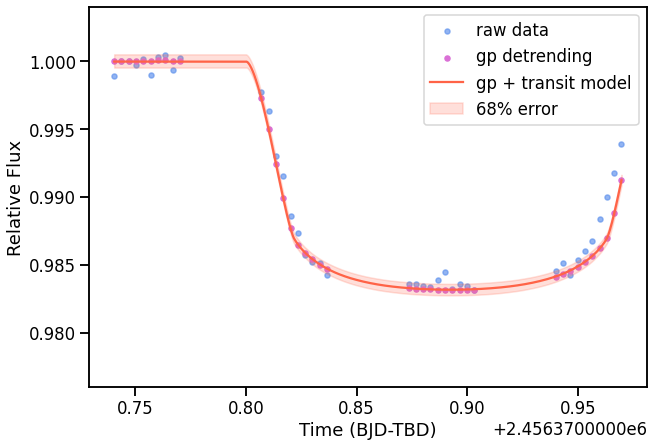

In [96]:
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_750_less[0], times_start_750_less[-1], 1000)
transit_plus_GP_model = gp_fit_750_final.lc.evaluate('STIS')
transit_model = gp_fit_750_final.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_750_final.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = np.nanmedian(gp_fit_750_final.posteriors['posterior_samples']['mflux_STIS'])
plt.scatter(times_start_750_less, (lc_750_less/np.median(lc_750_less[:10])), label = "raw data", color = "cornflowerblue", alpha = 0.7)
plt.scatter(times_start_750_less, (lc_750_less/np.median(lc_750_less[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(np.linspace(times_start_750_less[0], times_start_750_less[-1], 1000), transit_model_resamp + offset, color='tomato',zorder=10, label = "gp + transit model")
plt.fill_between(t_final, error68_up+offset, error68_down+offset, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.ylim(0.976, 1.004)
#plt.savefig("w17b_gp_750.png", dpi = 300, facecolor = "white")

(0.976, 1.004)

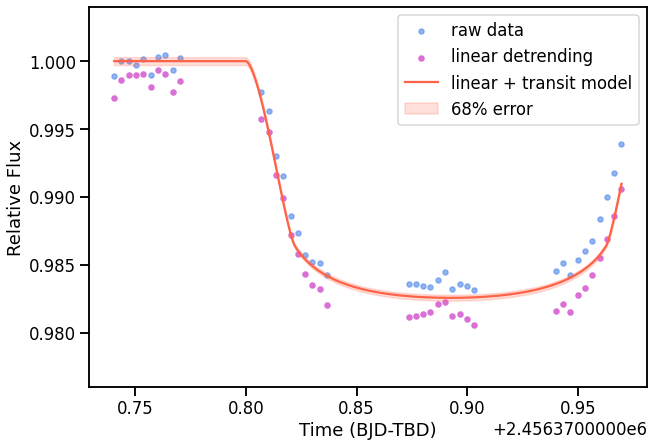

In [97]:
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_750_less[0], times_start_750_less[-1], 1000)

transit_plus_GP_model = linear_fit_750_final.lc.evaluate('STIS')
transit_model = linear_fit_750_final.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = linear_fit_750_final.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = np.nanmedian(linear_fit_750_final.posteriors['posterior_samples']['mflux_STIS'])
plt.scatter(times_start_750_less, (lc_750_less/np.median(lc_750_less[:10])), label = "raw data", color = "cornflowerblue", alpha = 0.7)
plt.scatter(times_start_750_less, (lc_750_less/np.median(lc_750_less[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "linear detrending", color = "orchid")
plt.plot(np.linspace(times_start_750_less[0], times_start_750_less[-1], 1000), transit_model_resamp + offset, color='tomato',zorder=10, label = "linear + transit model")
plt.fill_between(t_final, error68_up+offset, error68_down+offset, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.ylim(0.976, 1.004)
#plt.savefig("w17b_linear_750.png", dpi = 300, facecolor = "white")

(0.976, 1.004)

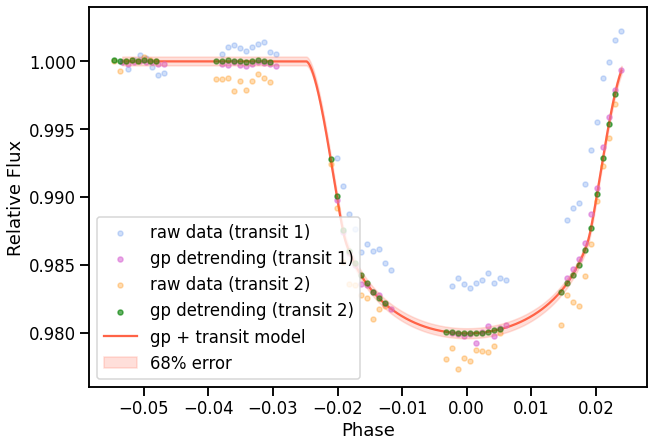

In [98]:
plt.figure(figsize = (10,7))

phases = juliet.utils.get_phases(times_start_430, params_430["P"], params_430["t0"])
phases_2 = juliet.utils.get_phases(times_start_430_2, params_430["P"], params_430["t0"])

transit_plus_GP_model1 = gp_fit_joint_final.lc.evaluate('STIS1')
transit_model1 = gp_fit_joint_final.lc.evaluate('STIS1', evaluate_transit = True)

gp_model1 = transit_plus_GP_model1 - transit_model1

transit_plus_GP_model2 = gp_fit_joint_final.lc.evaluate('STIS2')
transit_model2 = gp_fit_joint_final.lc.evaluate('STIS2', evaluate_transit = True)

gp_model2 = transit_plus_GP_model2 - transit_model2

offset1 = np.nanmedian(gp_fit_joint_final.posteriors['posterior_samples']['mflux_STIS1'])
offset2 = np.nanmedian(gp_fit_joint_final.posteriors['posterior_samples']['mflux_STIS2'])

t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_model2_resamp, error68_up, error68_down = gp_fit_joint_final.lc.evaluate('STIS2', evaluate_transit = True, t = t_final, return_err = True)
model_phases = juliet.utils.get_phases(t_final, params_430["P"], params_430["t0"])

offset3 = np.nanmedian(gp_fit_joint_final.posteriors['posterior_samples']['mflux_STIS2'])

plt.scatter(phases, (lc_430/np.median(lc_430[:10])),alpha=0.3, label = "raw data (transit 1)", color = "cornflowerblue",)
plt.scatter(phases, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model1 - transit_model1) + offset1,alpha=0.6, label = "gp detrending (transit 1)", color = "orchid")

plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])),alpha=0.3, label = "raw data (transit 2)", color = "darkorange",)
plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model2 - transit_model2) + offset2,alpha=0.6, label = "gp detrending (transit 2)", color = "green")

plt.plot(model_phases, transit_model2_resamp + offset3, color = "tomato", label = "gp + transit model", zorder = 0)
plt.fill_between(model_phases, error68_up+offset3, error68_down+offset3, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Phase")
plt.ylim(0.976, 1.004)
#plt.savefig("w17b_gp_430.png", dpi = 300, facecolor = "white")

(0.976, 1.004)

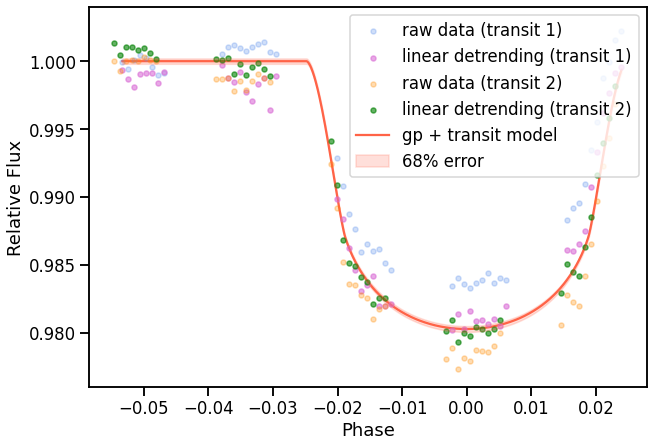

In [99]:
plt.figure(figsize = (10,7))

phases = juliet.utils.get_phases(times_start_430, params_430["P"], params_430["t0"])
phases_2 = juliet.utils.get_phases(times_start_430_2, params_430["P"], params_430["t0"])

transit_plus_GP_model1 = linear_fit_joint_final.lc.evaluate('STIS1')
transit_model1 = linear_fit_joint_final.lc.evaluate('STIS1', evaluate_transit = True)

gp_model1 = transit_plus_GP_model1 - transit_model1

transit_plus_GP_model2 = linear_fit_joint_final.lc.evaluate('STIS2')
transit_model2 = linear_fit_joint_final.lc.evaluate('STIS2', evaluate_transit = True)

gp_model2 = transit_plus_GP_model2 - transit_model2

offset1 = np.nanmedian(linear_fit_joint_final.posteriors['posterior_samples']['mflux_STIS1'])
offset2 = np.nanmedian(linear_fit_joint_final.posteriors['posterior_samples']['mflux_STIS2'])

t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_model2_resamp, error68_up, error68_down = linear_fit_joint_final.lc.evaluate('STIS2', evaluate_transit = True, t = t_final, return_err = True)
model_phases = juliet.utils.get_phases(t_final, params_430["P"], params_430["t0"])

offset3 = np.nanmedian(linear_fit_joint_final.posteriors['posterior_samples']['mflux_STIS2'])

plt.scatter(phases, (lc_430/np.median(lc_430[:10])),alpha=0.3, label = "raw data (transit 1)", color = "cornflowerblue",)
plt.scatter(phases, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model1 - transit_model1) + offset1,alpha=0.6, label = "linear detrending (transit 1)", color = "orchid")

plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])),alpha=0.3, label = "raw data (transit 2)", color = "darkorange",)
plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model2 - transit_model2) + offset2,alpha=0.6, label = "linear detrending (transit 2)", color = "green")

plt.plot(model_phases, transit_model2_resamp + offset3, color = "tomato", label = "gp + transit model", zorder = 0)
plt.fill_between(model_phases, error68_up+offset3, error68_down+offset3, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Phase")
plt.ylim(0.976, 1.004)
#plt.savefig("w17b_linear_430.png", dpi = 300, facecolor = "white")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_pha

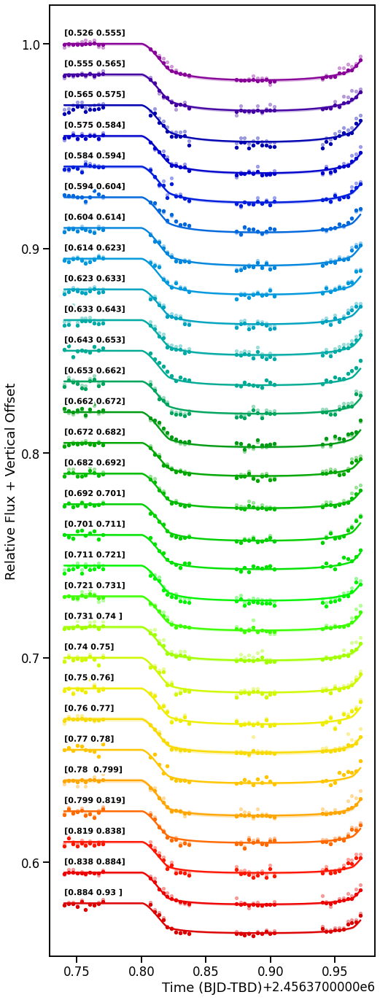

In [100]:
# final best-fit spectroscopic light curves
bins_7_nf_pc5_p, rp_7_nf_pc5_p, rp_e_7_nf_pc5_p, fits_7_dd_pc5_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use5_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc5_phase",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True, 
                                                    savefig = False)

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

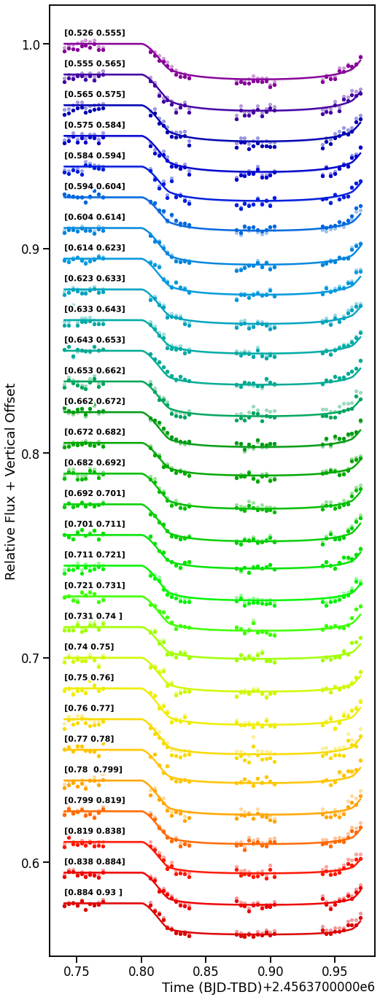

In [101]:
bins_7_nf_lin_pc2_p, rp_7_nf_lin_pc2_p, rp_e_7_nf_lin_pc2_p, fits_7_lin_dd_pc2_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use2_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc2_linear_phase",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True,
                                                    savefig = False)

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fi

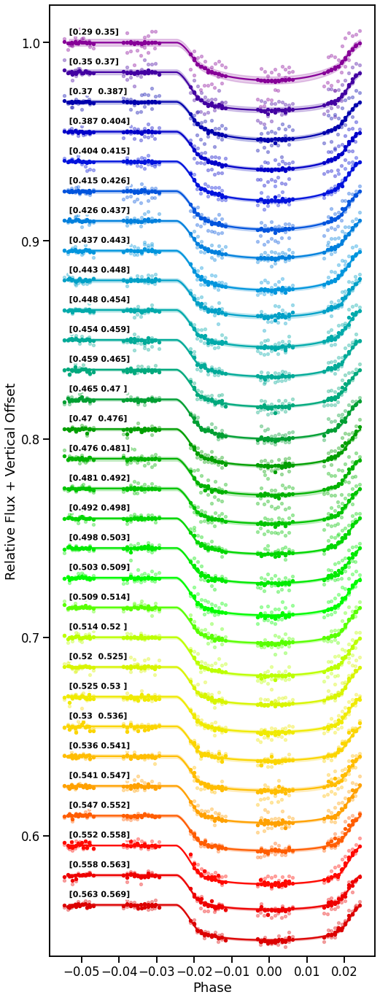

In [102]:
bins_joint_pc5_p, rp_joint_pc5_p, rp_e_joint_pc5_p, fits_pc5_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use5_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use5_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False)

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

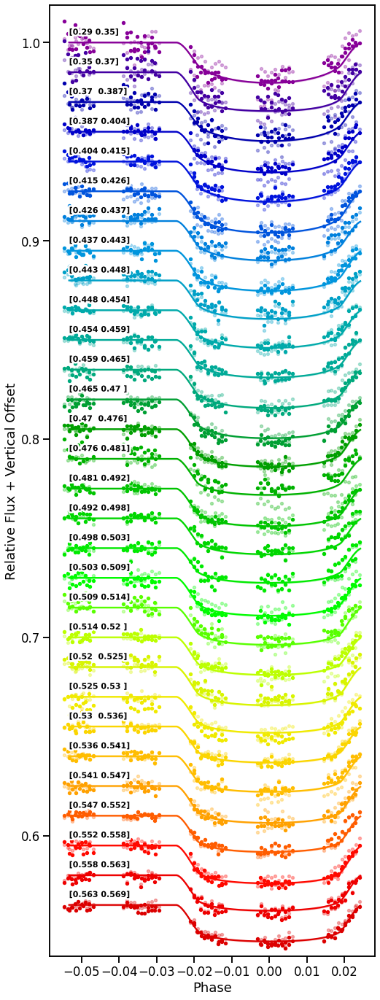

In [103]:
bins_joint_dd_lin_pc2_p, rp_joint_dd_lin_pc2_p, rp_e_joint_dd_lin_pc2_p, fits_lin_pc2_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use2_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use2_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False)
                                                                      

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin/wasp-17_750_dd_less_pc5_phase_bin_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin/wasp-17_750_dd_less_pc5_phase_bin_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin/wasp-17_750_dd_less_pc5_phase_bin_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin/wasp-17_750_dd_less_pc5_phase_bin_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin/wasp-17_750_dd_less_pc5_phase_bin_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_le

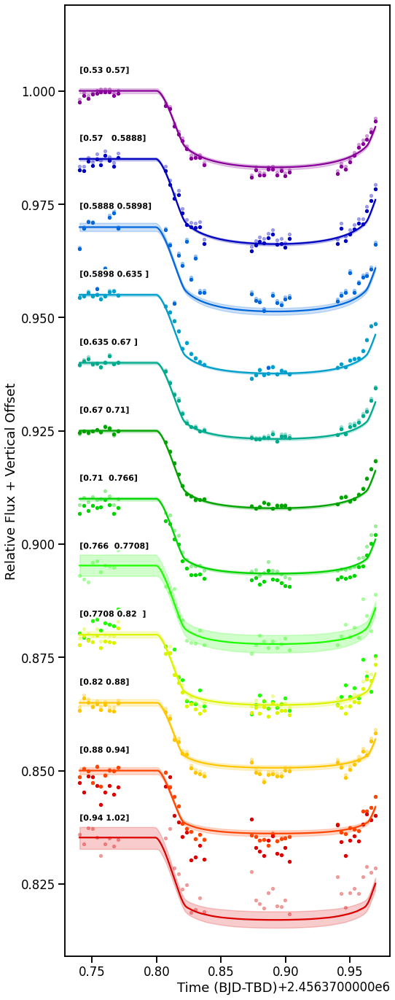

In [104]:
# same as above but with the binning from alderson et al. 2022 for direct comparison
bins_7_nf_pc5_p_a, rp_7_nf_pc5_p_a, rp_e_7_nf_pc5_p_a, fits_7_dd_pc5_p_a = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use5_750,\
                                                    "wasp-17_g750_bins.txt", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc5_phase_bin",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True,
                                                    savefig = False, fig_name = "w17b_750_gp_slc.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin/wasp-17_750_dd_less_pc2_linear_phase_bin_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin/wasp-17_750_dd_less_pc2_linear_phase_bin_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin/wasp-17_750_dd_less_pc2_linear_phase_bin_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin/wasp-17_750_dd_less_pc2_linear_phase_bin_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin/wasp-17_750_dd_less_pc2_linear_phase_bin_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty 

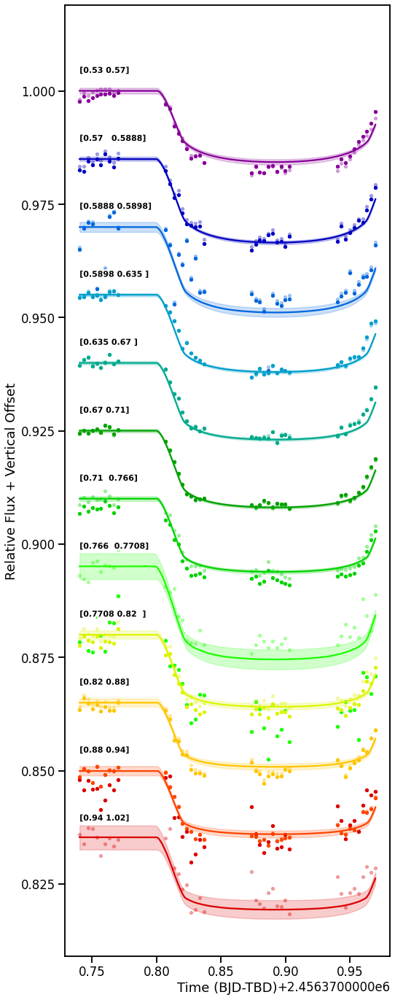

In [105]:
bins_7_nf_lin_pc2_p_a, rp_7_nf_lin_pc2_p_a, rp_e_7_nf_lin_pc2_p_a, fits_7_lin_dd_pc2_p_a = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use2_750,\
                                                    "wasp-17_g750_bins.txt", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc2_linear_phase_bin",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True,\
                                                    savefig = False, fig_name = "w17b_750_linear_slc.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin/wa

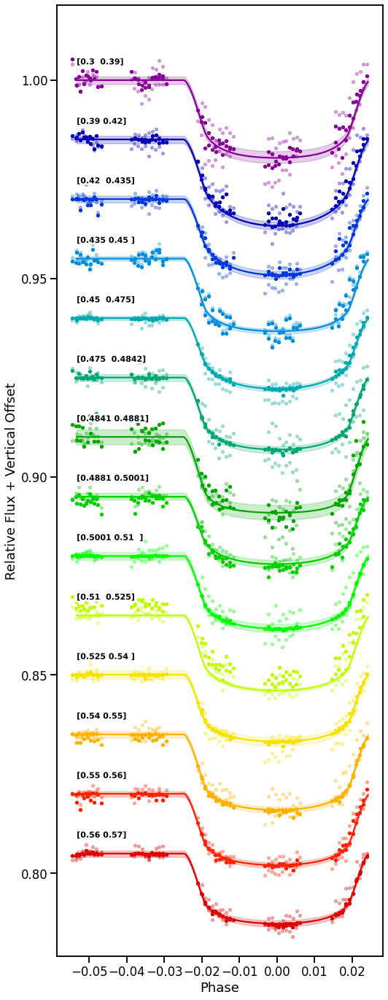

In [106]:
bins_joint_pc5_p_a, rp_joint_pc5_p_a, rp_e_joint_pc5_p_a, fits_pc5_p_a = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use5_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use5_430_2,\
                                                                      "wasp-17_g430_bins.txt", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w17b_430_gp_slc.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fit

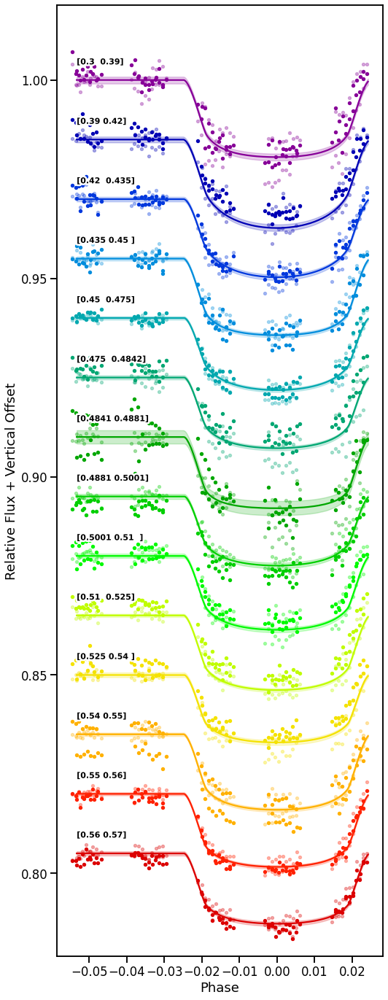

In [107]:
bins_joint_dd_lin_pc2_p_a, rp_joint_dd_lin_pc2_p_a, rp_e_joint_dd_lin_pc2_p_a, fits_lin_pc2_p_a = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use2_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use2_430_2,\
                                                                      "wasp-17_g430_bins.txt", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w17b_430_linear_slc.png")
                                                                      

In [108]:
# let's save these depths to files
bins_gp = np.concatenate((np.array(bins_joint_pc5_p_a)/10000, np.array(bins_7_nf_pc5_p_a)/10000))
rps_gp = np.concatenate((rp_joint_pc5_p_a, rp_7_nf_pc5_p_a))
err_gp = np.concatenate((rp_e_joint_pc5_p_a, rp_e_7_nf_pc5_p_a))

bins_lin = np.concatenate((np.array(bins_joint_dd_lin_pc2_p_a)/10000, np.array(bins_7_nf_lin_pc2_p_a)/10000))
rps_lin = np.concatenate((rp_joint_dd_lin_pc2_p_a, rp_7_nf_lin_pc2_p_a))
err_lin = np.concatenate((rp_e_joint_dd_lin_pc2_p_a, rp_e_7_nf_lin_pc2_p_a))

#np.savetxt("w17b_gp_spectrum.txt", list(zip(bins_gp, rps_gp, err_gp[:,0])), fmt='%.18e')
#np.savetxt("w17b_lin_spectrum.txt", list(zip(bins_lin, rps_lin, err_lin[:,0])), fmt='%.18e')

#np.savetxt("w17b_gp_depths_ppm.txt", rps_gp**2*1e6)
#np.savetxt("w17b_gp_errs_1_ppm.txt", 2*err_gp[:,0]*rps_gp*1e6)
#np.savetxt("w17b_gp_errs_2_ppm.txt", 2*err_gp[:,1]*rps_gp*1e6)

#np.savetxt("w17b_lin_depths_ppm.txt", rps_lin**2*1e6)
#np.savetxt("w17b_lin_errs_1_ppm.txt", 2*err_lin[:,0]*rps_lin*1e6)
#np.savetxt("w17b_lin_errs_2_ppm.txt", 2*err_lin[:,1]*rps_lin*1e6)

Text(0.5, 1.0, 'WASP-17 b')

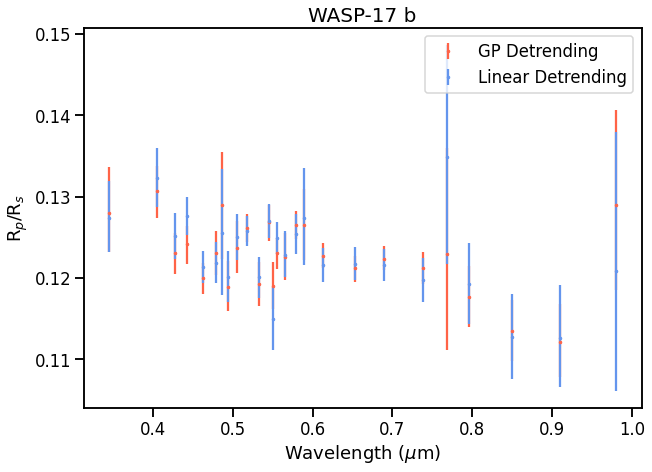

In [109]:
# plot the spectra to compare
plt.figure(figsize = (10,7))

plt.errorbar(np.array(bins_joint_pc5_p_a)/10000, rp_joint_pc5_p_a, yerr = np.array(rp_e_joint_pc5_p_a).T, fmt = ".", color = "tomato")
plt.errorbar(np.array(bins_7_nf_pc5_p_a)/10000, rp_7_nf_pc5_p_a, yerr = np.array(rp_e_7_nf_pc5_p_a).T, fmt = ".", color = "tomato", label = "GP Detrending")

plt.errorbar(np.array(bins_joint_dd_lin_pc2_p_a)/10000, rp_joint_dd_lin_pc2_p_a, yerr = np.array(rp_e_joint_dd_lin_pc2_p_a).T, fmt = ".", color = "cornflowerblue")
plt.errorbar(np.array(bins_7_nf_lin_pc2_p_a)/10000, rp_7_nf_lin_pc2_p_a, yerr = np.array(rp_e_7_nf_lin_pc2_p_a).T, fmt = ".", color = "cornflowerblue", label = "Linear Detrending")

plt.legend()
plt.ylabel(r"R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b", fontsize=20)
#plt.savefig("w17b_spectrum.png", facecolor = "white", dpi = 300, bbox_inches="tight")

In [110]:
# results from alderson et al. 2022 for comparison
alderson = np.loadtxt("alderson_2022.csv", delimiter = ",", encoding='utf-8-sig')

Text(0.5, 1.0, 'WASP-17 b')

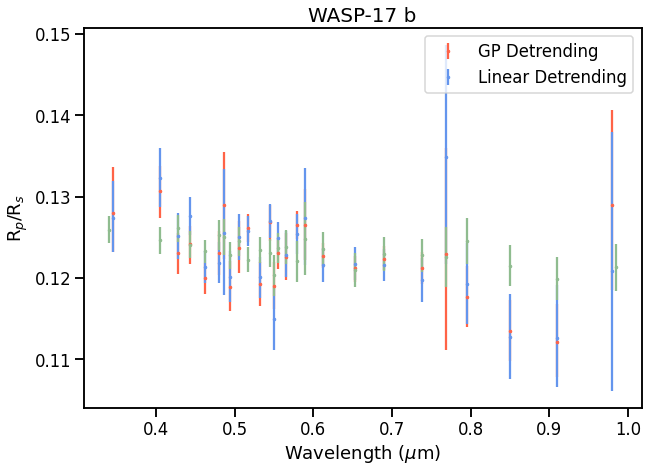

In [111]:
# compare with past results
plt.figure(figsize = (10,7))

plt.errorbar(np.array(bins_joint_pc5_p_a)/10000, rp_joint_pc5_p_a, yerr = np.array(rp_e_joint_pc5_p_a).T, fmt = ".", color = "tomato")
plt.errorbar(np.array(bins_7_nf_pc5_p_a)/10000, rp_7_nf_pc5_p_a, yerr = np.array(rp_e_7_nf_pc5_p_a).T, fmt = ".", color = "tomato", label = "GP Detrending")

plt.errorbar(np.array(bins_joint_dd_lin_pc2_p_a)/10000, rp_joint_dd_lin_pc2_p_a, yerr = np.array(rp_e_joint_dd_lin_pc2_p_a).T, fmt = ".", color = "cornflowerblue")
plt.errorbar(np.array(bins_7_nf_lin_pc2_p_a)/10000, rp_7_nf_lin_pc2_p_a, yerr = np.array(rp_e_7_nf_lin_pc2_p_a).T, fmt = ".", color = "cornflowerblue", label = "Linear Detrending")

plt.errorbar((np.array(alderson[:,0])+np.array(alderson[:,1]))/2, alderson[:,2], alderson[:,3], fmt = ".", color = "darkseagreen")

plt.legend()
plt.ylabel(r"R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b", fontsize=20)
#plt.savefig("w17b_spectrum_comparison.png", facecolor = "white", dpi = 300, bbox_inches="tight")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-1

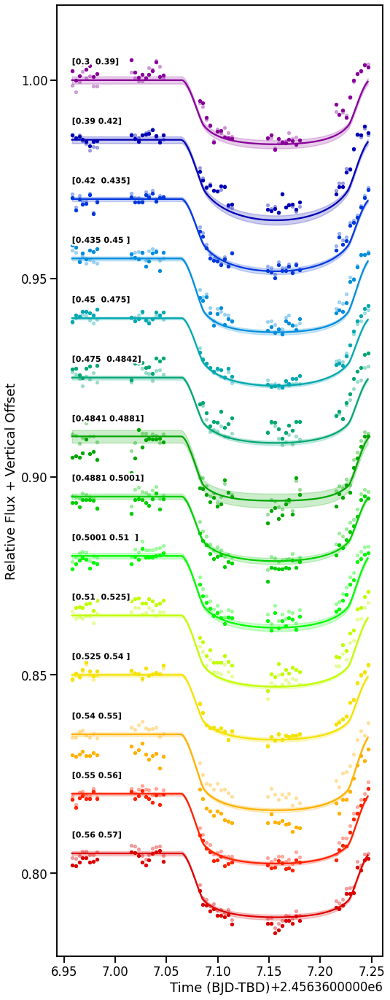

In [112]:
# testing single 430 transit fits to estimate errors
bins_dd_lin_pc2_single_1, rp_dd_lin_pc2_single_1, rp_e_dd_lin_pc2_single_1, fits_lin_pc2_single_1 = spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use2_430,\
                                                                      "wasp-17_g430_bins.txt", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_1",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w17b_430_linear_slc_single_1.png")



Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-1

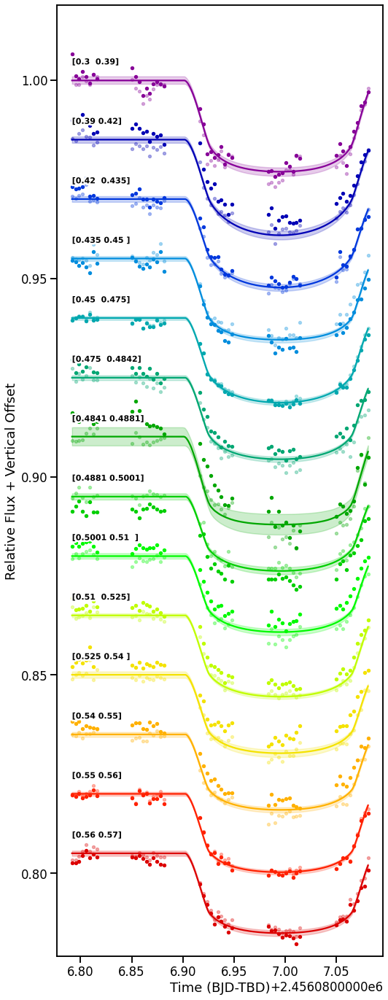

In [113]:
bins_dd_lin_pc2_single_2, rp_dd_lin_pc2_single_2, rp_e_dd_lin_pc2_single_2, fits_lin_pc2_single_2 = spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use2_430_2,\
                                                                      "wasp-17_g430_bins.txt", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_single_2",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w17b_430_linear_slc_single_2.png")



Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1/wasp-17_430

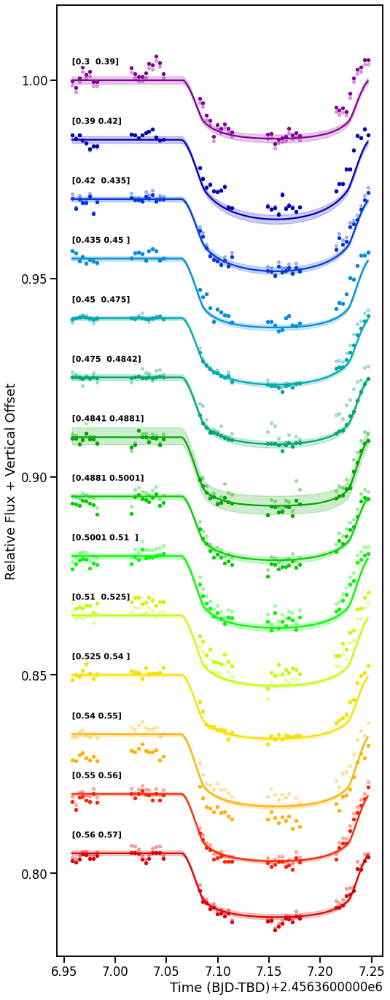

In [114]:
bins_dd_pc5_single_1, rp_dd_pc5_single_1, rp_e_dd_pc5_single_1, fits_pc5_single_1 = spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use5_430,\
                                                                      "wasp-17_g430_bins.txt", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_1",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w17b_430_gp_slc_single_1.png")



Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2/wasp-17_430

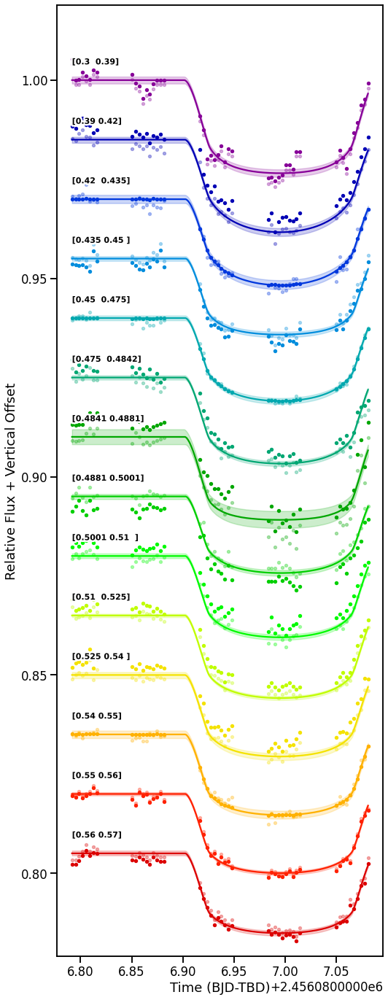

In [115]:
bins_dd_pc5_single_2, rp_dd_pc5_single_2, rp_e_dd_pc5_single_2, fits_pc5_single_2 = spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use5_430_2,\
                                                                      "wasp-17_g430_bins.txt", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_pc5_single_2",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w17b_430_gp_slc_single_2.png")



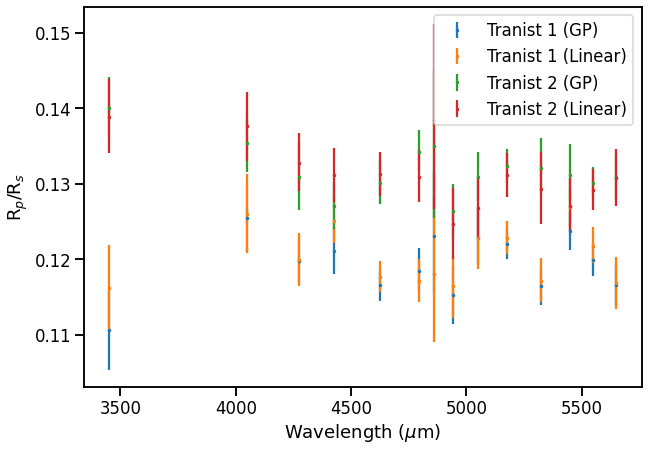

In [116]:
plt.figure(figsize = (10,7))

plt.errorbar(bins_dd_pc5_single_1, rp_dd_pc5_single_1, yerr = np.array(rp_e_dd_pc5_single_1).T, fmt = ".", label = "Tranist 1 (GP)")
plt.errorbar(bins_dd_lin_pc2_single_1, rp_dd_lin_pc2_single_1, yerr = np.array(rp_e_dd_lin_pc2_single_1).T, fmt = ".", label = "Tranist 1 (Linear)")

plt.errorbar(bins_dd_pc5_single_2, rp_dd_pc5_single_2, yerr = np.array(rp_e_dd_pc5_single_2).T, fmt = ".", label = "Tranist 2 (GP)")
plt.errorbar(bins_dd_lin_pc2_single_2, rp_dd_lin_pc2_single_2, yerr = np.array(rp_e_dd_lin_pc2_single_2).T, fmt = ".", label = "Tranist 2 (Linear)")
plt.legend()
plt.ylabel(r"R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.show()


In [117]:
# calculate differences
norm_gp_v1 = rp_dd_pc5_single_1 - np.mean(rp_dd_pc5_single_1)
norm_gp_v2 = rp_dd_pc5_single_2 - np.mean(rp_dd_pc5_single_2)

norm_lin_v1 = rp_dd_lin_pc2_single_1 - np.mean(rp_dd_lin_pc2_single_1)
norm_lin_v2 = rp_dd_lin_pc2_single_2 - np.mean(rp_dd_lin_pc2_single_2)

noise_v1 = norm_gp_v1 - norm_gp_v2
noise_v2 = norm_lin_v1 - norm_lin_v2

Text(0.5, 1.0, 'WASP-17 b')

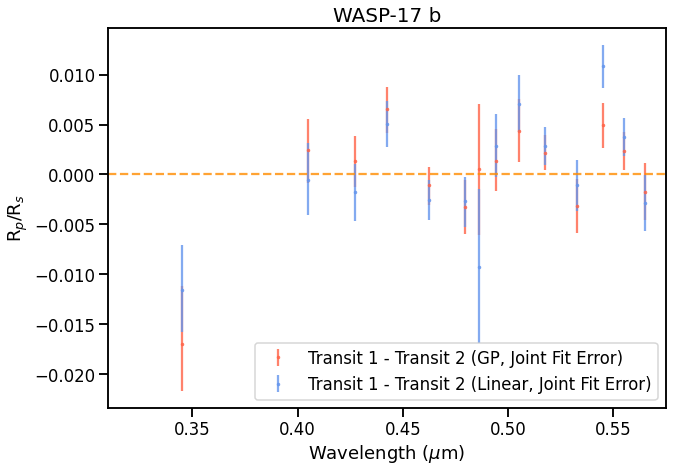

In [118]:
plt.figure(figsize = (10,7))

plt.errorbar(np.array(bins_dd_pc5_single_1)/10000, noise_v1, yerr = np.array(rp_e_joint_pc5_p_a).T, fmt = ".", label = "Transit 1 - Transit 2 (GP, Joint Fit Error)", color = "tomato", alpha = 0.8)
plt.errorbar(np.array(bins_dd_lin_pc2_single_1)/10000, noise_v2, yerr = np.array(rp_e_joint_dd_lin_pc2_p_a).T, fmt = ".", label = "Transit 1 - Transit 2 (Linear, Joint Fit Error)", color = "cornflowerblue", alpha = 0.8)

#plt.errorbar(np.array(bins_dd_pc5_single_2)/10000, noise_v1, yerr = np.array(rp_e_dd_pc5_single_2).T, fmt = ".", label = "Tranist 1 - Transit 2 (GP, Error Transit 2)", color = "orchid", alpha = 0.8)
#plt.errorbar(np.array(bins_dd_lin_pc2_single_2)/10000, noise_v2, yerr = np.array(rp_e_dd_lin_pc2_single_2).T, fmt = ".", label = "Tranist 1 - Transit 2 (Linear, Error Transit 2)", color = "darkseagreen", alpha = 0.8)
plt.hlines(0, 0.31, 0.575, linestyle = "--", color = "darkorange", alpha = 0.8)
plt.xlim(0.31, 0.575)
plt.legend(loc='lower right')
plt.ylabel(r"R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b", fontsize=20)
#plt.savefig("w17b_errortest.png", dpi = 300, facecolor = "white", bbox_inches="tight")


In [119]:
# testing the 6.5 pixel aperture

spectra_430 = []
for i in range(len(transit_430_cleaned)):
    spec = spectral_extraction(transit_430_cleaned[i], trace_430_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12, aperture_radius = 6.5)
    spectra_430.append(spec)

spectra_430_2 = []
for i in range(len(transit_430_2_cleaned)):
    spec = spectral_extraction(transit_430_2_cleaned[i], trace_430_2_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12, aperture_radius = 6.5)
    spectra_430_2.append(spec)
    
spectra_750 = []
for i in range(len(transit_750_cleaned)):
    spec = spectral_extraction(transit_750_cleaned[i], trace_750_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12, aperture_radius = 6.5)
    spectra_750.append(spec)
    
spectra_750_less = spectra_750[8:]

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin_aper/wasp-17_750_dd_less_pc5_phase_bin_aper_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin_aper/wasp-17_750_dd_less_pc5_phase_bin_aper_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin_aper/wasp-17_750_dd_less_pc5_phase_bin_aper_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin_aper/wasp-17_750_dd_less_pc5_phase_bin_aper_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase_bin_aper/wasp-17_750_dd_less_pc5_phase_bin_aper_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files

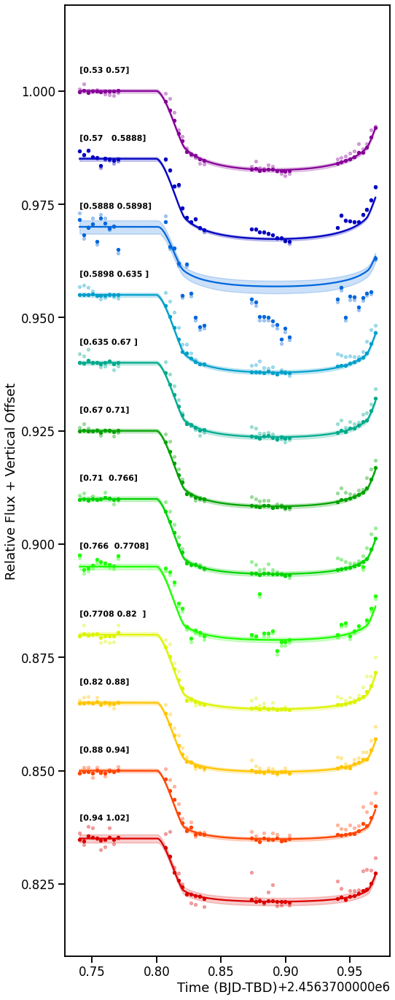

In [120]:
bins_7_nf_pc5_p_a_ap, rp_7_nf_pc5_p_a_ap, rp_e_7_nf_pc5_p_a_ap, fits_7_dd_pc5_p_a_ap = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use5_750,\
                                                    "wasp-17_g750_bins.txt", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc5_phase_bin_aper",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True,
                                                    savefig = False, fig_name = "w17b_750_gp_slc_aper.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin_aper/wasp-17_750_dd_less_pc2_linear_phase_bin_aper_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin_aper/wasp-17_750_dd_less_pc2_linear_phase_bin_aper_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin_aper/wasp-17_750_dd_less_pc2_linear_phase_bin_aper_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin_aper/wasp-17_750_dd_less_pc2_linear_phase_bin_aper_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase_bin_aper/wasp-17_750_dd_less_pc2_linear_phase_bin_aper_bin005/_dy

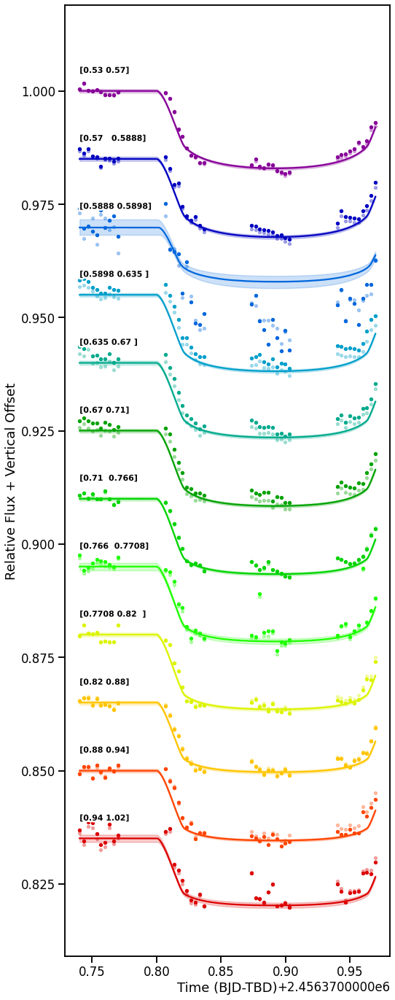

In [121]:
bins_7_nf_lin_pc2_p_a_ap, rp_7_nf_lin_pc2_p_a_ap, rp_e_7_nf_lin_pc2_p_a_ap, fits_7_lin_dd_pc2_p_a_ap = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use2_750,\
                                                    "wasp-17_g750_bins.txt", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc2_linear_phase_bin_aper",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True,\
                                                    savefig = False, fig_name = "w17b_750_linear_slc_aper.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_sp

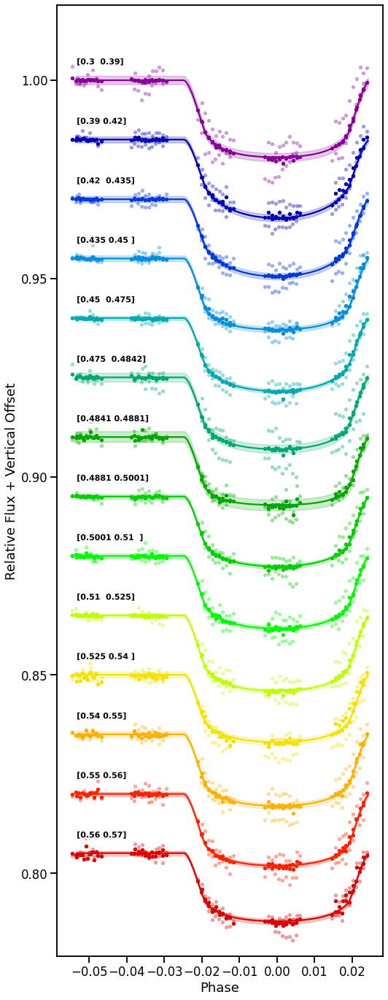

In [122]:
bins_joint_pc5_p_a_ap, rp_joint_pc5_p_a_ap, rp_e_joint_pc5_p_a_ap, fits_pc5_p_a_ap = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use5_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use5_430_2,\
                                                                      "wasp-17_g430_bins.txt", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin_aper",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w17b_430_gp_slc_aper.png")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler out

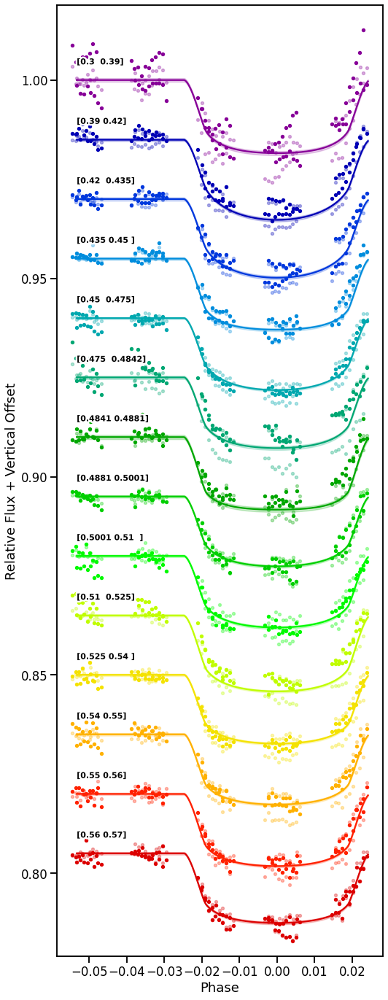

In [123]:
bins_joint_dd_lin_pc2_p_a_ap, rp_joint_dd_lin_pc2_p_a_ap, rp_e_joint_dd_lin_pc2_p_a_ap, fits_lin_pc2_p_a_ap = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use2_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use2_430_2,\
                                                                      "wasp-17_g430_bins.txt", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin_aper",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False, fig_name = "w17b_430_linear_slc_aper.png")
                                                                      

Text(0.5, 1.0, 'WASP-17 b')

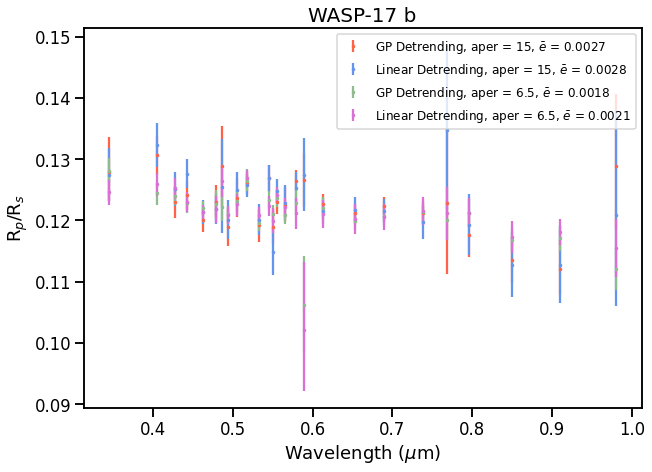

In [124]:
# compare apertures
plt.figure(figsize = (10,7))

plt.errorbar(np.array(bins_joint_pc5_p_a)/10000, rp_joint_pc5_p_a, yerr = np.array(rp_e_joint_pc5_p_a).T, fmt = ".", color = "tomato")
plt.errorbar(np.array(bins_7_nf_pc5_p_a)/10000, rp_7_nf_pc5_p_a, yerr = np.array(rp_e_7_nf_pc5_p_a).T, fmt = ".", color = "tomato", label = r"GP Detrending, aper = 15, $\bar{e}$ = 0.0027")

plt.errorbar(np.array(bins_joint_dd_lin_pc2_p_a)/10000, rp_joint_dd_lin_pc2_p_a, yerr = np.array(rp_e_joint_dd_lin_pc2_p_a).T, fmt = ".", color = "cornflowerblue")
plt.errorbar(np.array(bins_7_nf_lin_pc2_p_a)/10000, rp_7_nf_lin_pc2_p_a, yerr = np.array(rp_e_7_nf_lin_pc2_p_a).T, fmt = ".", color = "cornflowerblue", label = r"Linear Detrending, aper = 15, $\bar{e}$ = 0.0028")

plt.errorbar(np.array(bins_joint_pc5_p_a_ap)/10000, rp_joint_pc5_p_a_ap, yerr = np.array(rp_e_joint_pc5_p_a_ap).T, fmt = ".", color = "darkseagreen")
plt.errorbar(np.array(bins_7_nf_pc5_p_a_ap)/10000, rp_7_nf_pc5_p_a_ap, yerr = np.array(rp_e_7_nf_pc5_p_a_ap).T, fmt = ".", color = "darkseagreen", label = r"GP Detrending, aper = 6.5, $\bar{e}$ = 0.0018")

plt.errorbar(np.array(bins_joint_dd_lin_pc2_p_a_ap)/10000, rp_joint_dd_lin_pc2_p_a_ap, yerr = np.array(rp_e_joint_dd_lin_pc2_p_a_ap).T, fmt = ".", color = "orchid")
plt.errorbar(np.array(bins_7_nf_lin_pc2_p_a_ap)/10000, rp_7_nf_lin_pc2_p_a_ap, yerr = np.array(rp_e_7_nf_lin_pc2_p_a_ap).T, fmt = ".", color = "orchid", label = r"Linear Detrending, aper = 6.5, $\bar{e}$ = 0.0021")

plt.legend(fontsize = 12)
plt.ylabel(r"R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b", fontsize=20)
#plt.savefig("w17b_spectrum_aper.png", facecolor = "white", dpi = 300, bbox_inches="tight")